In [47]:
#!pip install bayesian-optimization  # for google collab
#!pip install git+https://github.com/slremy/netsapi --user --upgrade


In [48]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [49]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

def newHoleEnv():
    return ChallengeProveEnvironment()
    #return ChallengeSeqDecEnvironment() #Initialise a New Challenge Environment to post entire policy

print("done")

done


In [50]:
envSeqDec = newHoleEnv()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            
        return result
    else:
        return target1(x,y)


In [51]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]

In [52]:
def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    
    bo._gp.fit(x_obs, y_obs)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean; max='+str(round(np.amax(mu)*90,0))+" min="+str(round(np.amin(mu)*90,0)), fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06266299394925856, 0.22839371316526758]
105  Evaluations Remaining
|  1        |  0.2604   |  0.06266  |  0.2284   |
action [0.4315272939785285, 0.8109903666184377]
104  Evaluations Remaining
|  2        |  0.1543   |  0.4315   |  0.811    |
action [0.7565038413801812, 0.3763550579474082]
103  Evaluations Remaining
|  3        |  0.2084   |  0.7565   |  0.3764   |
action [0.7962852676788839, 0.5772374995721691]
102  Evaluations Remaining
|  4        |  0.2552   |  0.7963   |  0.5772   |
action [0.4016429133896857, 0.056308942705353804]
101  Evaluations Remaining
|  5        | -0.1376   |  0.4016   |  0.05631  |


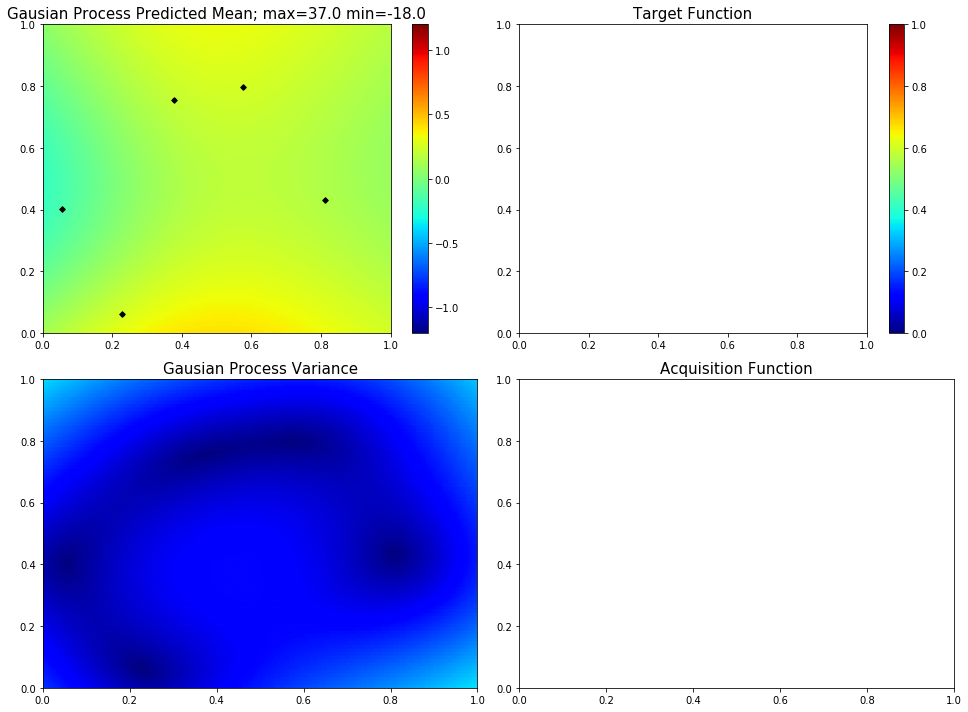

In [53]:
bo = BayesianOptimization(target, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 10

bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa)

plot_2d()

In [54]:
from math import sqrt
def invRL(policy):
    old_policy = [0.0, 0.0]
    seq = [] # 0.0
    for year in range(5):
        trans_policy = policy[year]
        trans_policy[0] *= (1.0 - old_policy[0])
        trans_policy[1] *= (1.0 - old_policy[1])

        r_mu, r_sigma = bo._gp.predict([trans_policy], return_std=True)
        print("invRL y", year+1 , ": ",round(r_mu[0]*90.0)," +- ", round(sqrt(r_sigma[0]*90.0) ) ) # ben lezem +- el racine bte3ha
        old_policy = policy[year]
        seq.append(r_mu*90) 
    return seq, np.sum(seq)


def testHolePolicy(policy):
    global envSeqDec
    envSeqDec.reset()
    year=0
    tot=0.0
    seq=[]
    while True:
        action =  policy[year]
        nextstate, reward, done, _ = envSeqDec.evaluateAction(list(action))
        print("test y", year+1 , ": ",round(reward))
        seq.append(reward)
        tot += reward
        if done:
            break
        year+=1
    return seq,tot

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
100  Evaluations Remaining
|  6        |  0.9794   |  0.0      |  1.0      |
myplot:  006


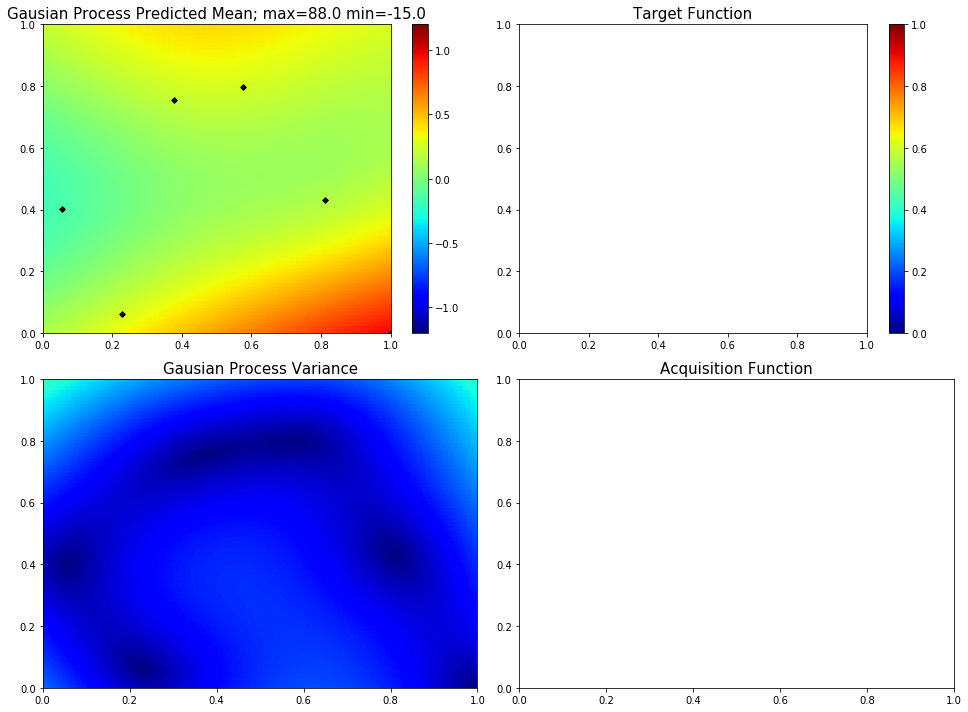

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
99  Evaluations Remaining
|  7        |  0.2703   |  1.0      |  0.0      |
myplot:  007


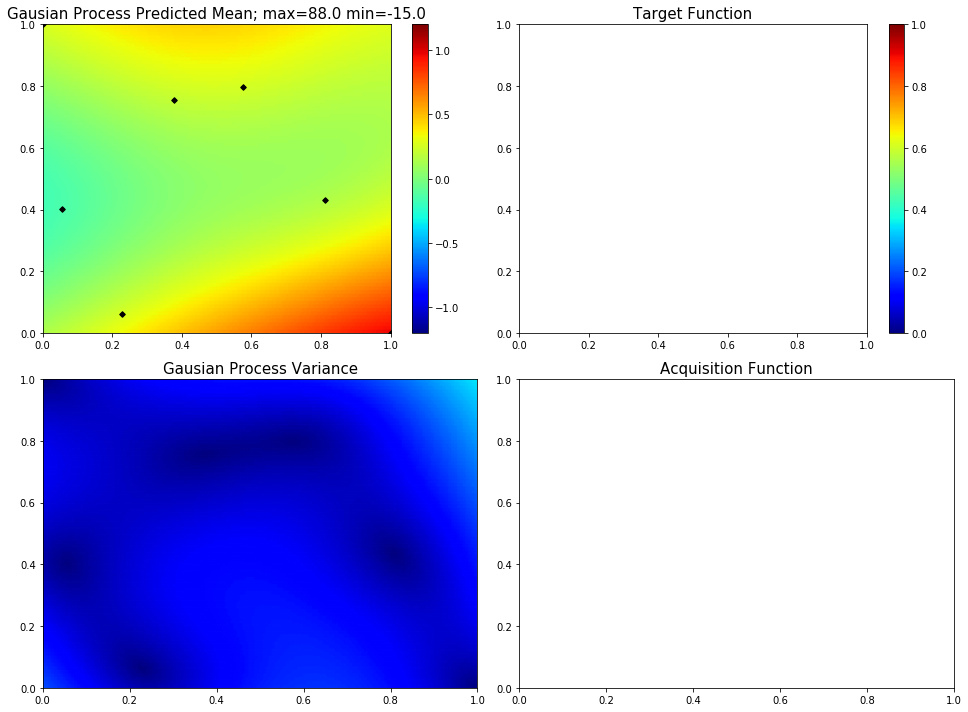

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
98  Evaluations Remaining
|  8        | -0.01627  |  1.0      |  1.0      |
myplot:  008


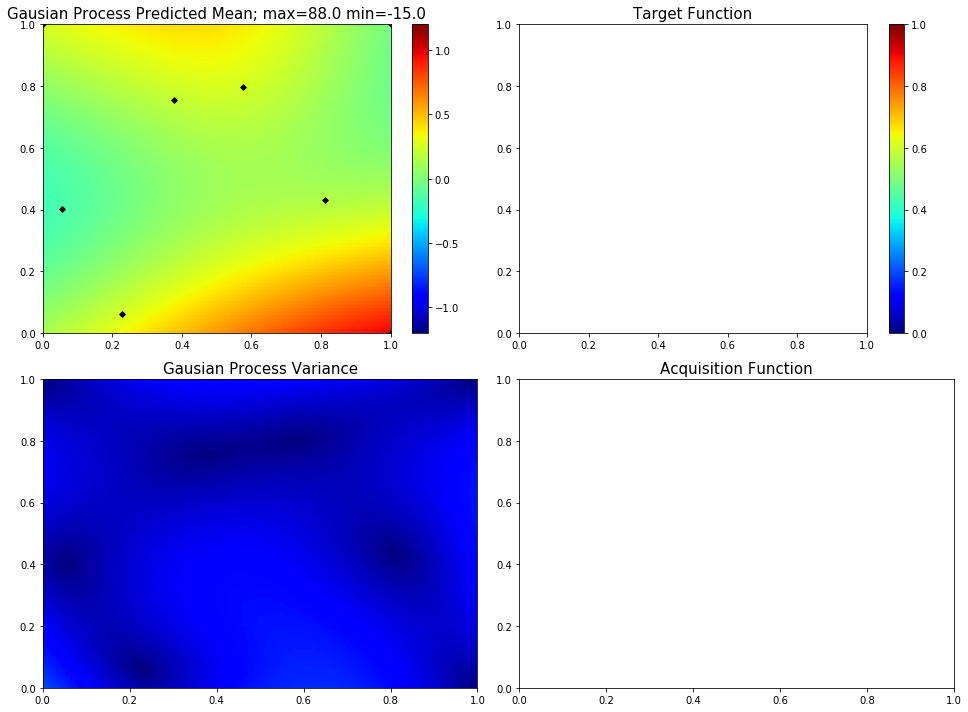

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.6622039104746805]
97  Evaluations Remaining
|  9        | -0.5548   |  0.0      |  0.6622   |
myplot:  009


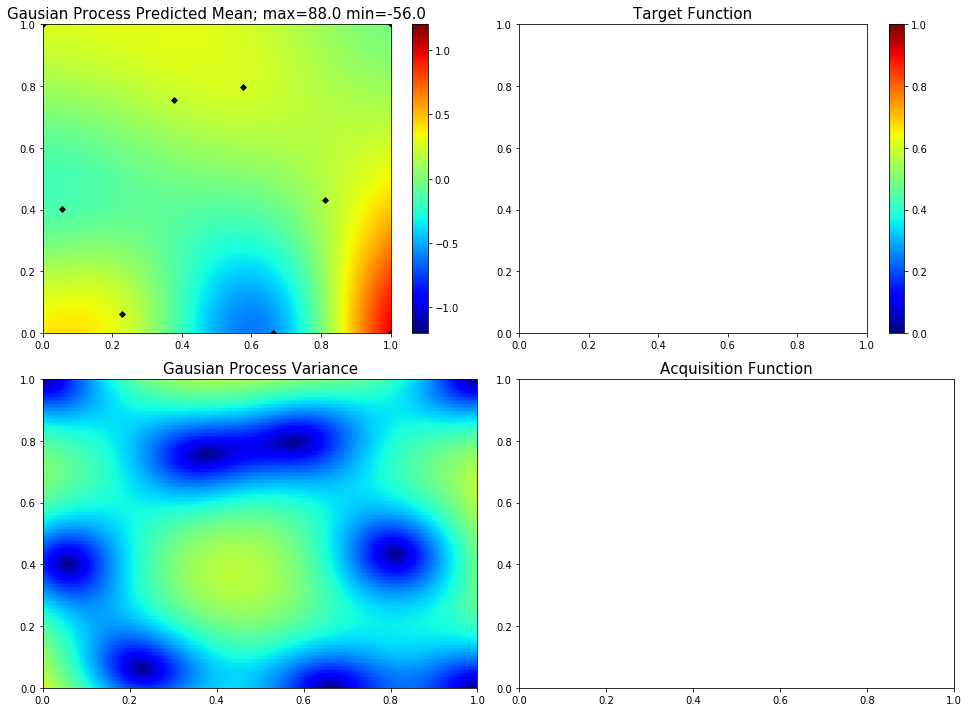

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
96  Evaluations Remaining
|  10       |  0.5921   |  0.0      |  0.0      |
myplot:  010


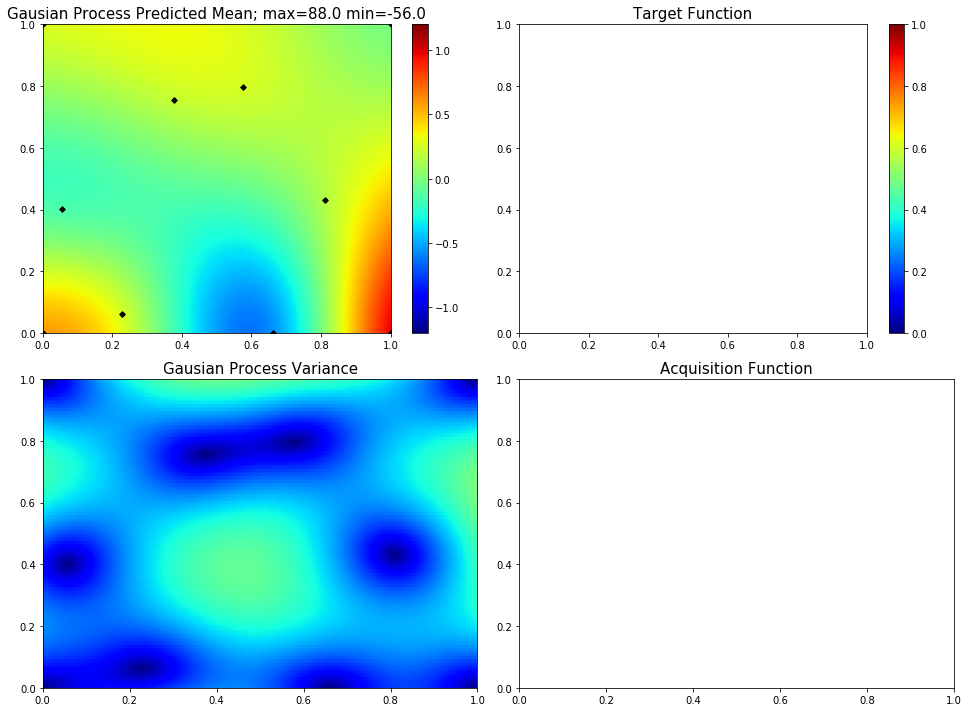

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.638612208560957, 1.0]
95  Evaluations Remaining
|  11       |  0.2464   |  0.6386   |  1.0      |
myplot:  011


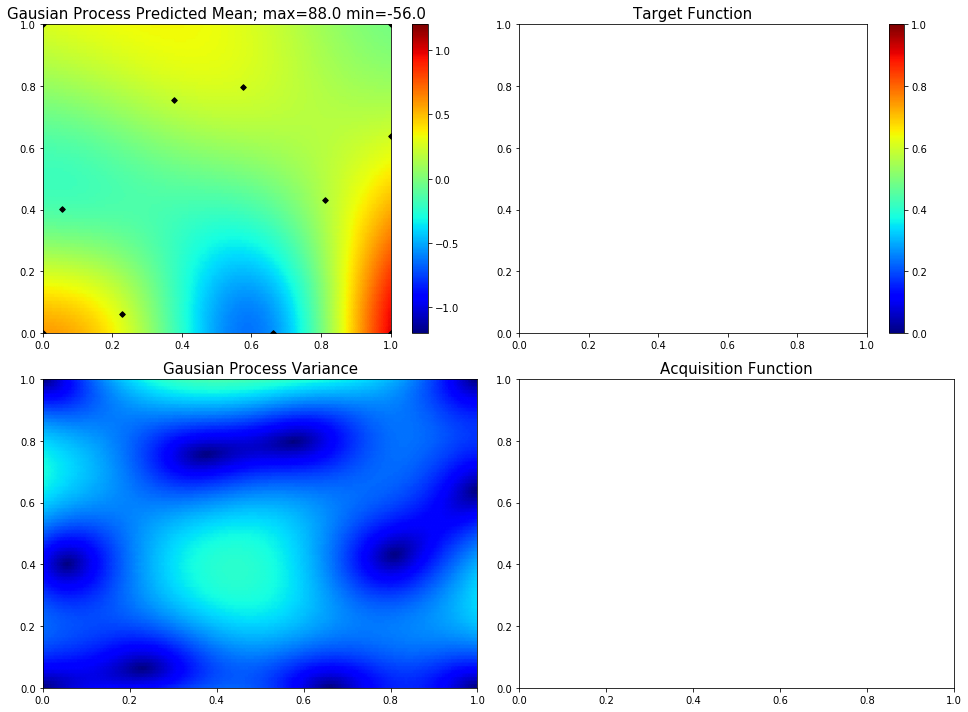

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.4066649733290142]
94  Evaluations Remaining
|  12       |  0.03483  |  1.0      |  0.4067   |
myplot:  012


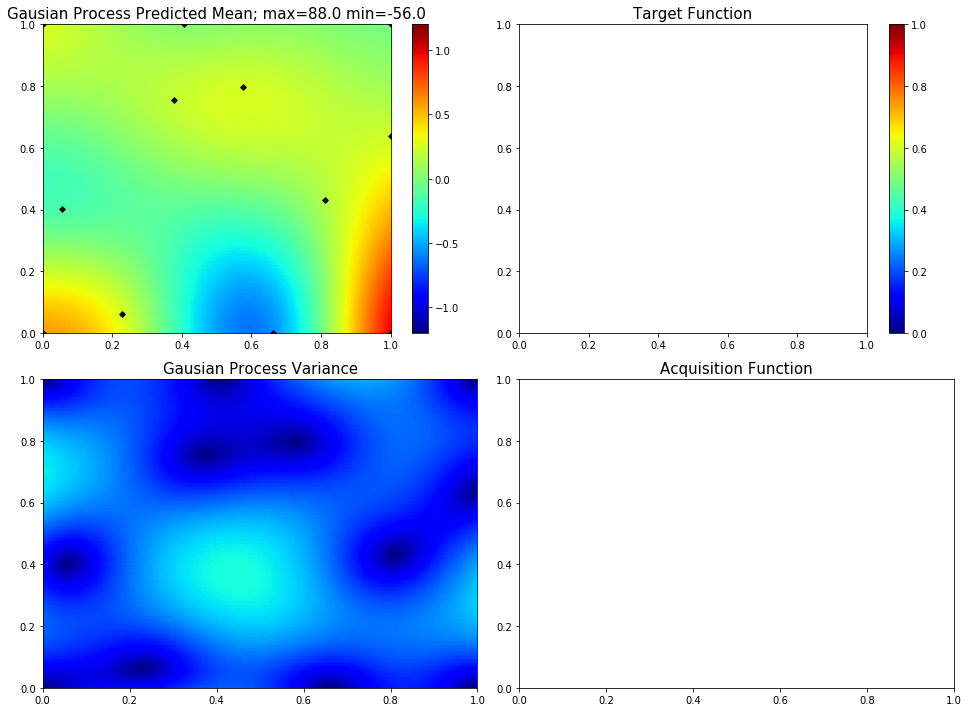

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2634959251522792, 1.0]
93  Evaluations Remaining
|  13       |  2.369    |  0.2635   |  1.0      |
myplot:  013


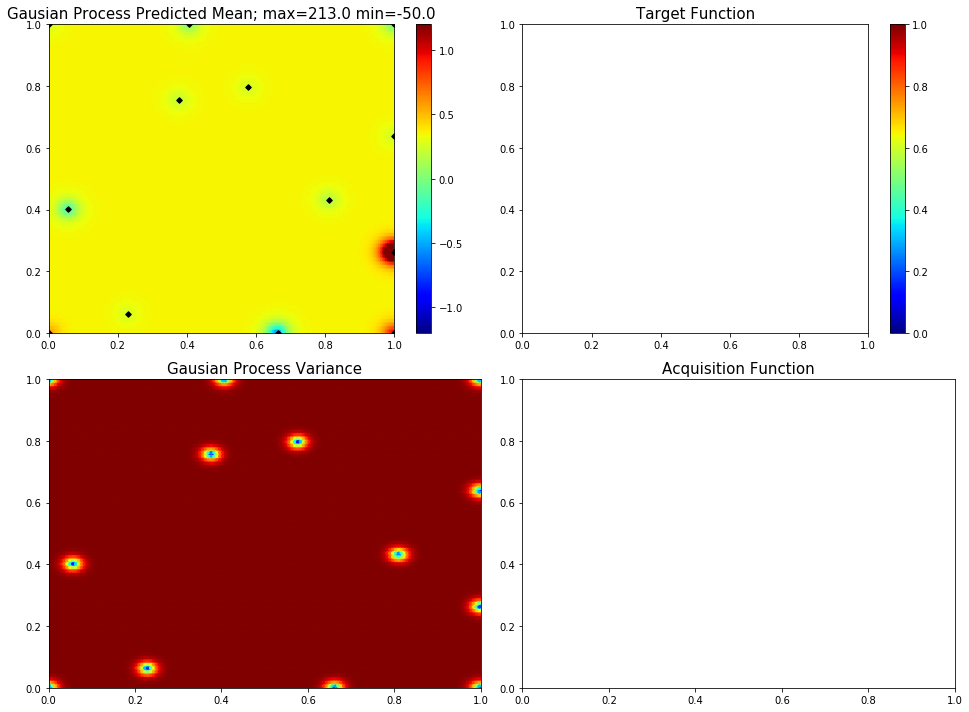

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.38242929257256203, 0.43805619019333364]
92  Evaluations Remaining
|  14       | -0.9232   |  0.3824   |  0.4381   |
myplot:  014


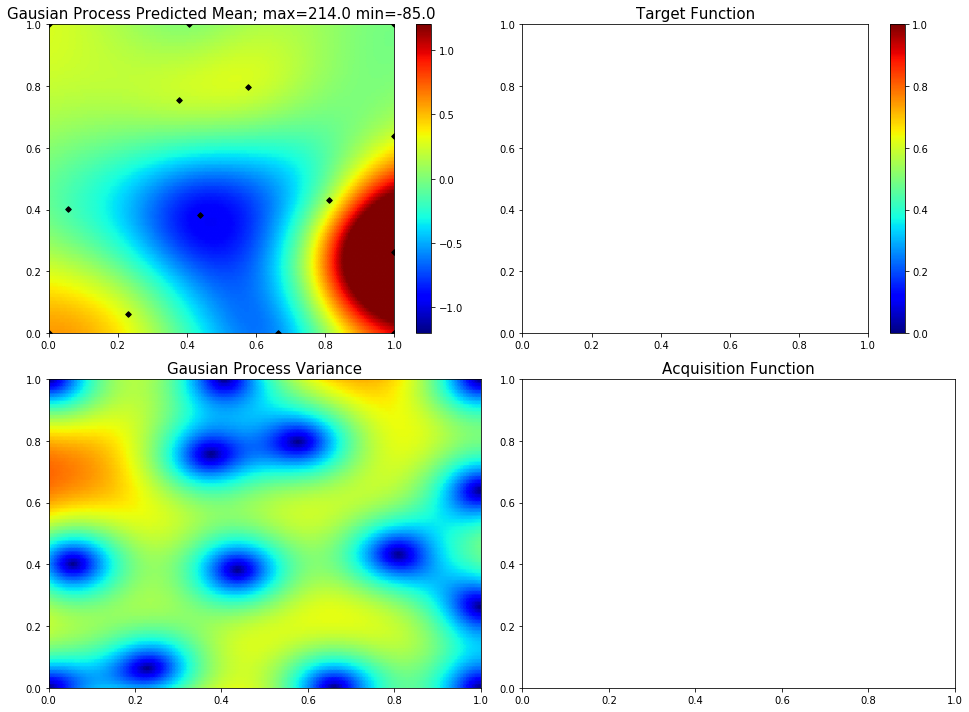

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7025945371073987, 0.0]
91  Evaluations Remaining
|  15       | -0.1655   |  0.7026   |  0.0      |
myplot:  015


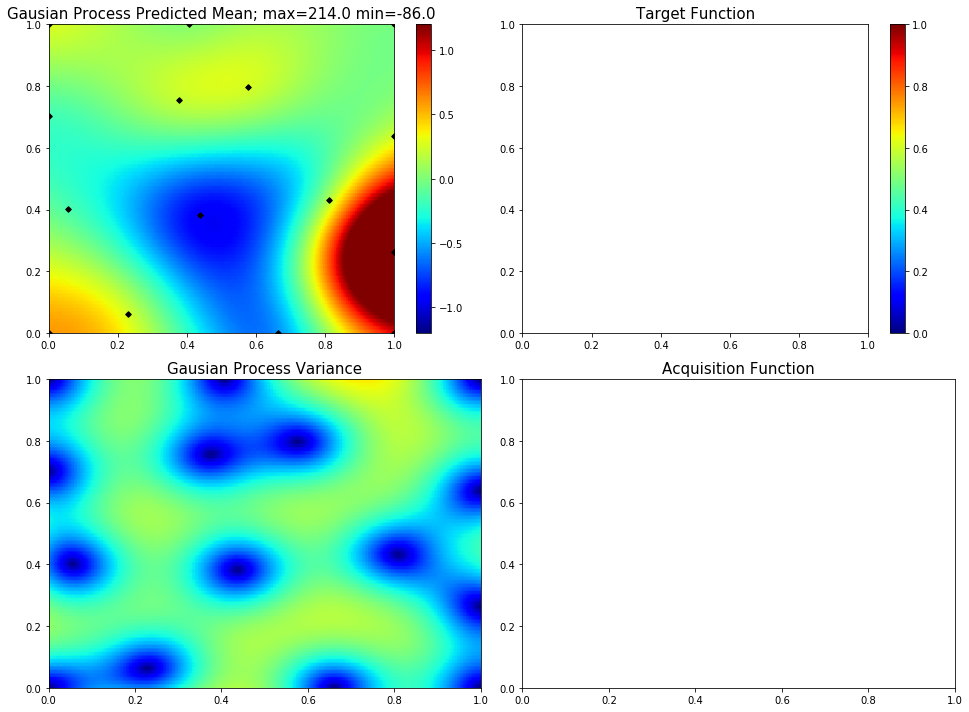

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.7282603830895023]
90  Evaluations Remaining
|  16       |  0.2652   |  1.0      |  0.7283   |
myplot:  016


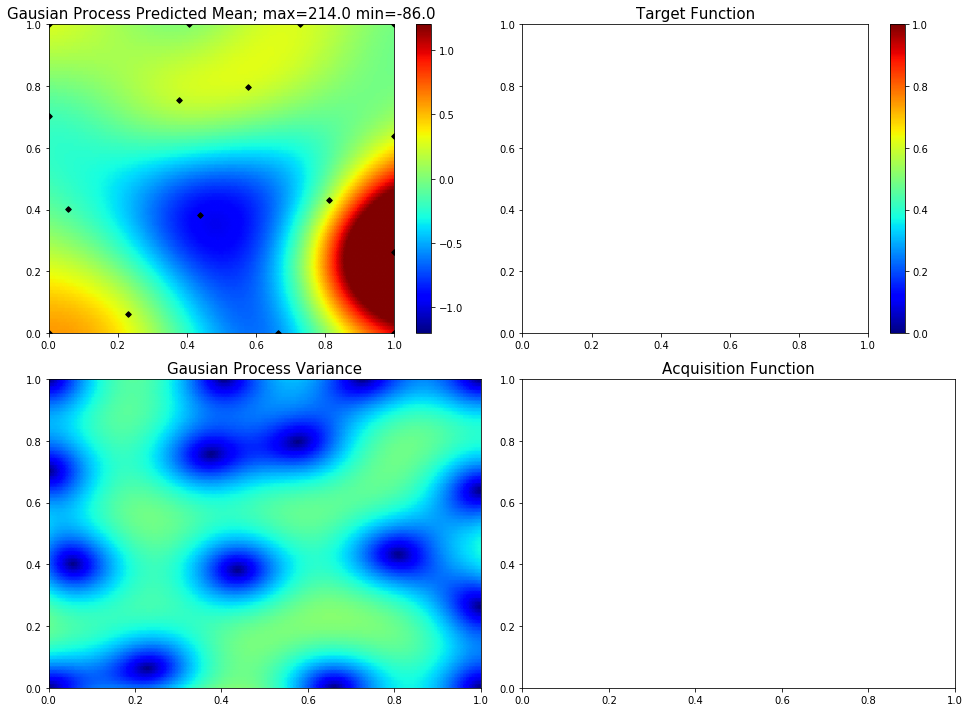

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.18020778016086855, 0.8411979957413431]
89  Evaluations Remaining
|  17       |  0.3478   |  0.1802   |  0.8412   |
myplot:  017


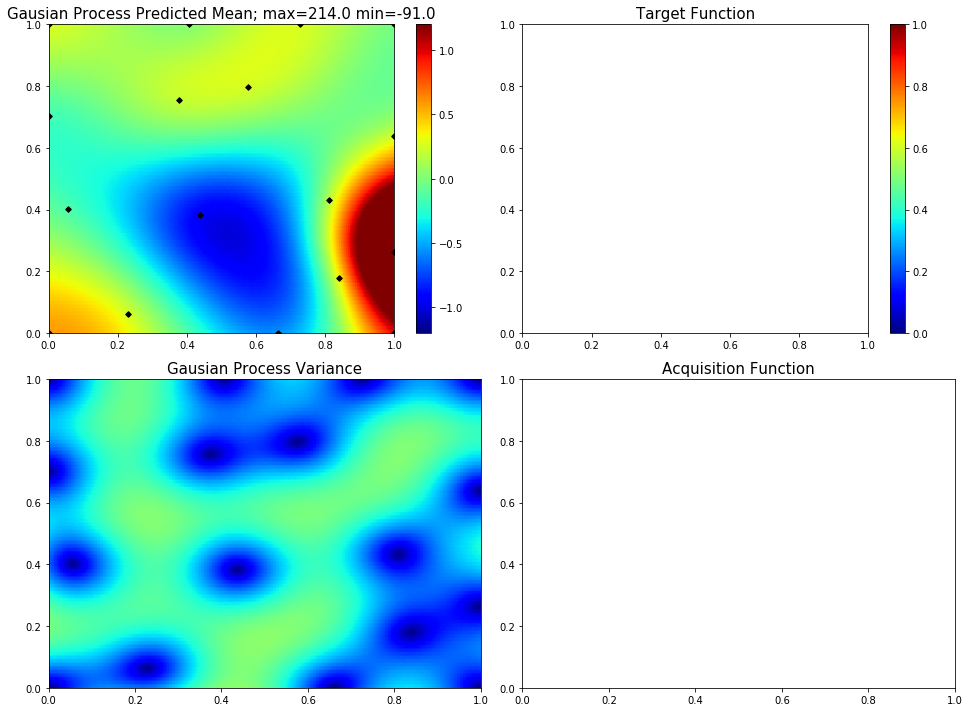

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.42462131668392306, 1.0]
88  Evaluations Remaining
|  18       |  0.6259   |  0.4246   |  1.0      |
myplot:  018


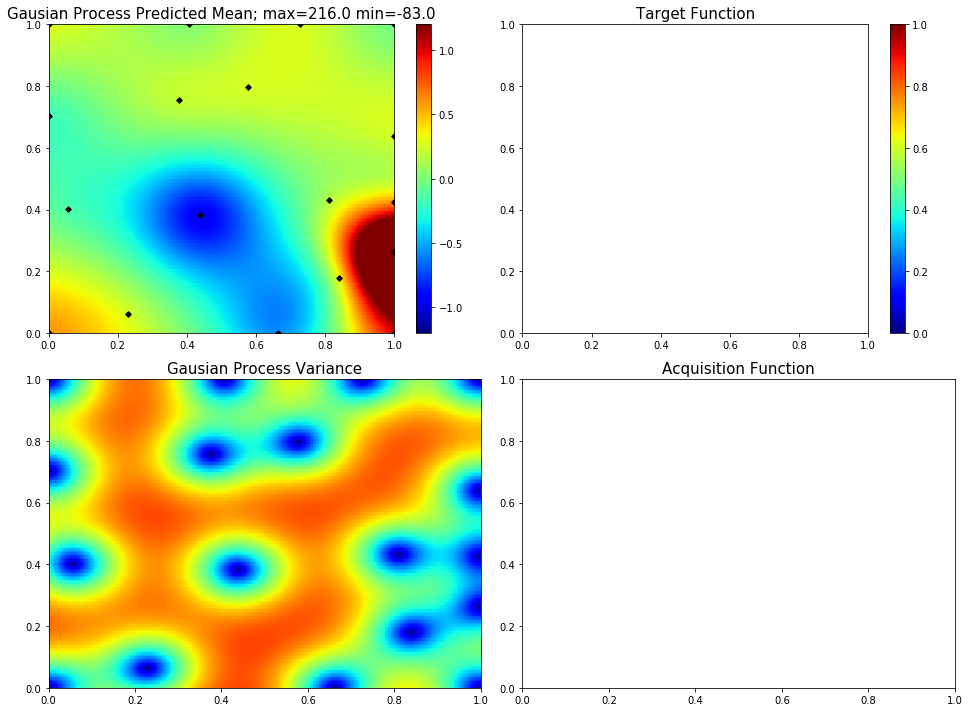

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7506463949531462, 0.80545396097836]
87  Evaluations Remaining
|  19       | -0.0625   |  0.7506   |  0.8055   |
myplot:  019


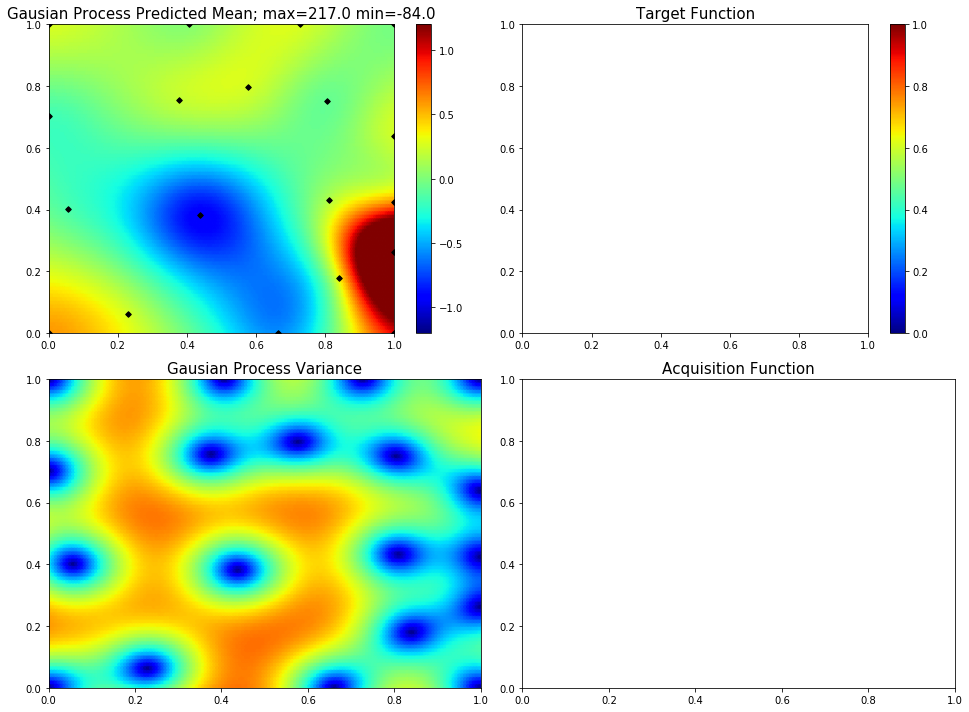

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.4303034779313186]
86  Evaluations Remaining
|  20       |  0.05348  |  0.0      |  0.4303   |
myplot:  020


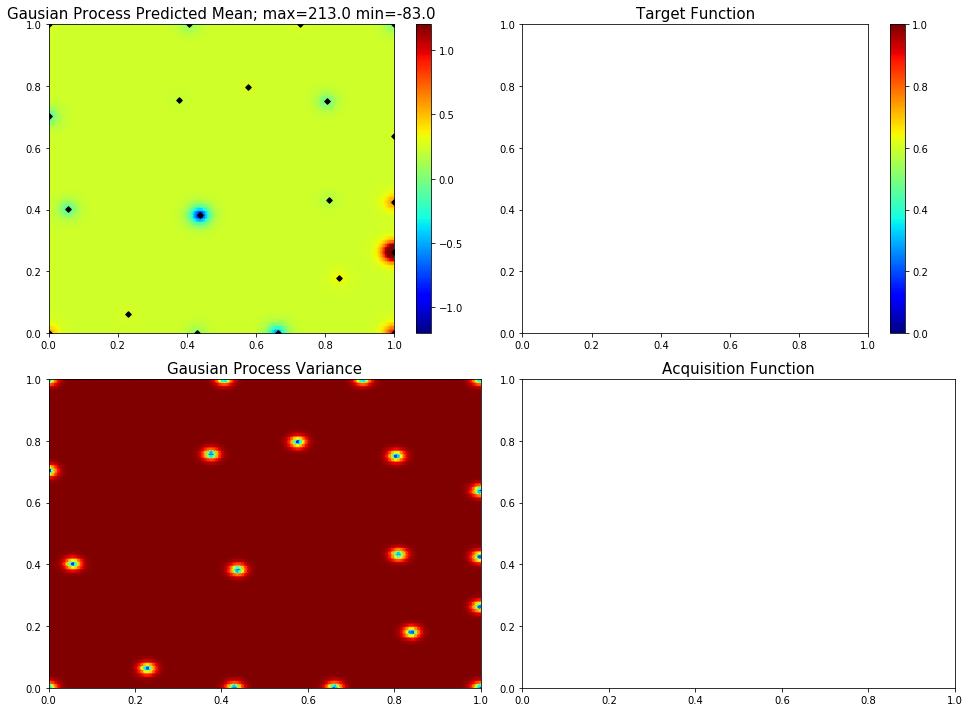

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2010190094442377, 0.0]
85  Evaluations Remaining
|  21       |  0.2689   |  0.201    |  0.0      |
myplot:  021


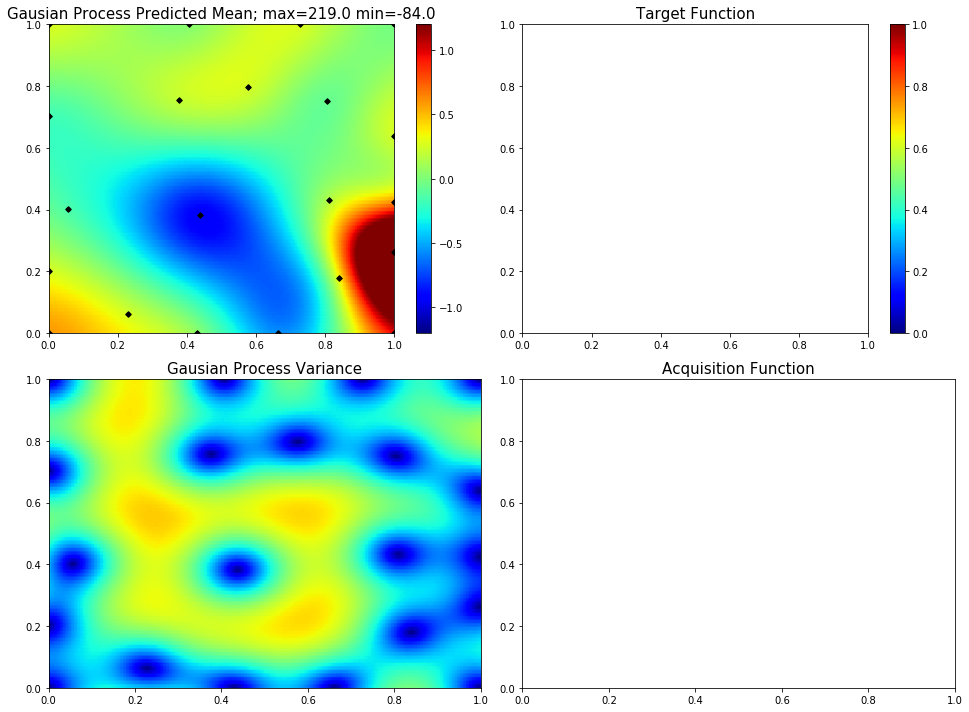

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8972765475158586, 0.1874028745598365]
84  Evaluations Remaining
|  22       |  0.1463   |  0.8973   |  0.1874   |
myplot:  022


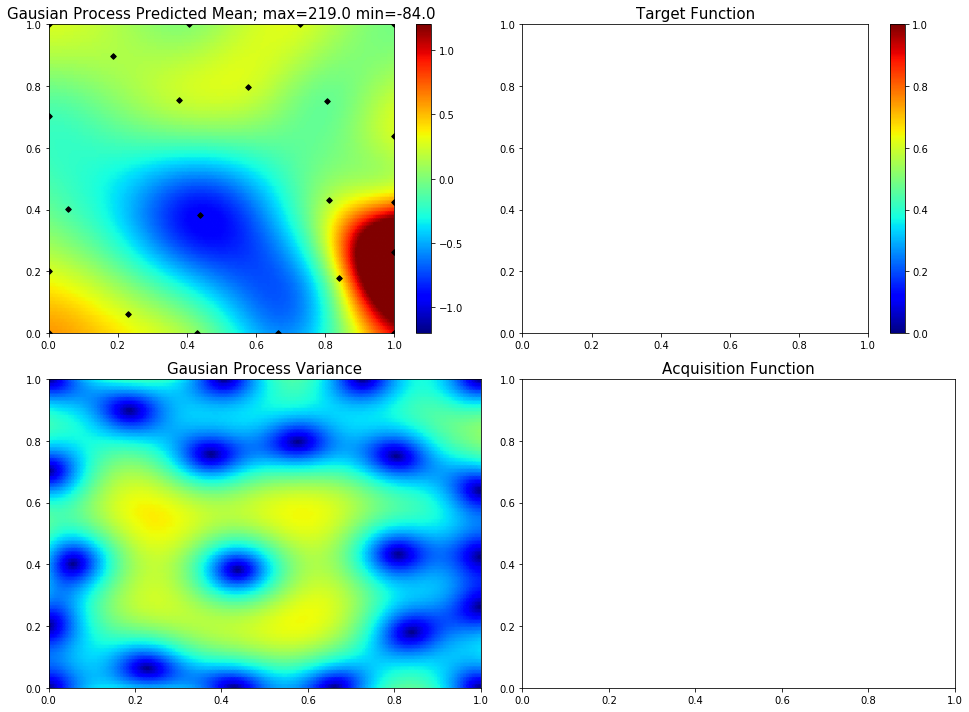

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5698275592347973, 0.23454752574553597]
83  Evaluations Remaining
|  23       | -0.1614   |  0.5698   |  0.2345   |
myplot:  023


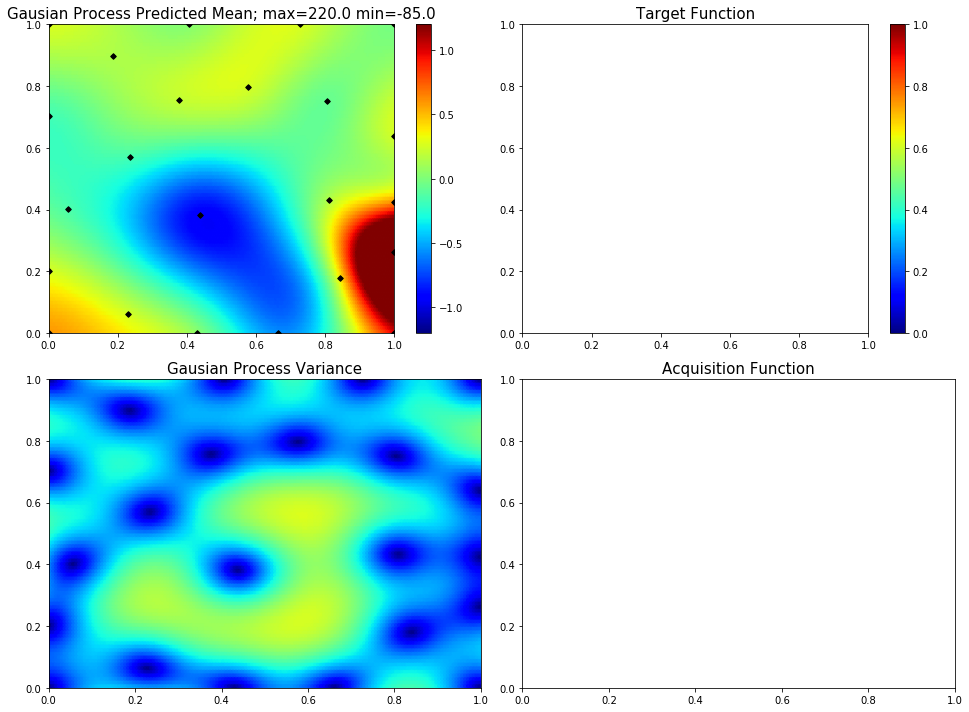

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5738081610155271, 0.5939669422504804]
82  Evaluations Remaining
|  24       | -0.1083   |  0.5738   |  0.594    |
myplot:  024


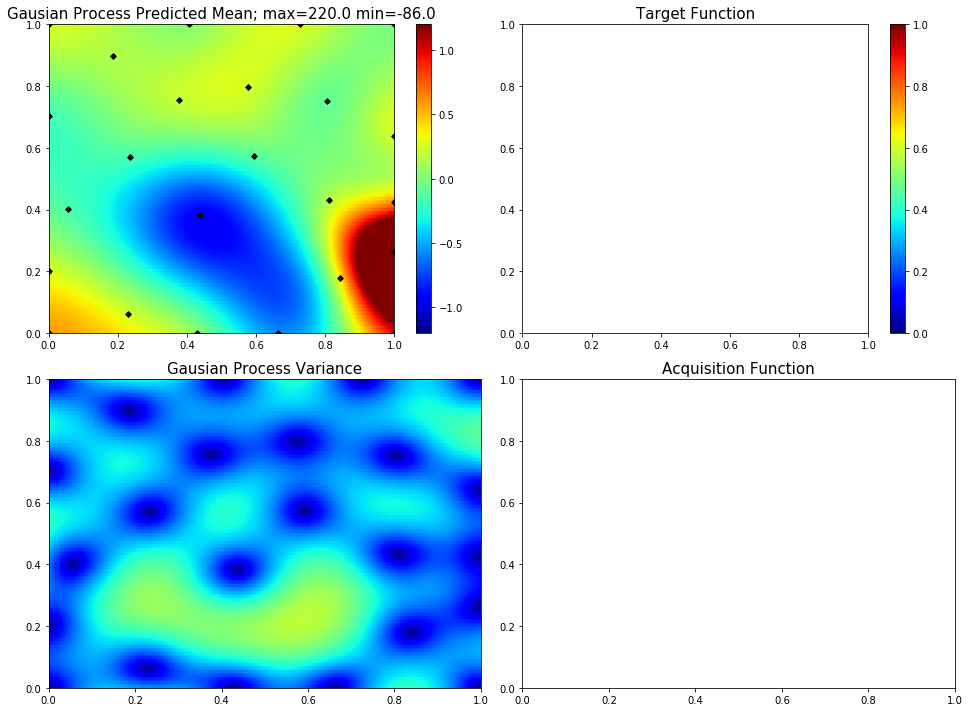

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2191244421773145, 0.5933573251218922]
81  Evaluations Remaining
|  25       | -0.2417   |  0.2191   |  0.5934   |
myplot:  025


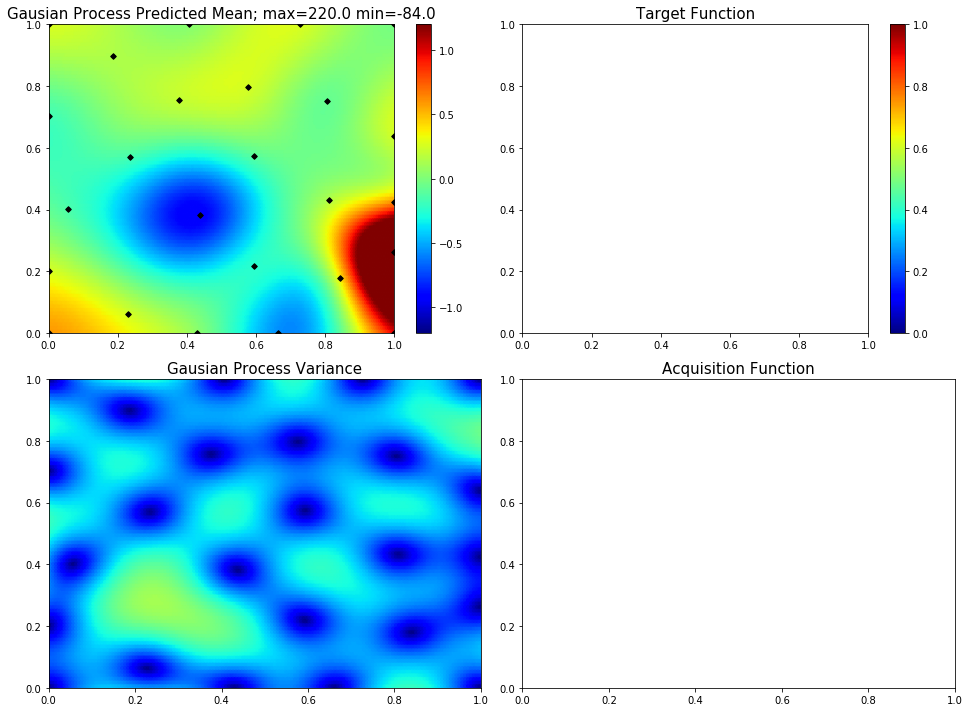

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.26798570944057937, 0.23238530870320975]
80  Evaluations Remaining
|  26       |  0.02036  |  0.268    |  0.2324   |
myplot:  026


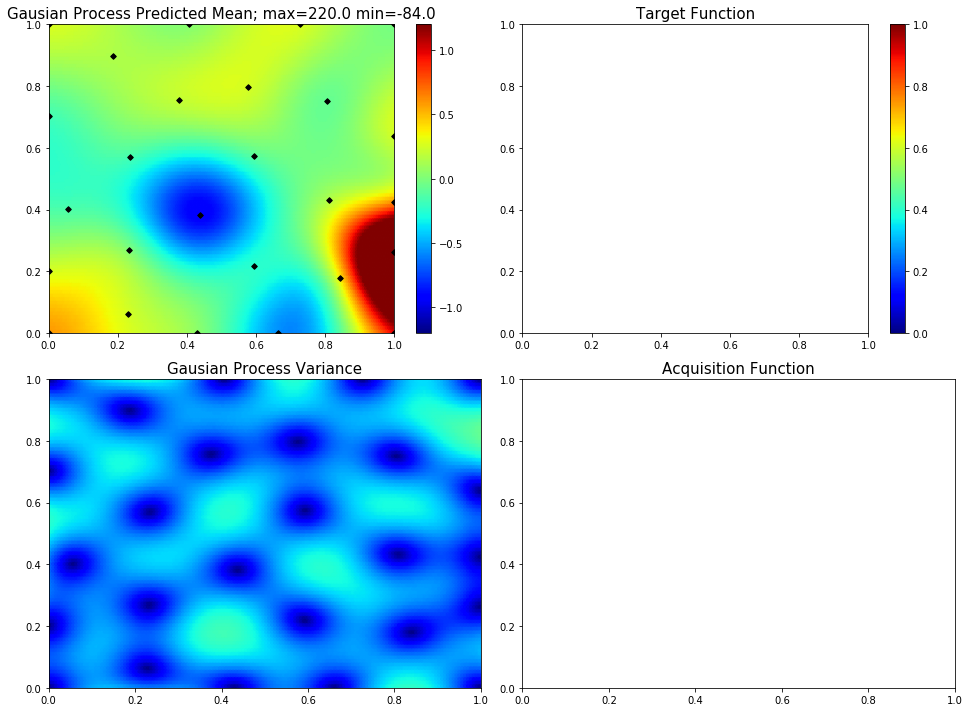

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14291777820878676, 1.0]
79  Evaluations Remaining
|  27       |  3.238    |  0.1429   |  1.0      |
myplot:  027


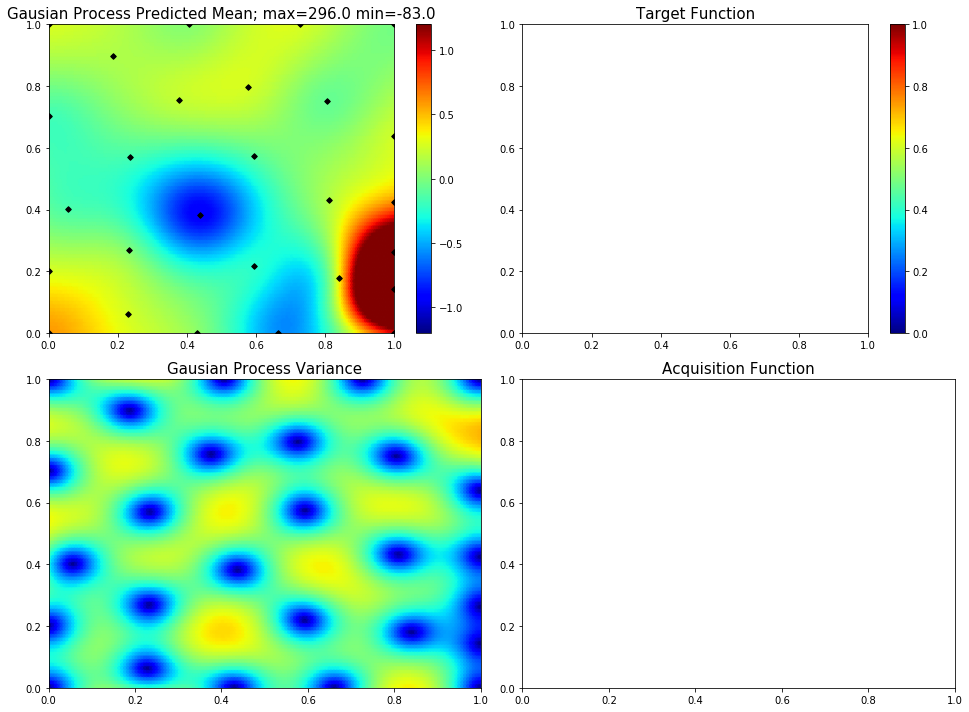

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8214849044190105, 1.0]
78  Evaluations Remaining
|  28       |  0.1436   |  0.8215   |  1.0      |
myplot:  028


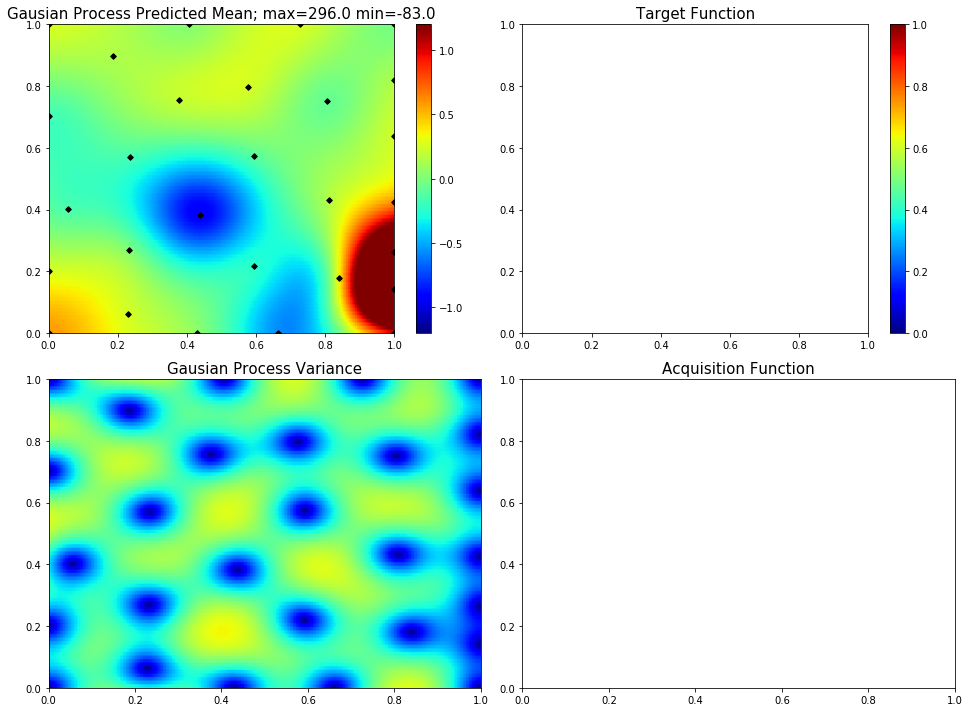

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.5696104765785608]
77  Evaluations Remaining
|  29       |  0.01557  |  1.0      |  0.5696   |
myplot:  029


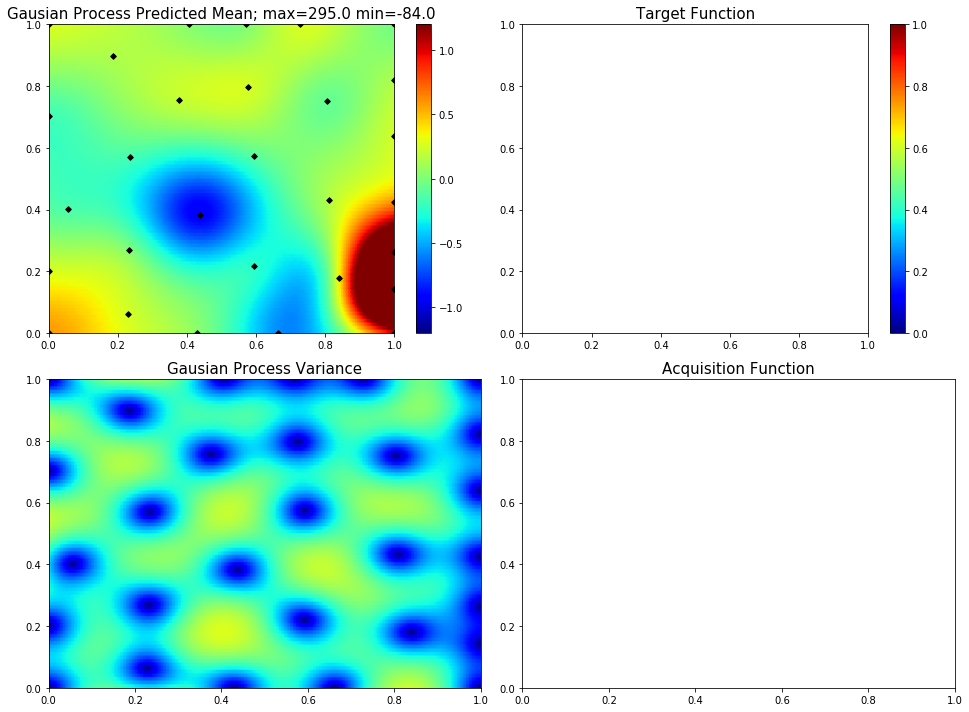

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1586733994423988, 0.9999999995876873]
76  Evaluations Remaining
|  30       |  3.187    |  0.1587   |  1.0      |
myplot:  030


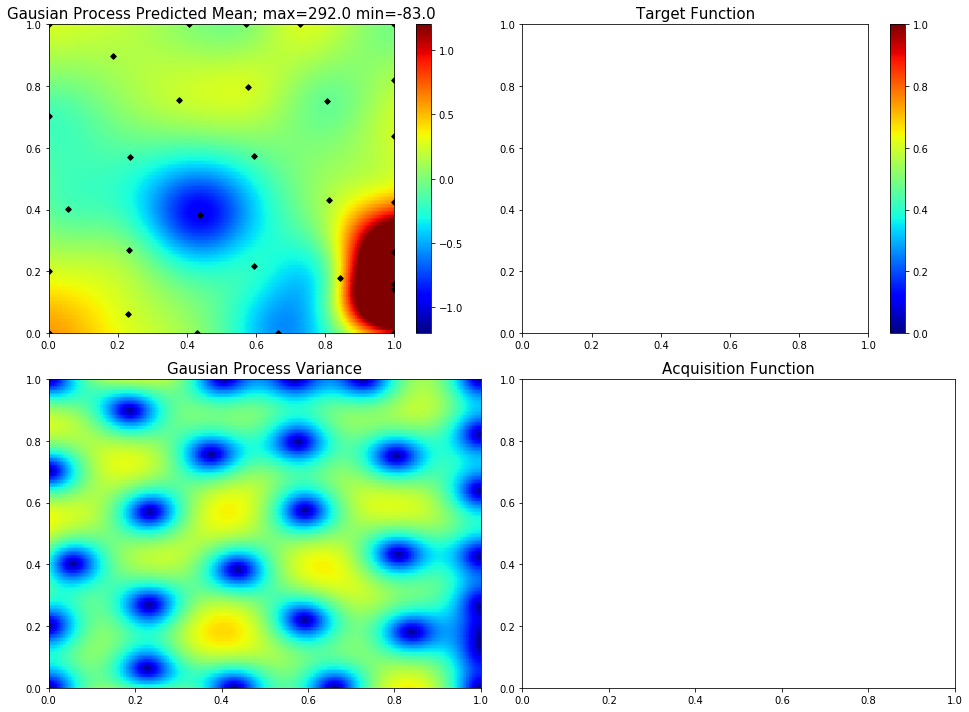

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.17472801499458782, 0.399280205759954]
75  Evaluations Remaining
|  31       |  0.000930 |  0.1747   |  0.3993   |
myplot:  031


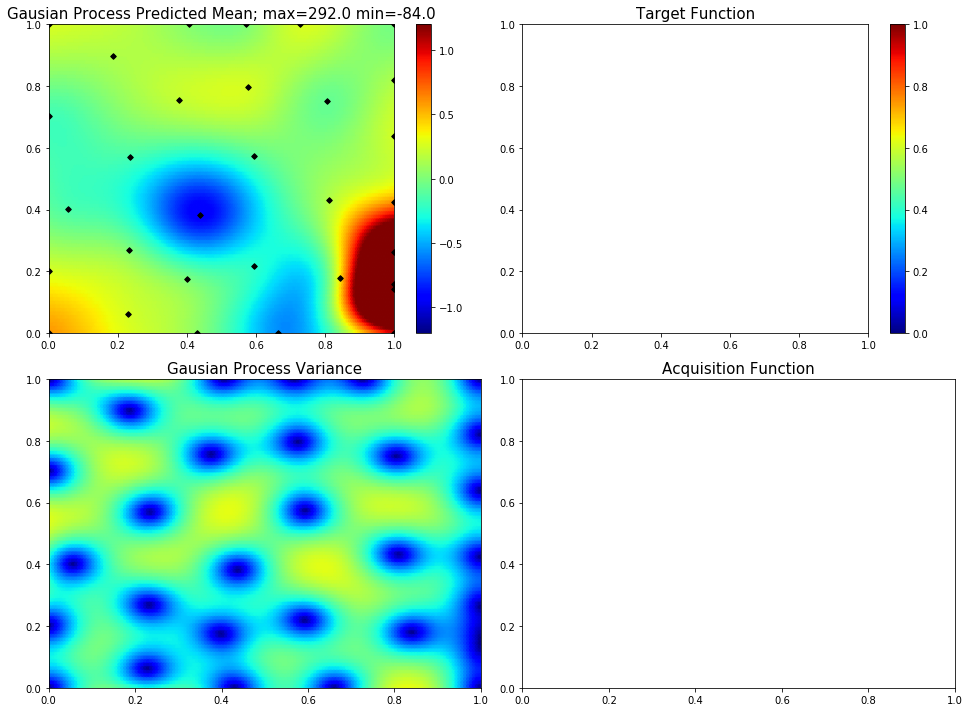

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8481230874441409]
74  Evaluations Remaining
|  32       | -0.2385   |  0.0      |  0.8481   |
myplot:  032


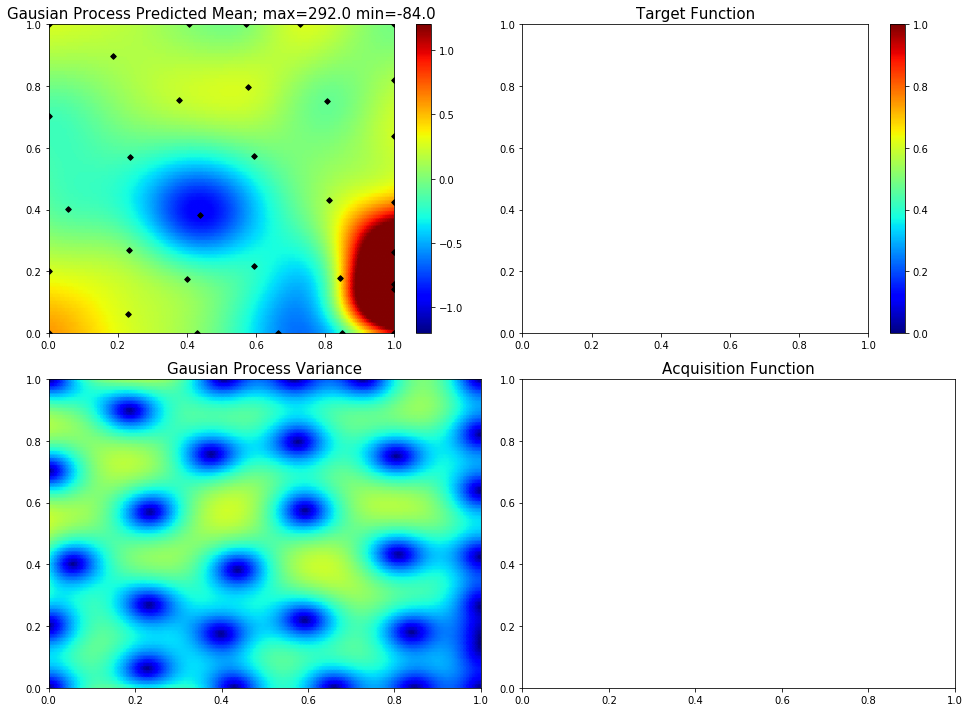

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5432196706967621, 0.0]
73  Evaluations Remaining
|  33       | -0.0964   |  0.5432   |  0.0      |
myplot:  033


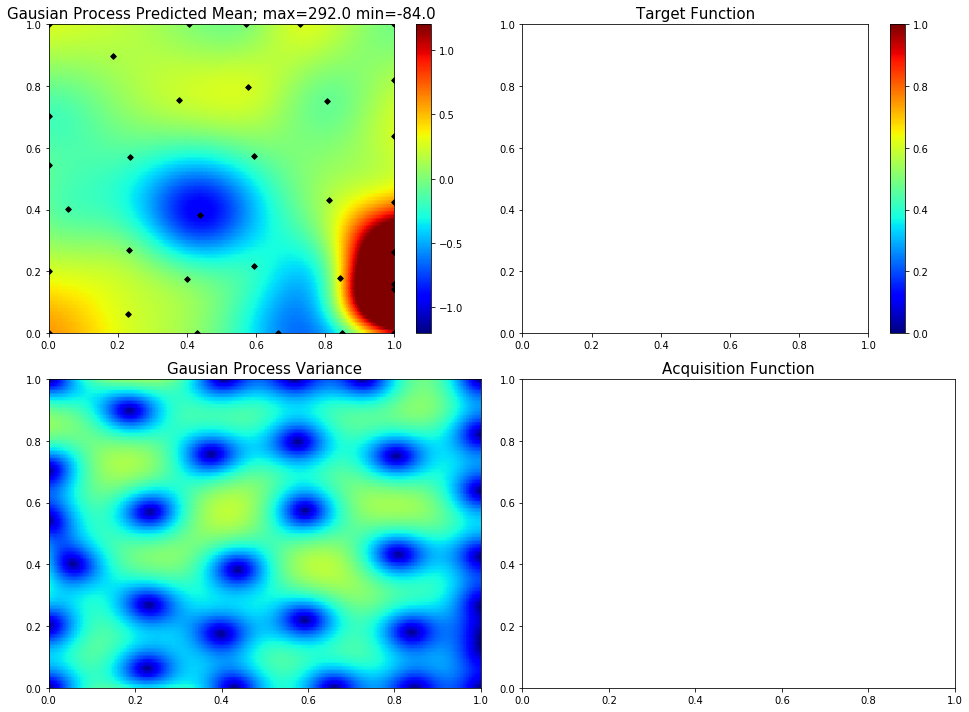

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7297225636681378, 0.17933626439970698]
72  Evaluations Remaining
|  34       | -0.07387  |  0.7297   |  0.1793   |
myplot:  034


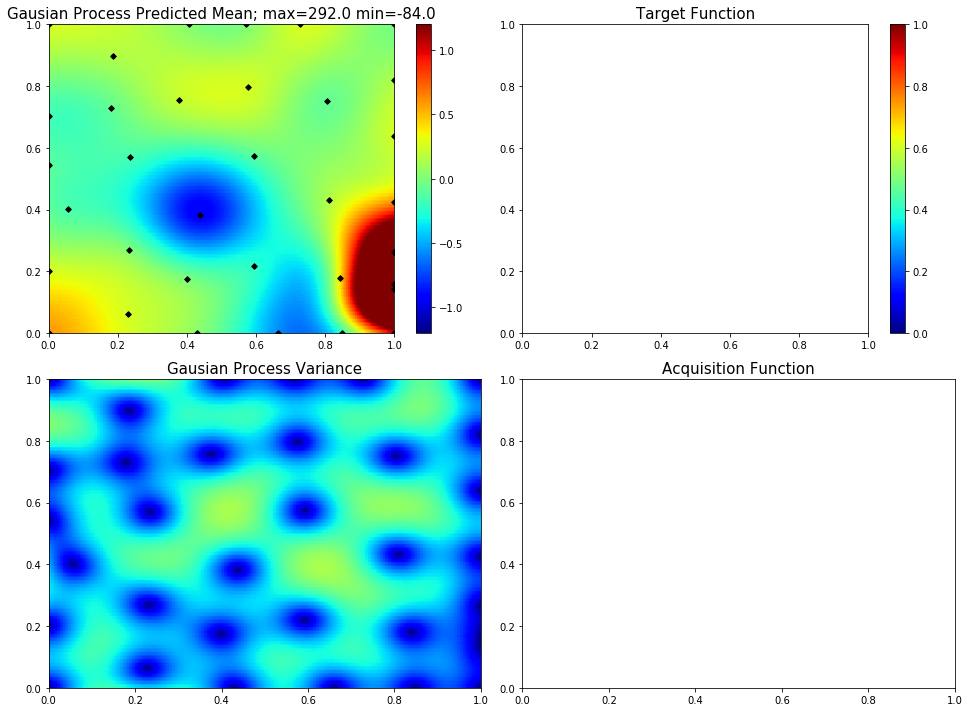

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5889867172337959, 0.7963331435897868]
71  Evaluations Remaining
|  35       |  0.1215   |  0.589    |  0.7963   |
myplot:  035


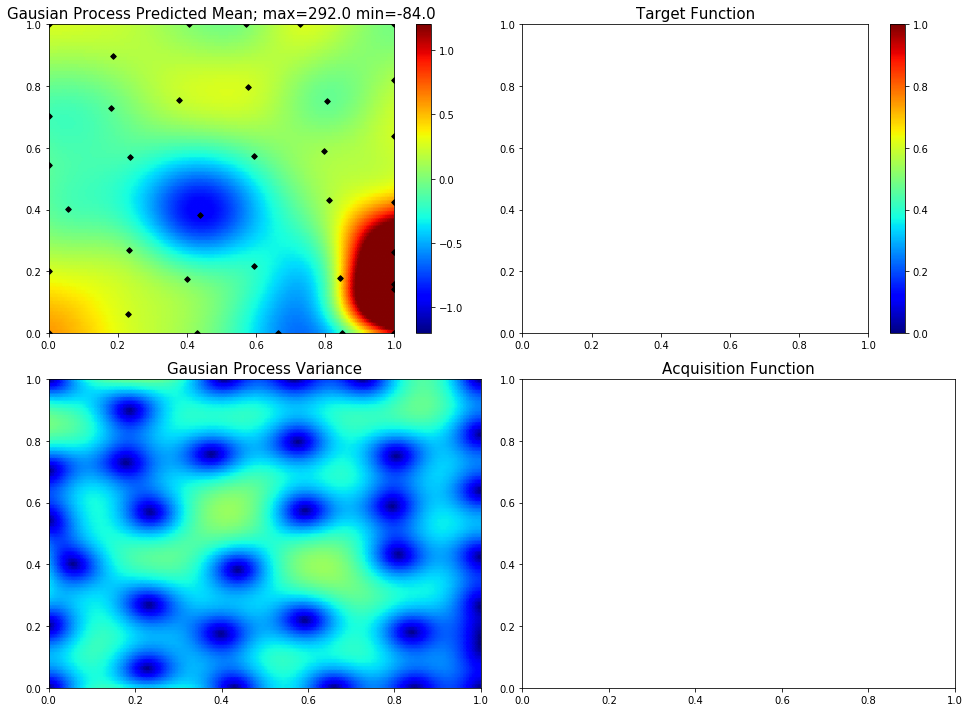

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5937418270938916, 0.4189357199196281]
70  Evaluations Remaining
|  36       | -0.6816   |  0.5937   |  0.4189   |
myplot:  036


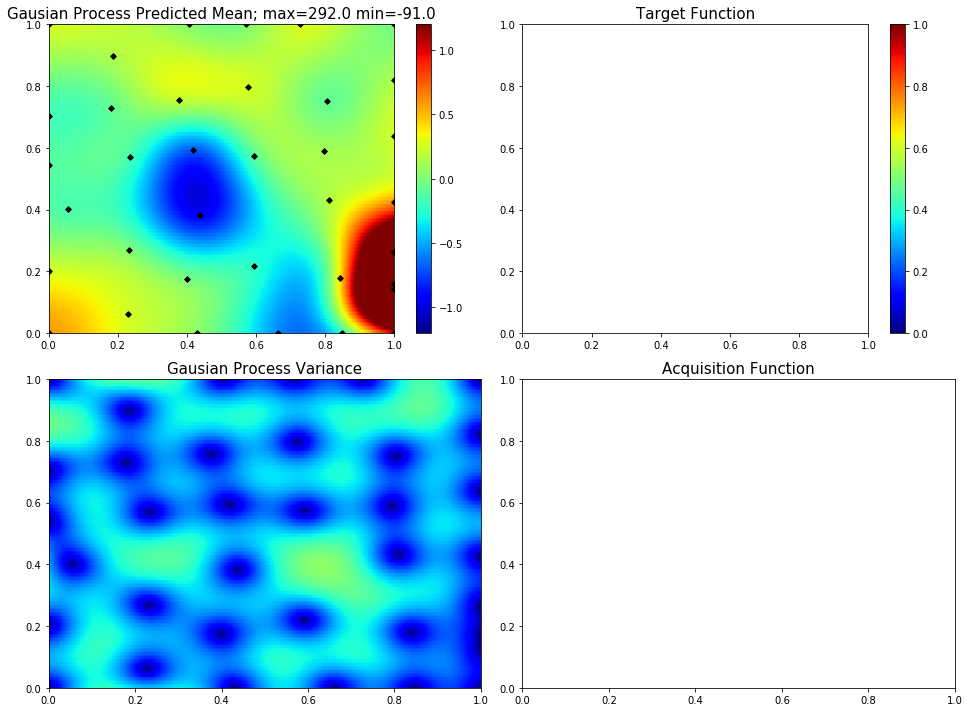

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.39313897255579294, 0.6462925977357159]
69  Evaluations Remaining
|  37       | -0.09756  |  0.3931   |  0.6463   |
myplot:  037


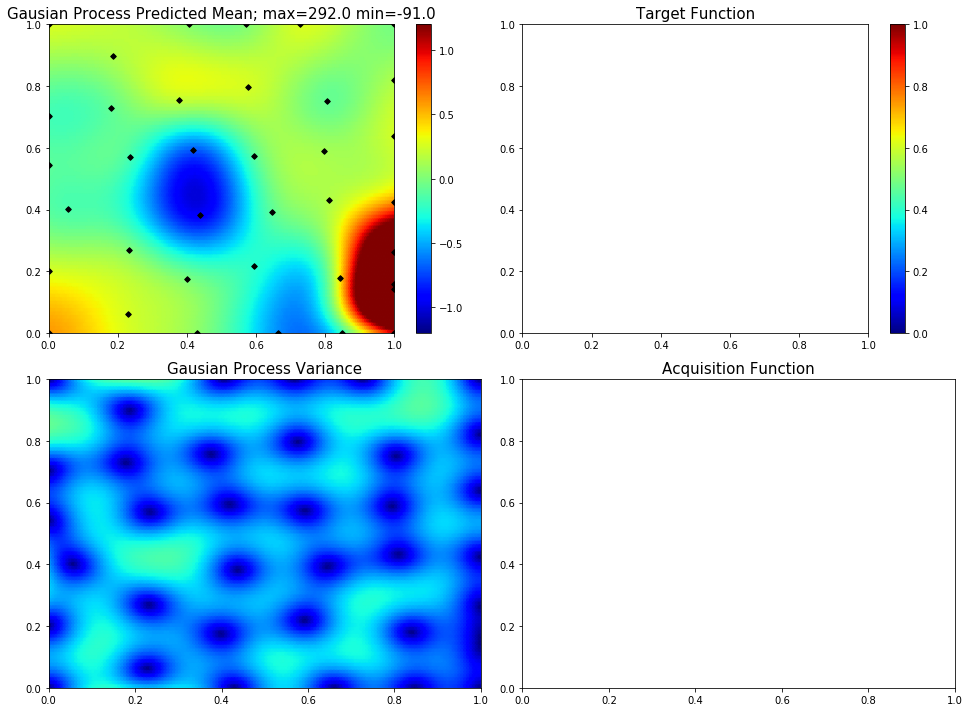

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.21943624542967693]
68  Evaluations Remaining
|  38       |  0.05706  |  1.0      |  0.2194   |
myplot:  038


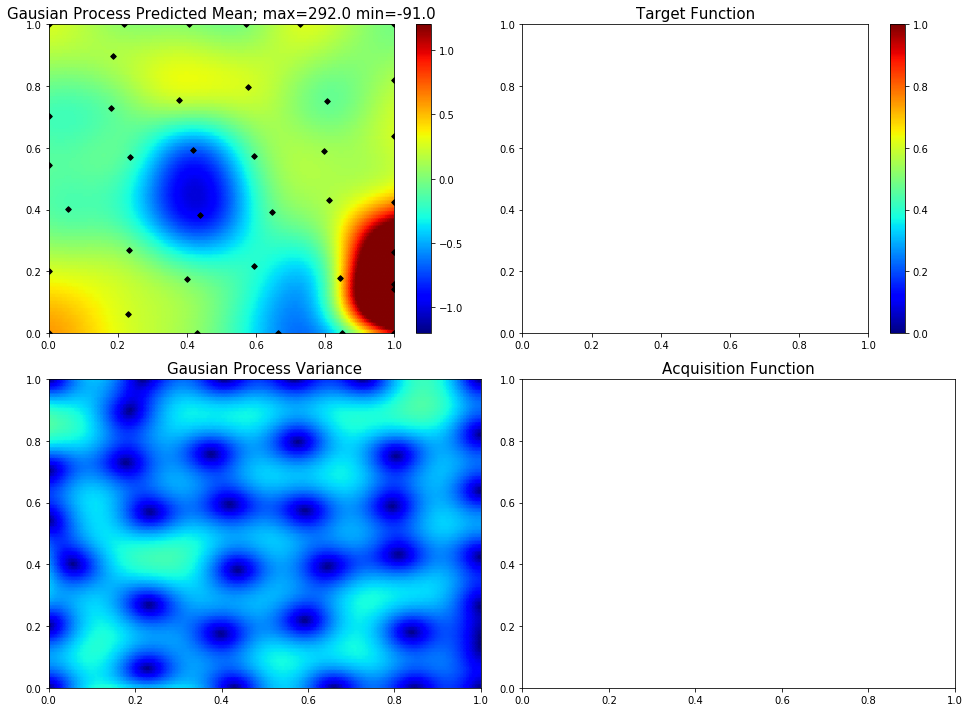

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8600460144853033, 0.0]
67  Evaluations Remaining
|  39       |  0.2064   |  0.86     |  0.0      |
myplot:  039


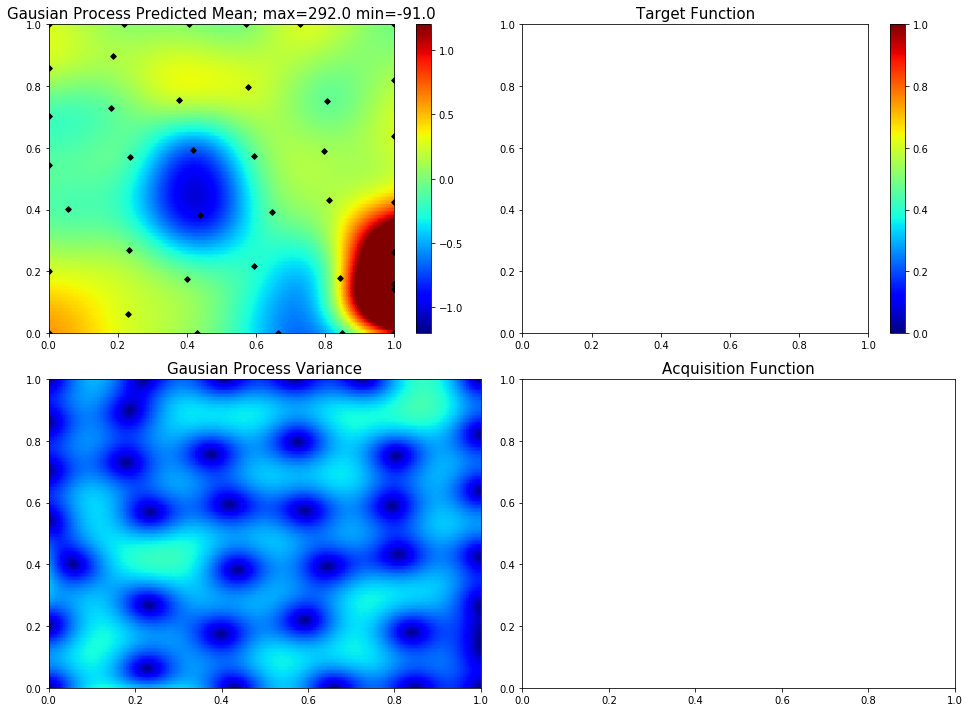

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9225520337129568, 0.862883361602616]
66  Evaluations Remaining
|  40       |  0.1565   |  0.9226   |  0.8629   |
myplot:  040


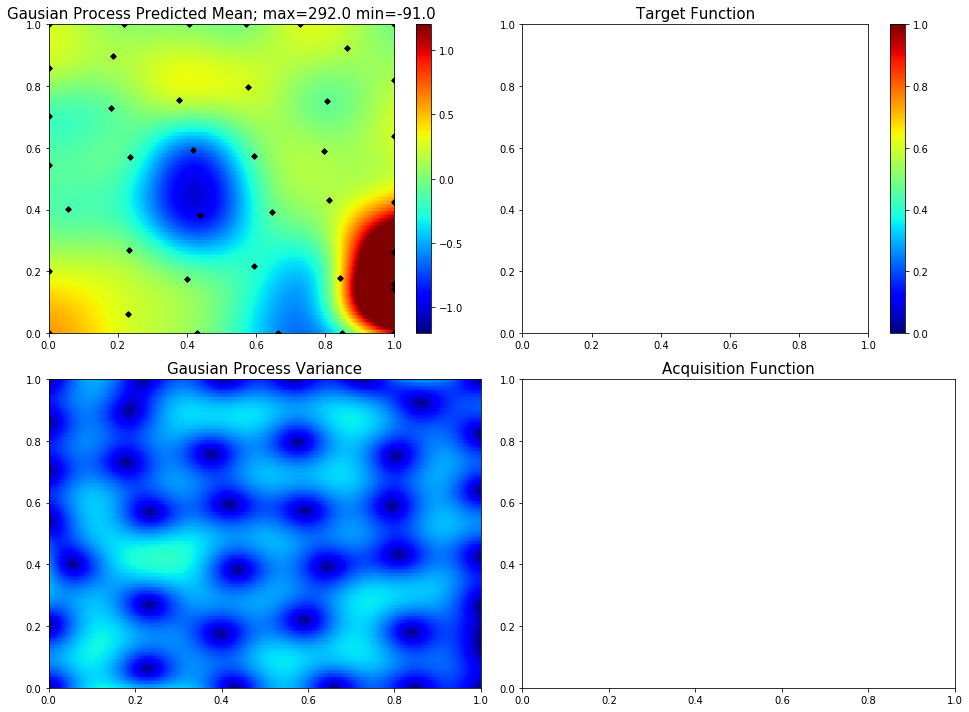

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1260378173714756, 0.9468501063961479]
65  Evaluations Remaining
|  41       |  3.228    |  0.126    |  0.9469   |
myplot:  041


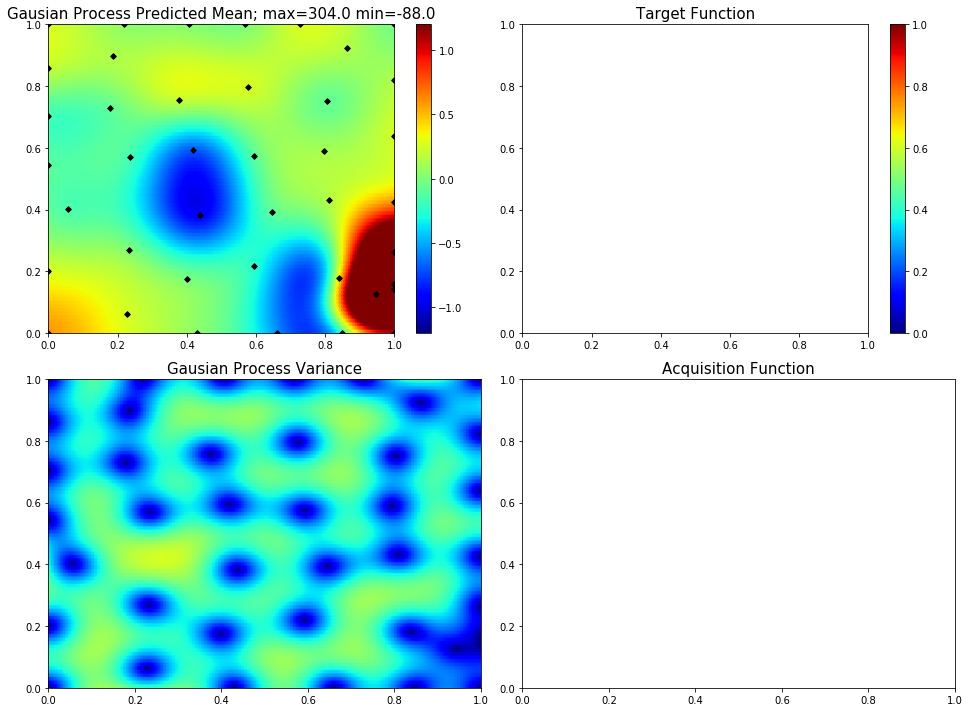

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.12576884886020157]
64  Evaluations Remaining
|  42       |  0.1089   |  0.0      |  0.1258   |
myplot:  042


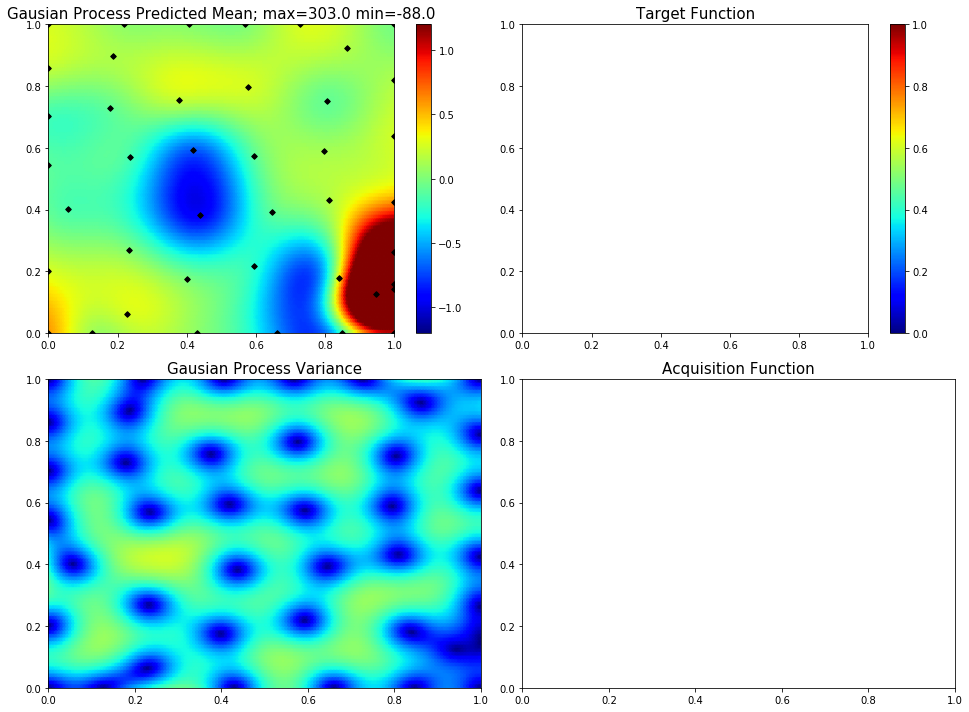

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.41863751296129, 0.24304628357403474]
63  Evaluations Remaining
|  43       |  0.03213  |  0.4186   |  0.243    |
myplot:  043


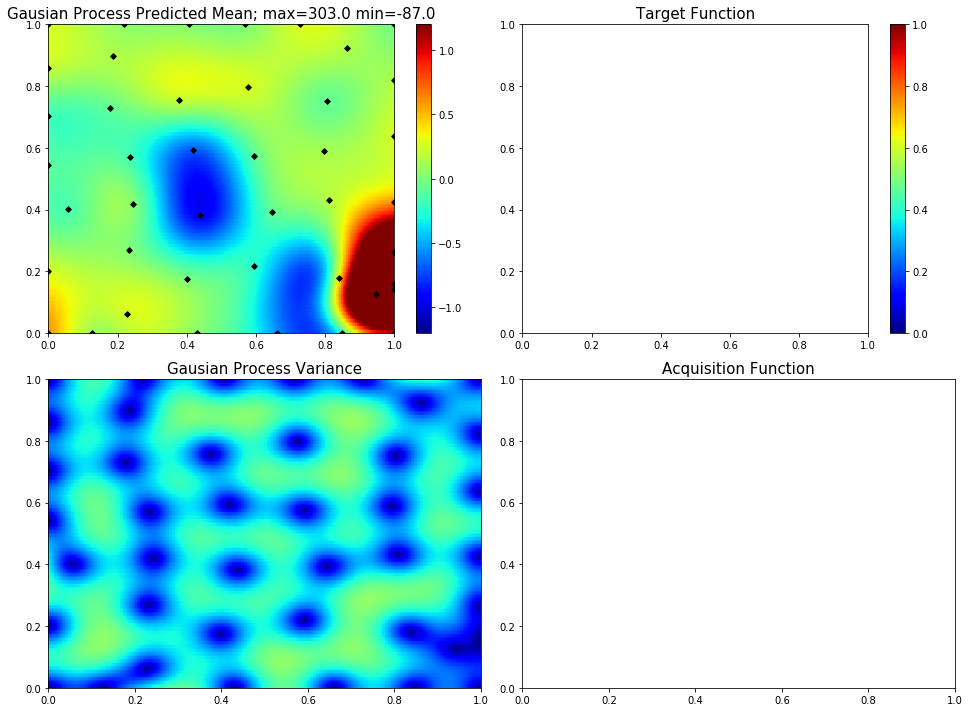

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3068320182870264, 0.9007675968984538]
62  Evaluations Remaining
|  44       |  2.363    |  0.3068   |  0.9008   |
myplot:  044


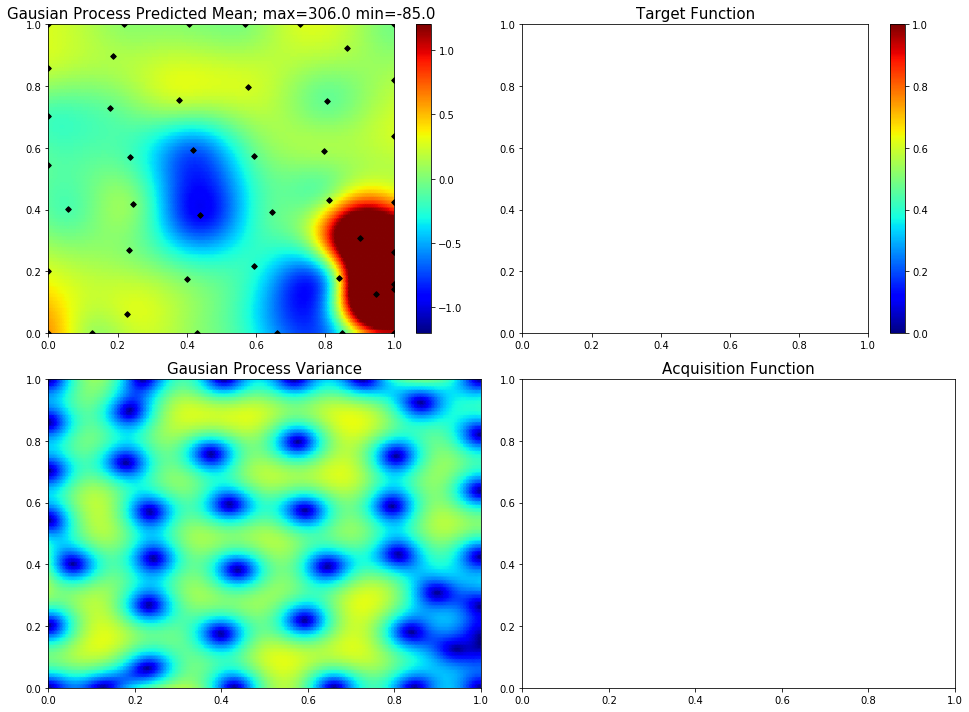

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8644549034459034, 0.7007752677489042]
61  Evaluations Remaining
|  45       |  0.2379   |  0.8645   |  0.7008   |
myplot:  045


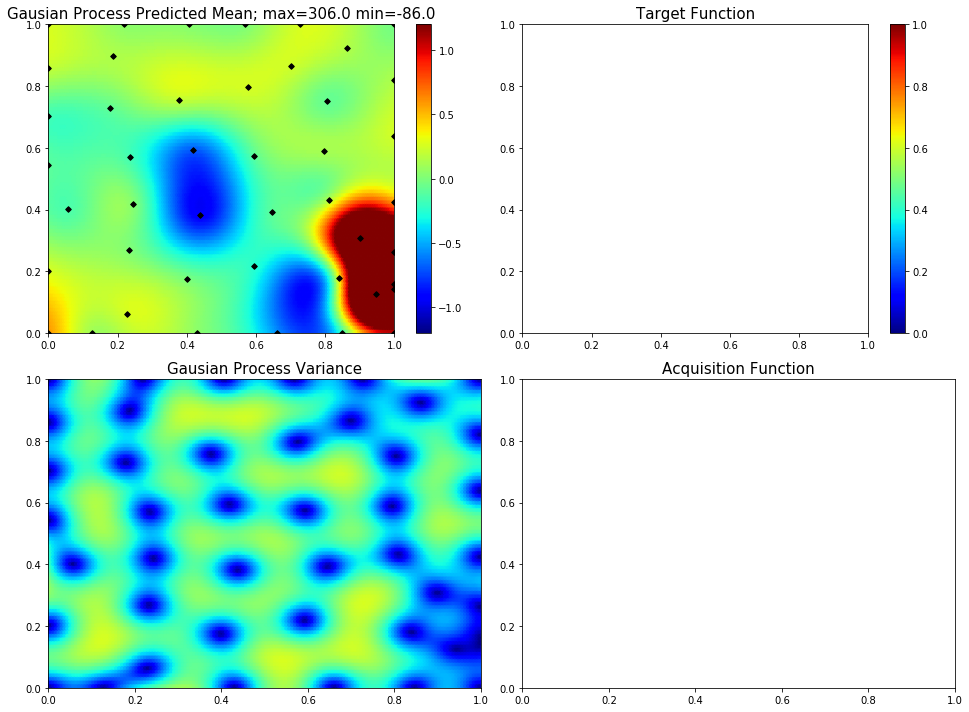

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1542217926926935, 0.12332594249504007]
60  Evaluations Remaining
|  46       |  0.1199   |  0.1542   |  0.1233   |
myplot:  046


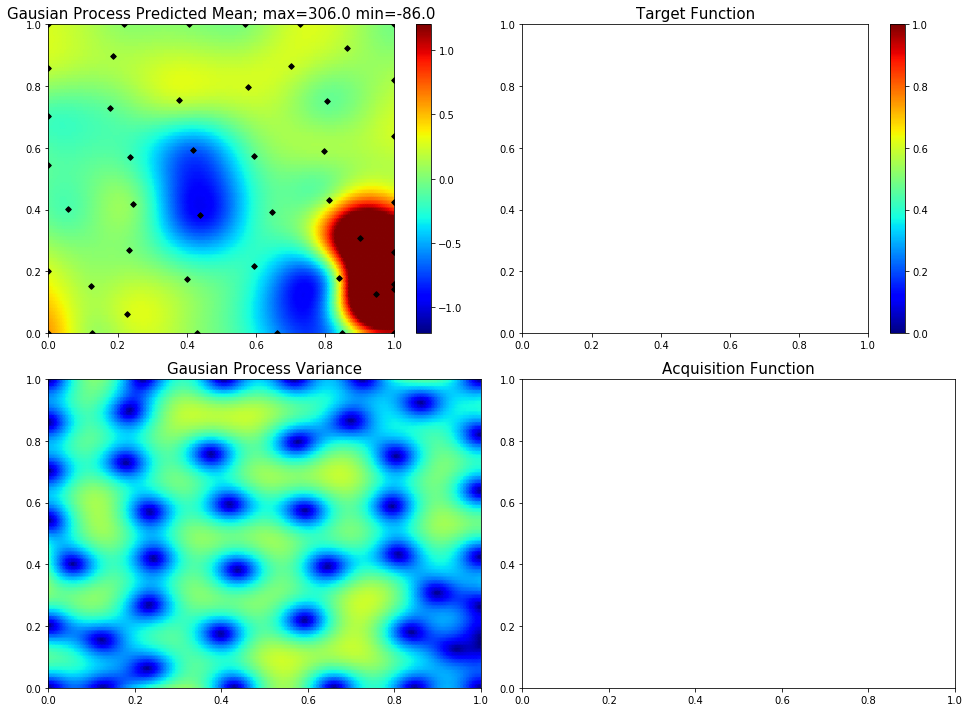

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8741733472742657, 0.4529081439115925]
59  Evaluations Remaining
|  47       |  0.09959  |  0.8742   |  0.4529   |
myplot:  047


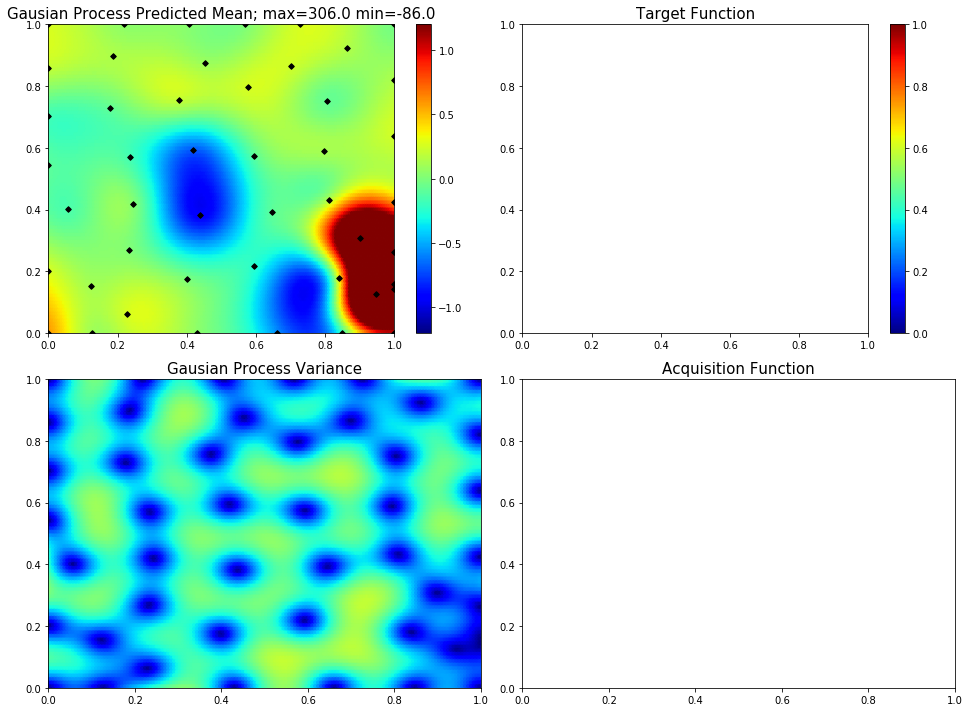

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6898465474235306, 0.6747830450585685]
58  Evaluations Remaining
|  48       |  0.3272   |  0.6898   |  0.6748   |
myplot:  048


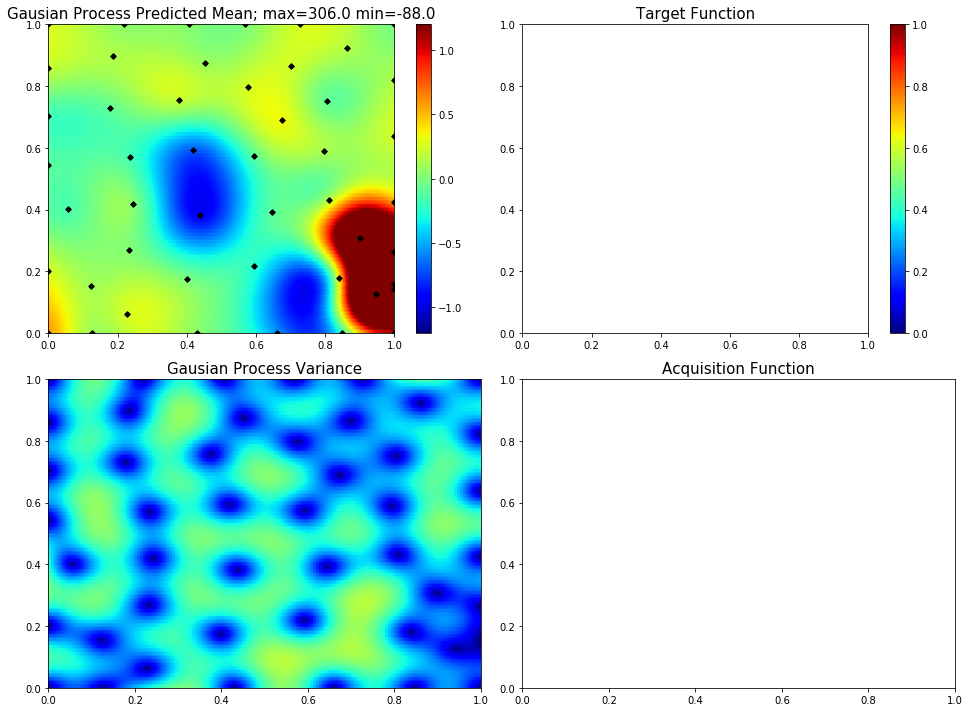

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2985124229640991, 0.7555012534787882]
57  Evaluations Remaining
|  49       |  0.381    |  0.2985   |  0.7555   |
myplot:  049


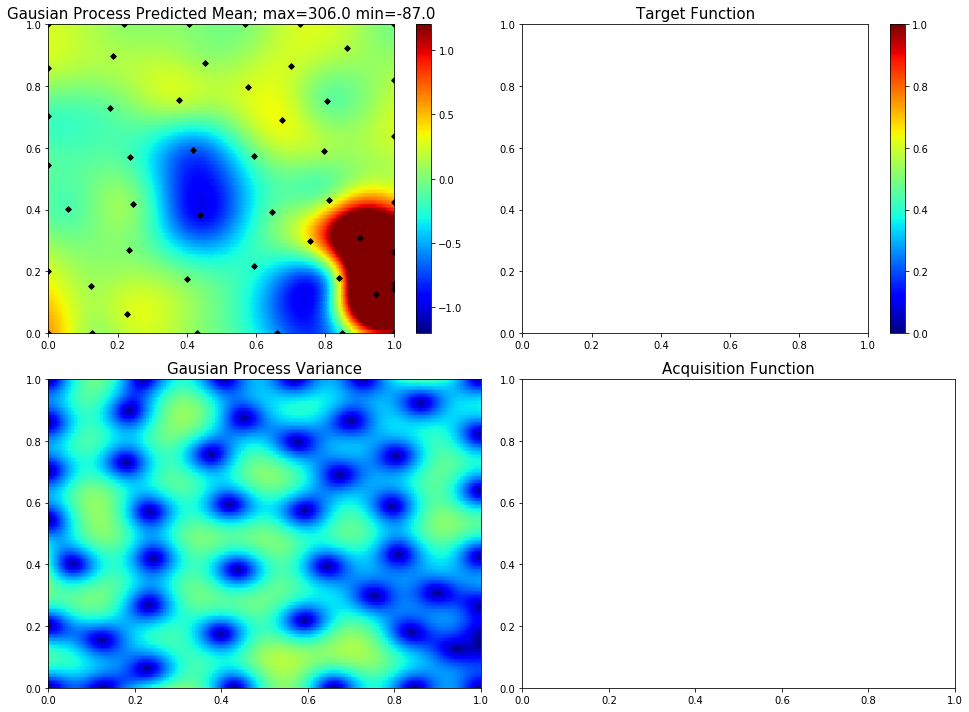

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.08541483016063262, 0.5361936410586322]
56  Evaluations Remaining
|  50       | -0.2006   |  0.08541  |  0.5362   |
myplot:  050


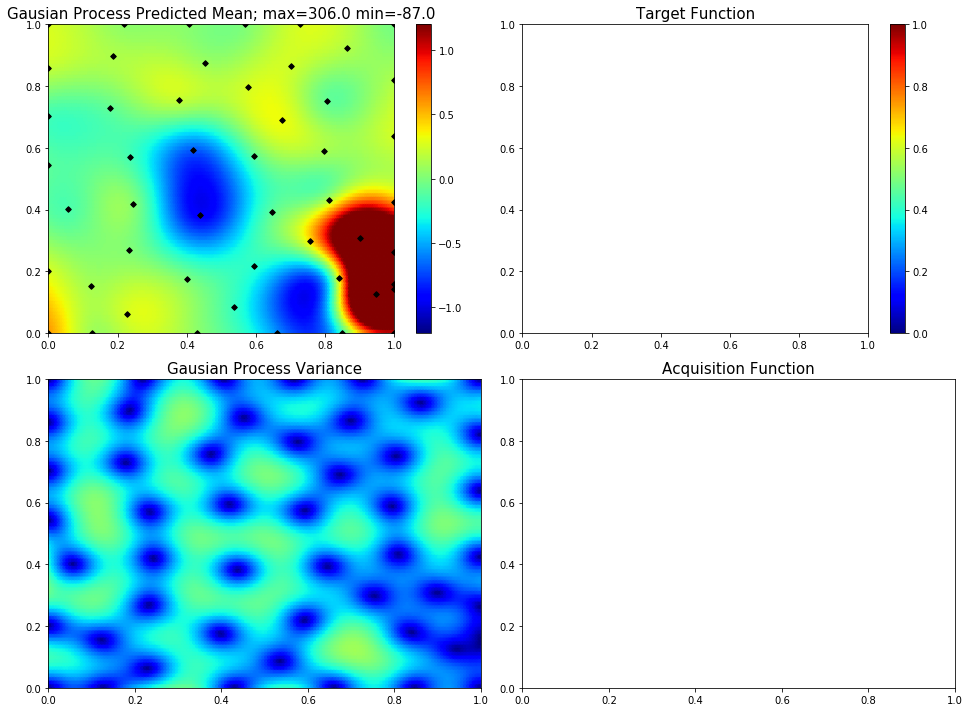

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8788087921321394, 0.3118678512993384]
55  Evaluations Remaining
|  51       | -0.1717   |  0.8788   |  0.3119   |
myplot:  051


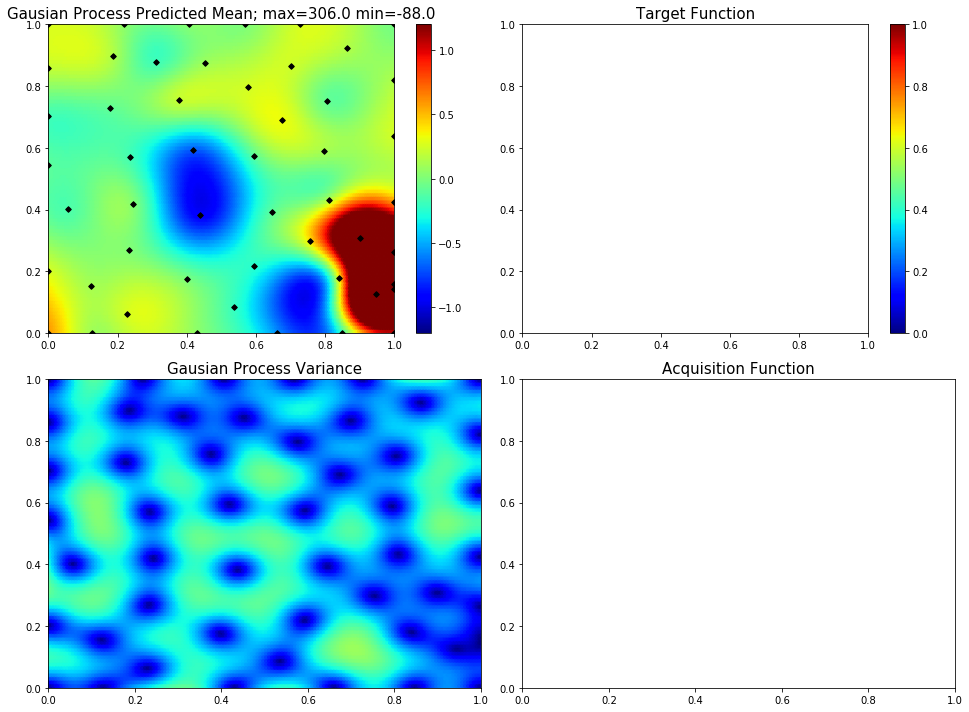

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21865122792162364, 0.9350221866379377]
54  Evaluations Remaining
|  52       |  3.284    |  0.2187   |  0.935    |
myplot:  052


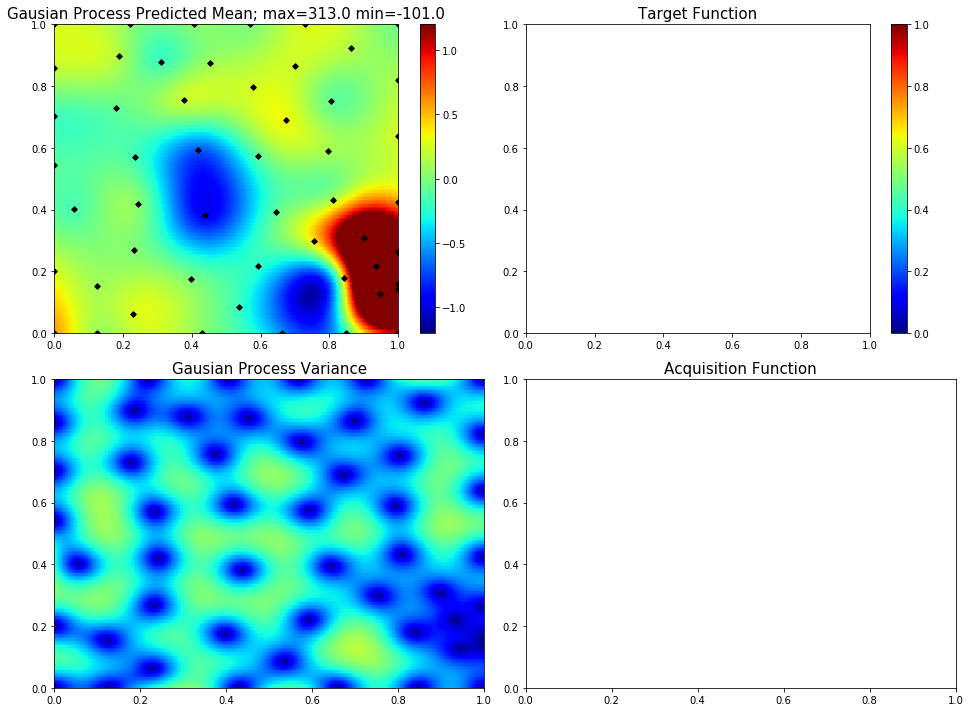

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5308054608274333, 0.9222783141388492]
53  Evaluations Remaining
|  53       |  0.1741   |  0.5308   |  0.9223   |
myplot:  053


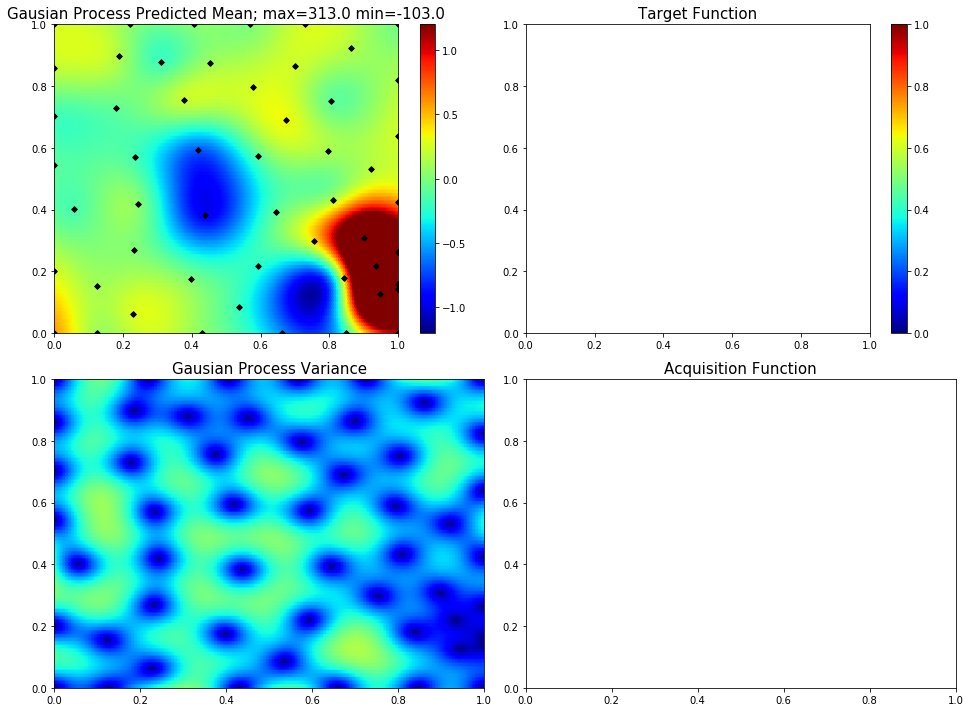

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.3084943657206509]
52  Evaluations Remaining
|  54       |  0.1382   |  0.0      |  0.3085   |
myplot:  054


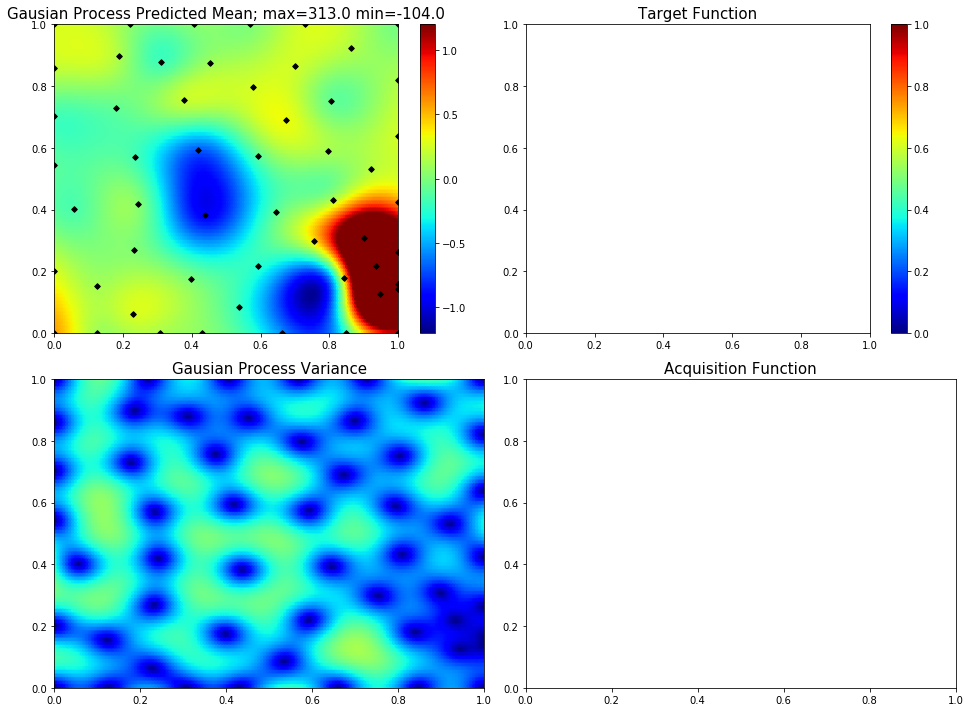

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5750186506962084, 0.11322181176182822]
51  Evaluations Remaining
|  55       | -0.01373  |  0.575    |  0.1132   |
myplot:  055


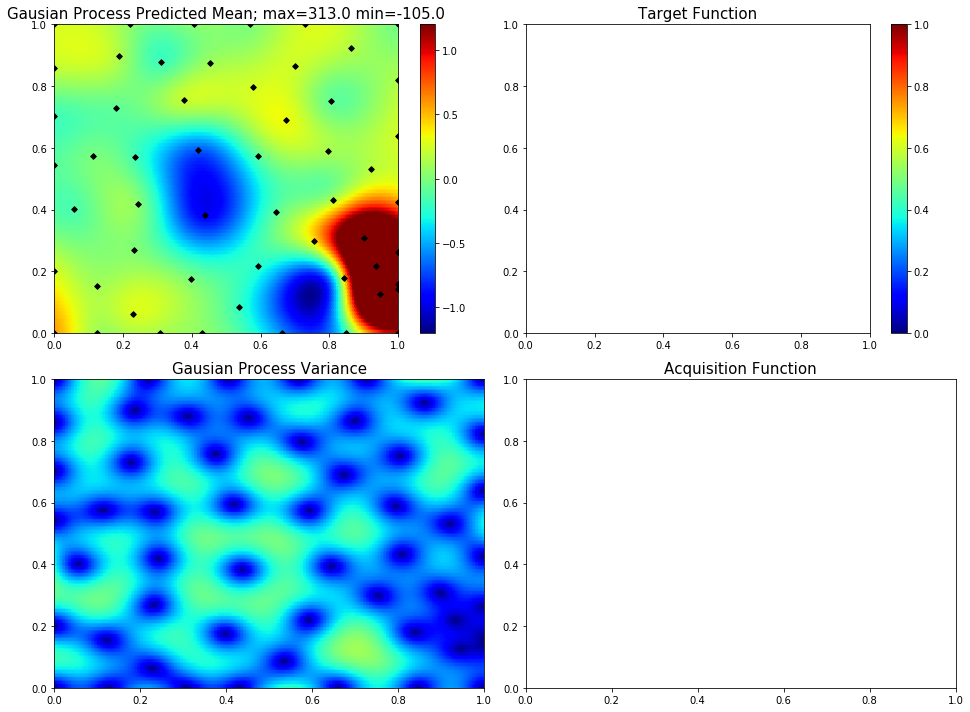

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.694675485457292, 0.5110295235088447]
50  Evaluations Remaining
|  56       |  0.02865  |  0.6947   |  0.511    |
myplot:  056


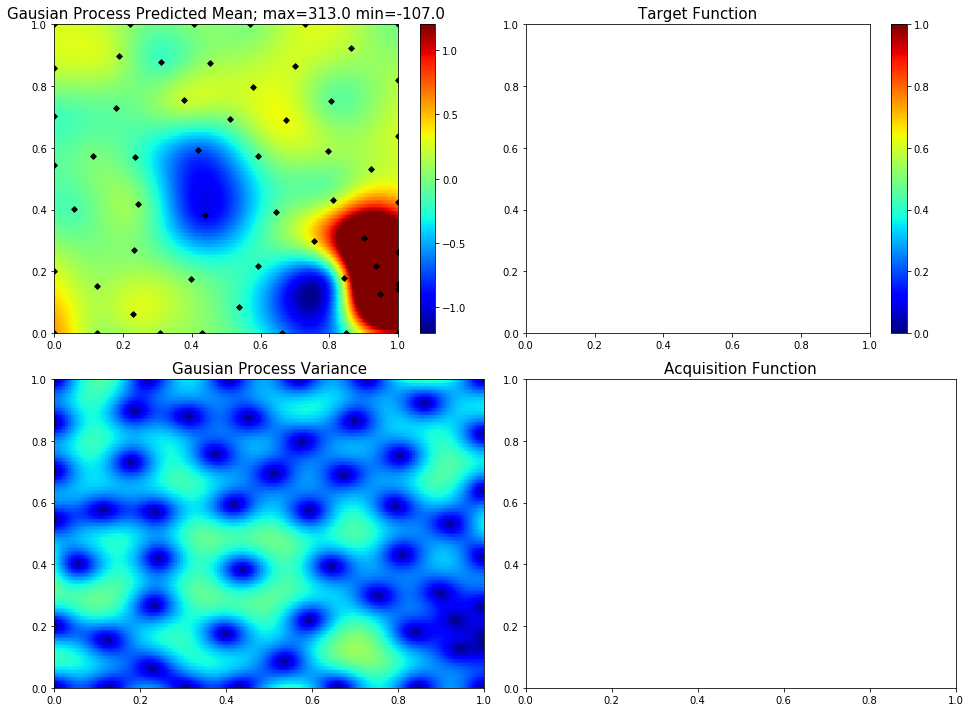

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.1048829020351946]
49  Evaluations Remaining
|  57       |  0.2223   |  1.0      |  0.1049   |
myplot:  057


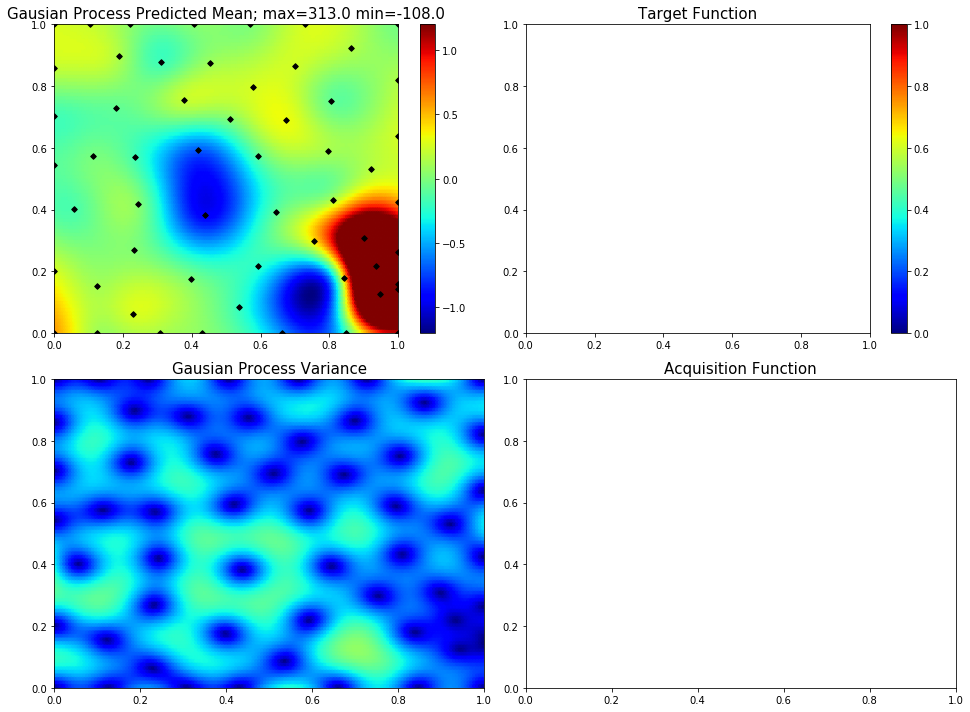

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2869683720054835, 0.10406780112190402]
48  Evaluations Remaining
|  58       |  0.01327  |  0.287    |  0.1041   |
myplot:  058


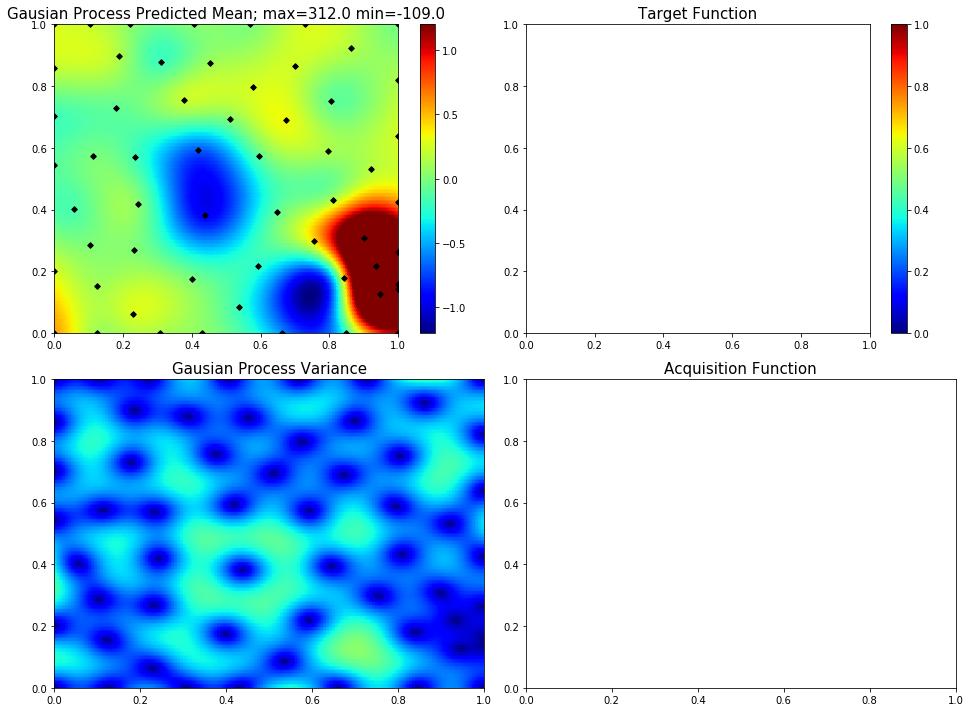

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.09529887592771606, 0.0]
47  Evaluations Remaining
|  59       |  0.5784   |  0.0953   |  0.0      |
myplot:  059


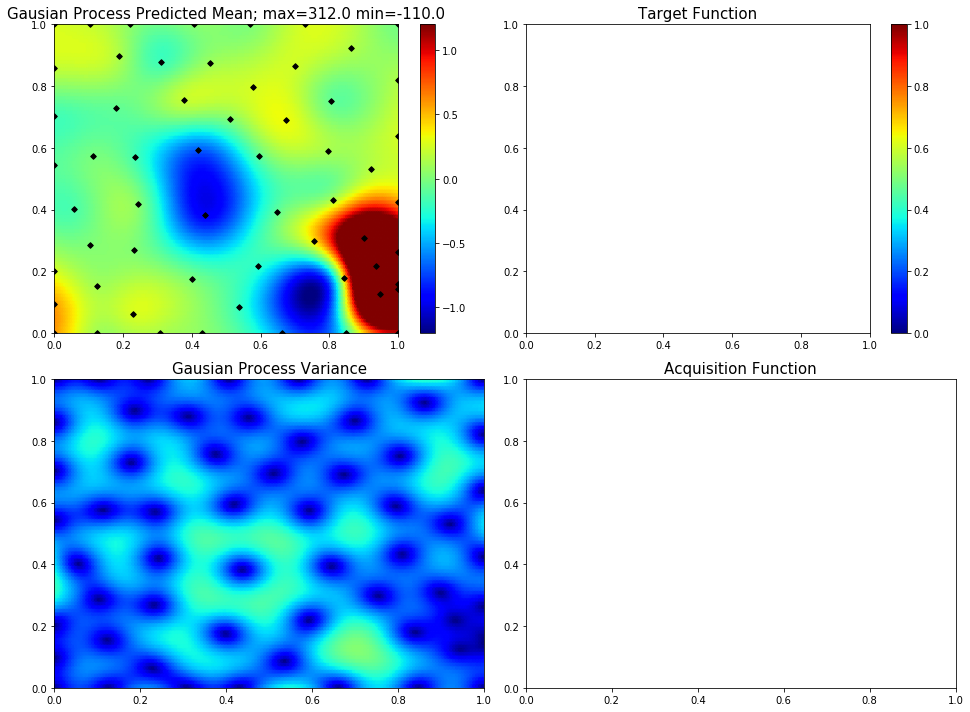

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.17120030821014806, 0.9542445715585979]
46  Evaluations Remaining
|  60       |  3.187    |  0.1712   |  0.9542   |
myplot:  060


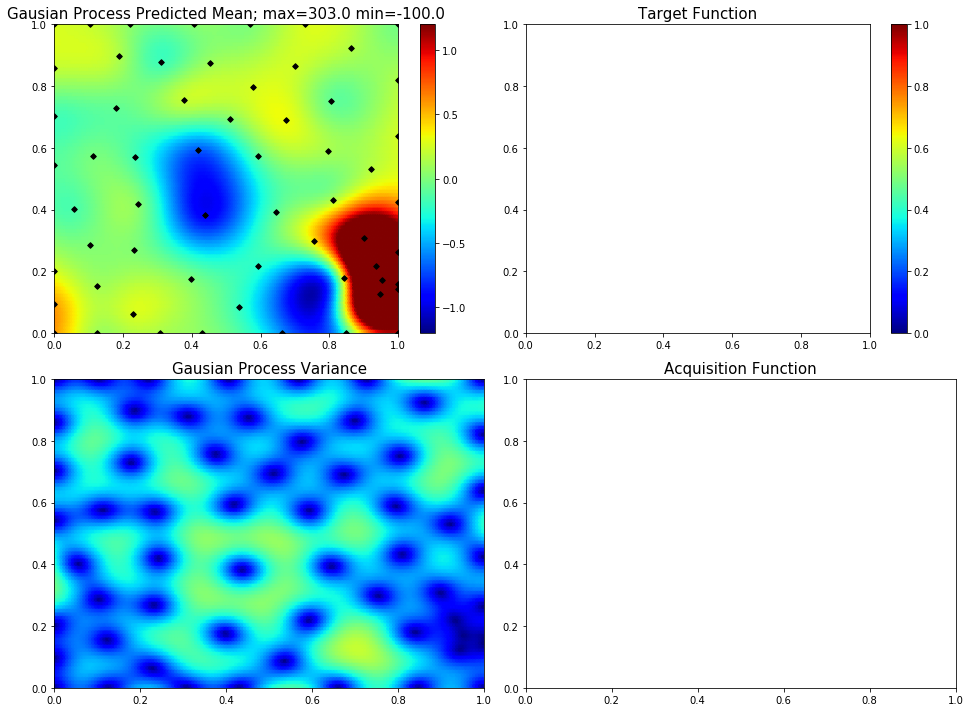

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.07748364144755097, 0.9732625369020941]
45  Evaluations Remaining
|  61       |  1.062    |  0.07748  |  0.9733   |
myplot:  061


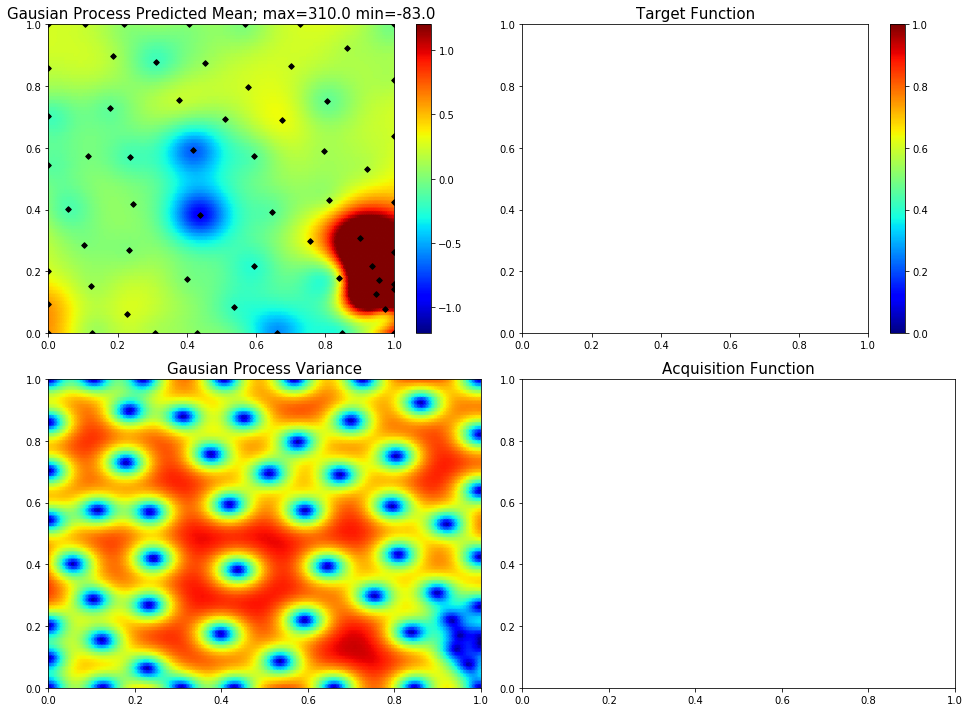

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.13724433551788512, 0.7056679744005439]
44  Evaluations Remaining
|  62       | -0.5985   |  0.1372   |  0.7057   |
myplot:  062


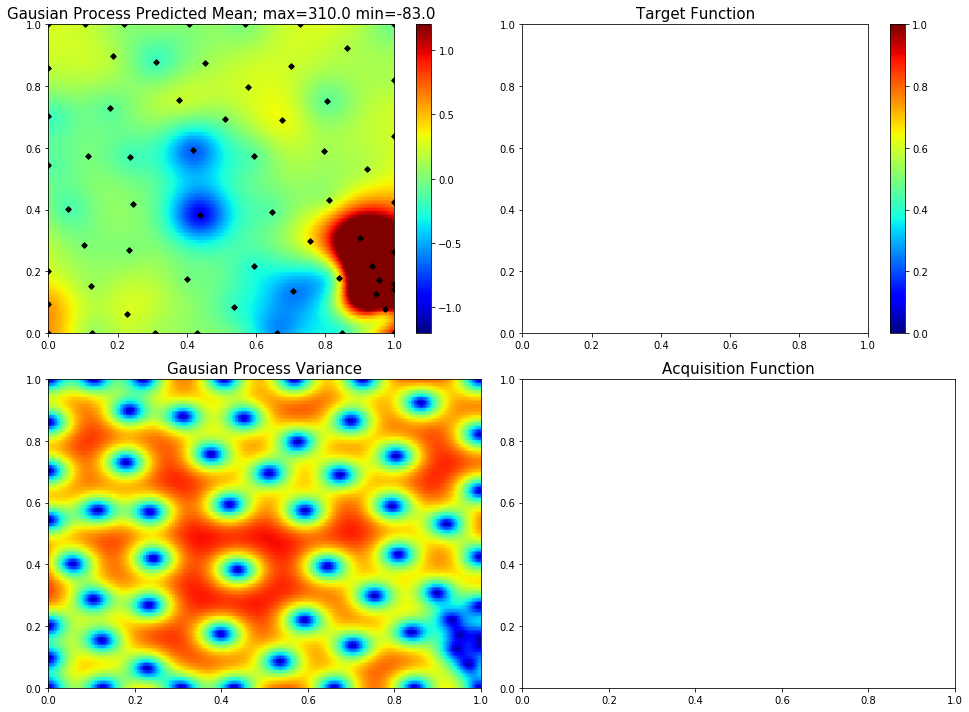

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1436941140379483, 0.9983578085602856]
43  Evaluations Remaining
|  63       |  3.202    |  0.1437   |  0.9984   |
myplot:  063


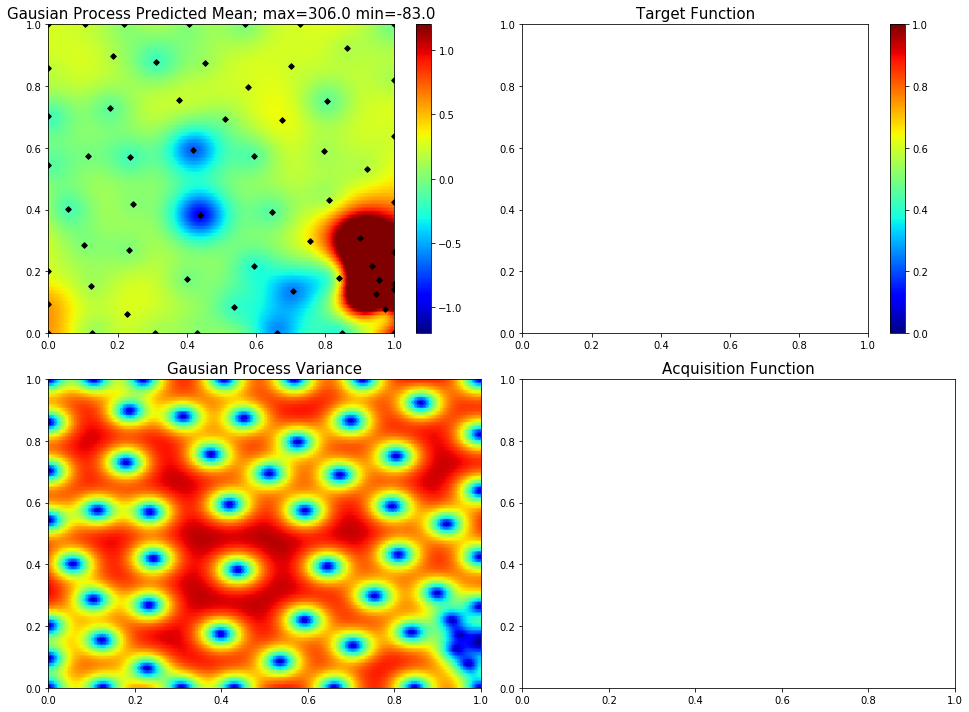

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.721379225255544, 0.9196144493288181]
42  Evaluations Remaining
|  64       | -0.05822  |  0.7214   |  0.9196   |
myplot:  064


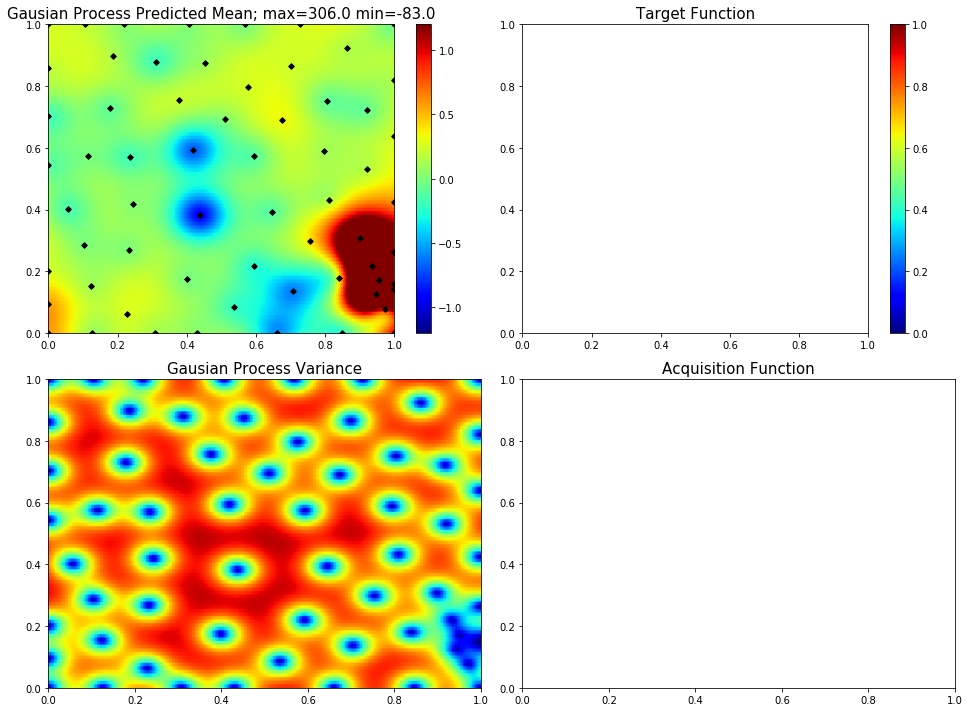

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5100964034103596, 0.702022457537564]
41  Evaluations Remaining
|  65       |  0.00904  |  0.5101   |  0.702    |
myplot:  065


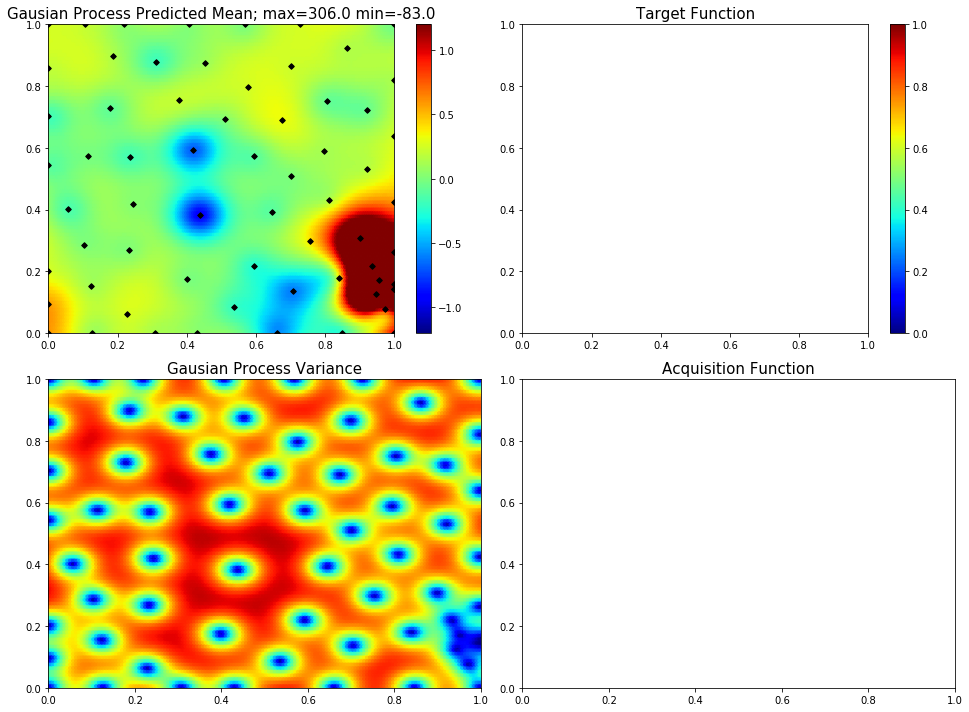

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16017405401429005, 0.28322539090725146]
40  Evaluations Remaining
|  66       | -0.05109  |  0.1602   |  0.2832   |
myplot:  066


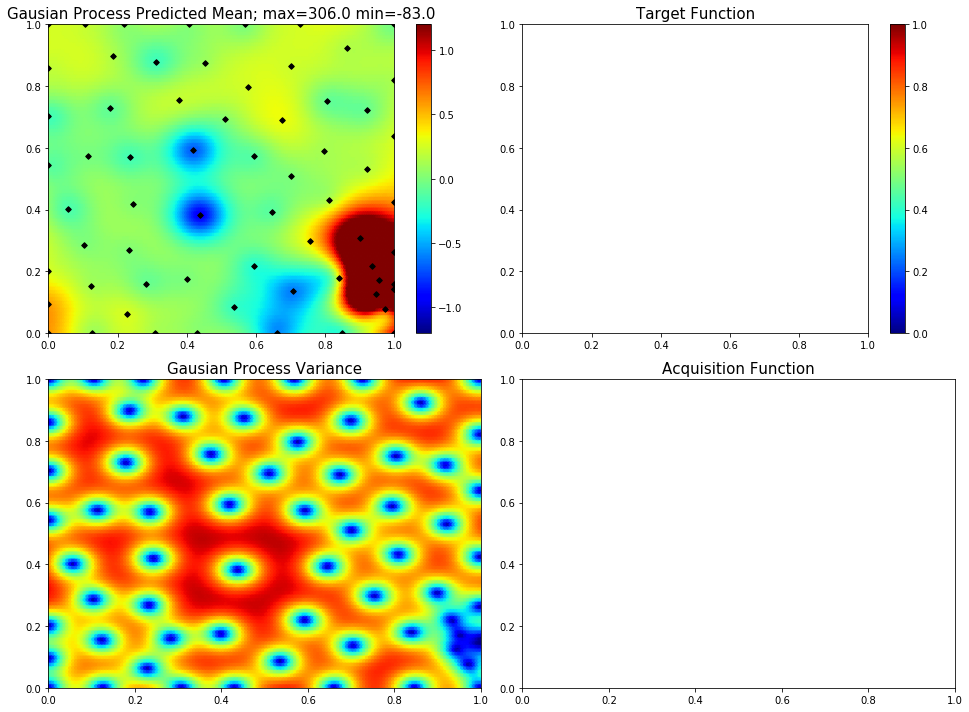

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6769690466714801, 0.29457488239124185]
39  Evaluations Remaining
|  67       | -0.1852   |  0.677    |  0.2946   |
myplot:  067


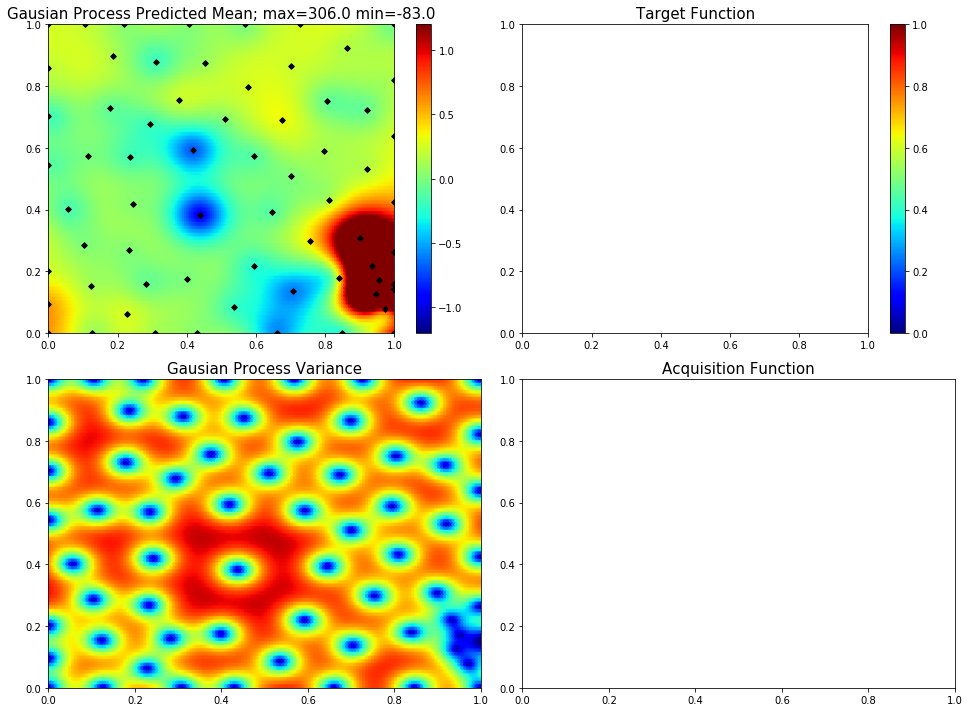

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.46950227903810904, 0.533428240956956]
38  Evaluations Remaining
|  68       | -0.5154   |  0.4695   |  0.5334   |
myplot:  068


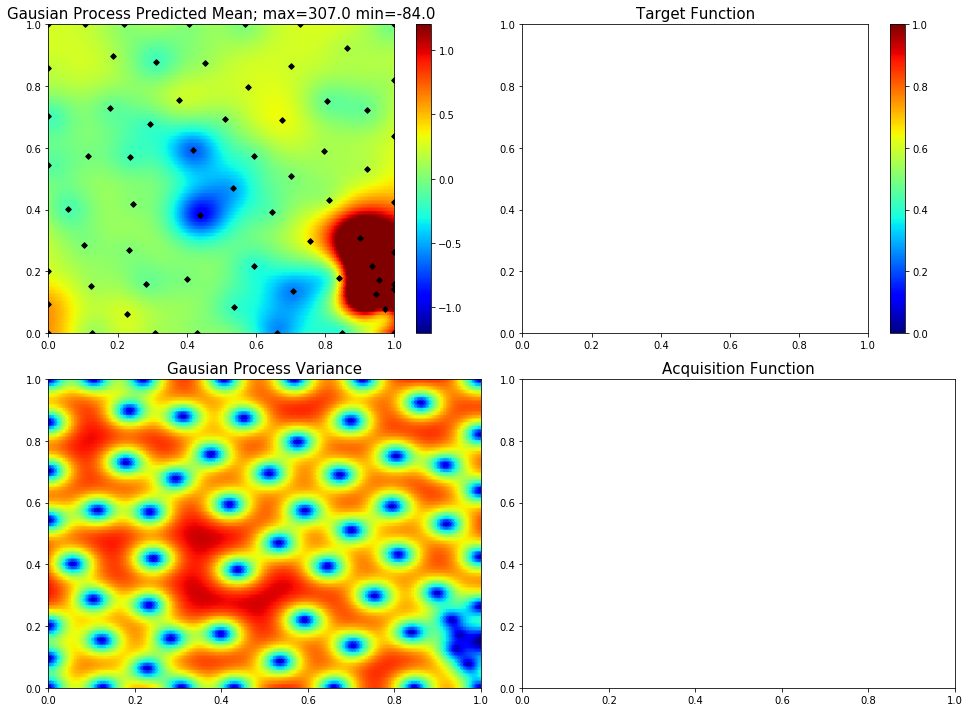

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2942159100006877, 0.34791944674334263]
37  Evaluations Remaining
|  69       | -0.07554  |  0.2942   |  0.3479   |
myplot:  069


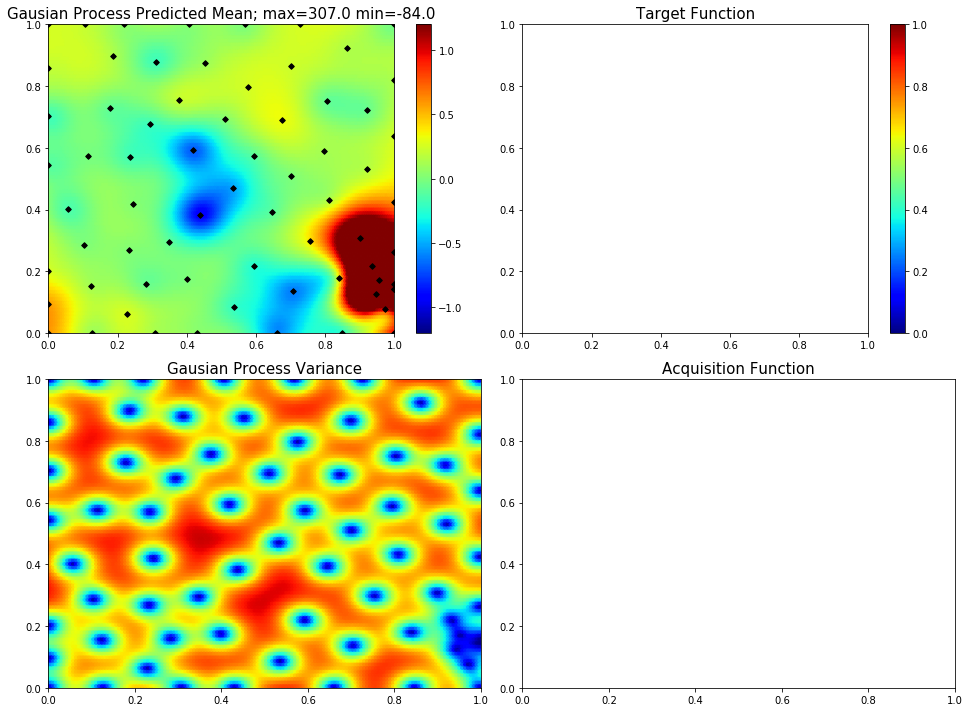

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3919729162970179, 0.9095690441191843]
36  Evaluations Remaining
|  70       |  0.7048   |  0.392    |  0.9096   |
myplot:  070


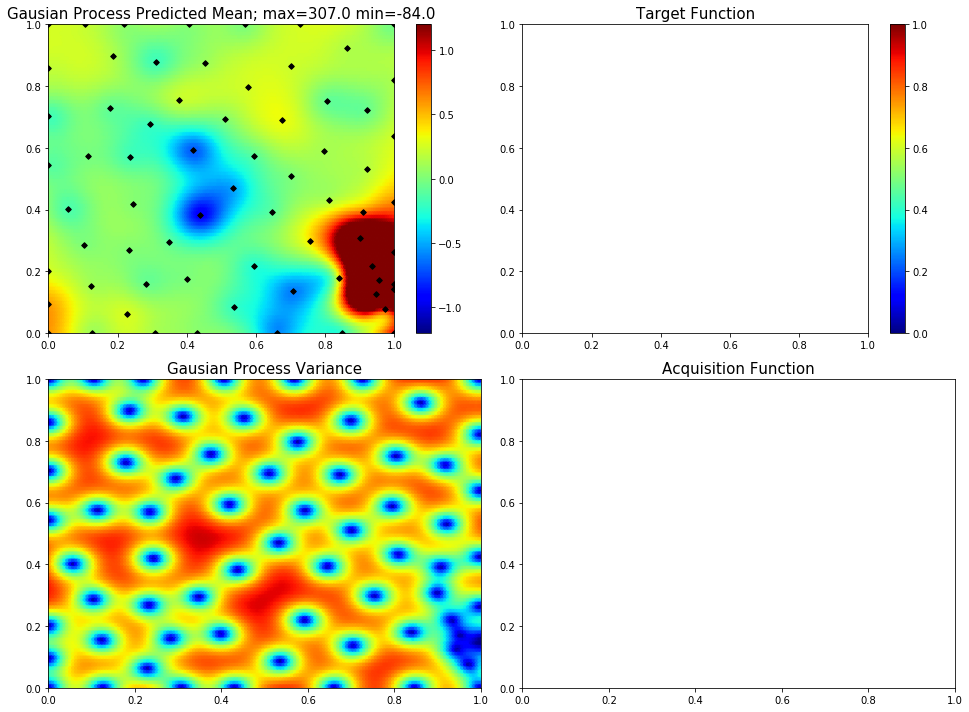

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8119563453409326, 0.09857853556617428]
35  Evaluations Remaining
|  71       |  0.1478   |  0.812    |  0.09858  |
myplot:  071


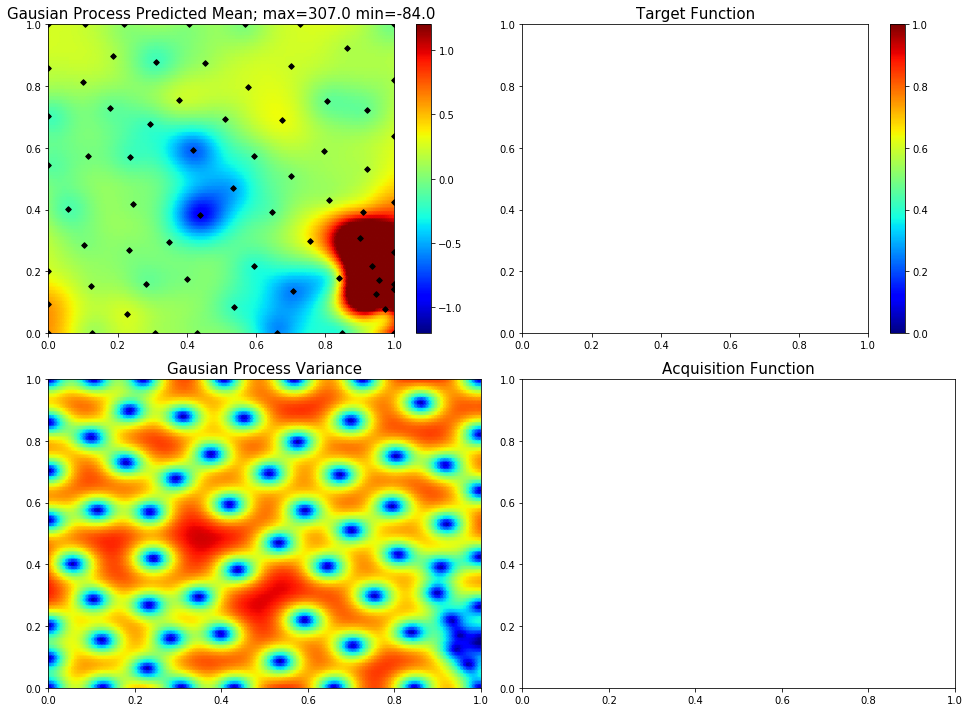

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.48530041913377747, 0.34470309675271127]
34  Evaluations Remaining
|  72       | -0.5014   |  0.4853   |  0.3447   |
myplot:  072


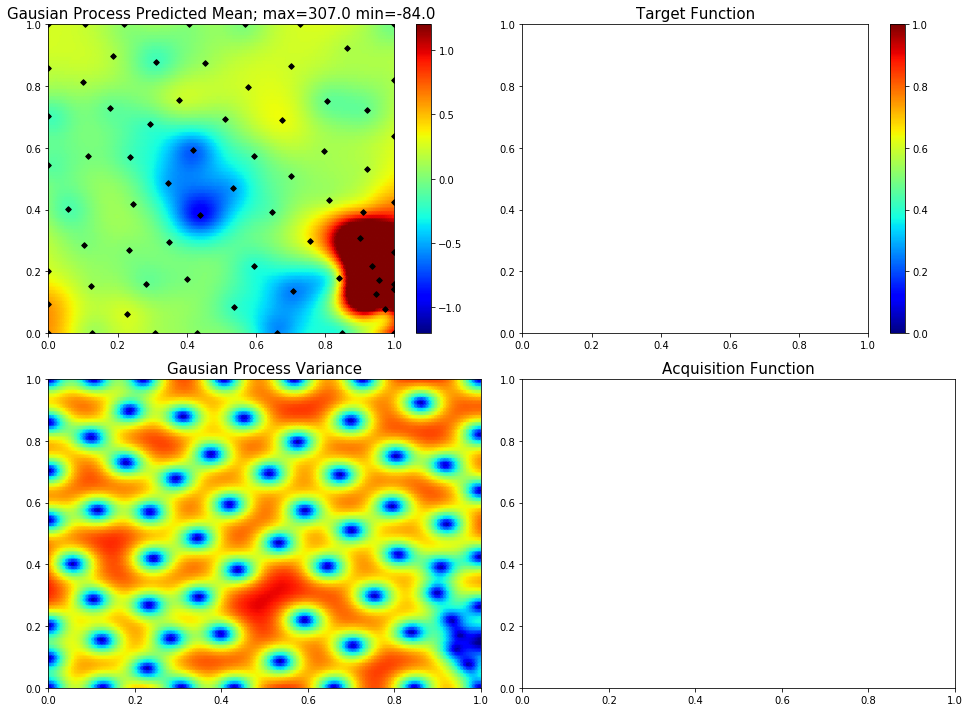

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.264563667327038, 0.48691336487343573]
33  Evaluations Remaining
|  73       | -0.4615   |  0.2646   |  0.4869   |
myplot:  073


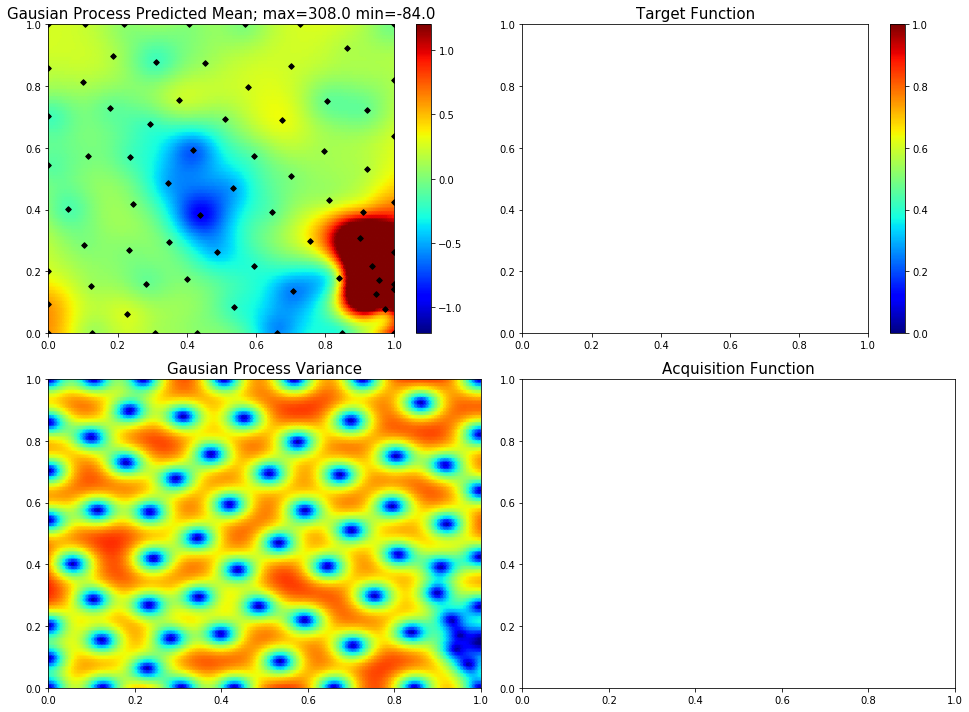

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3150210256678373, 0.0]
32  Evaluations Remaining
|  74       | -0.1135   |  0.315    |  0.0      |
myplot:  074


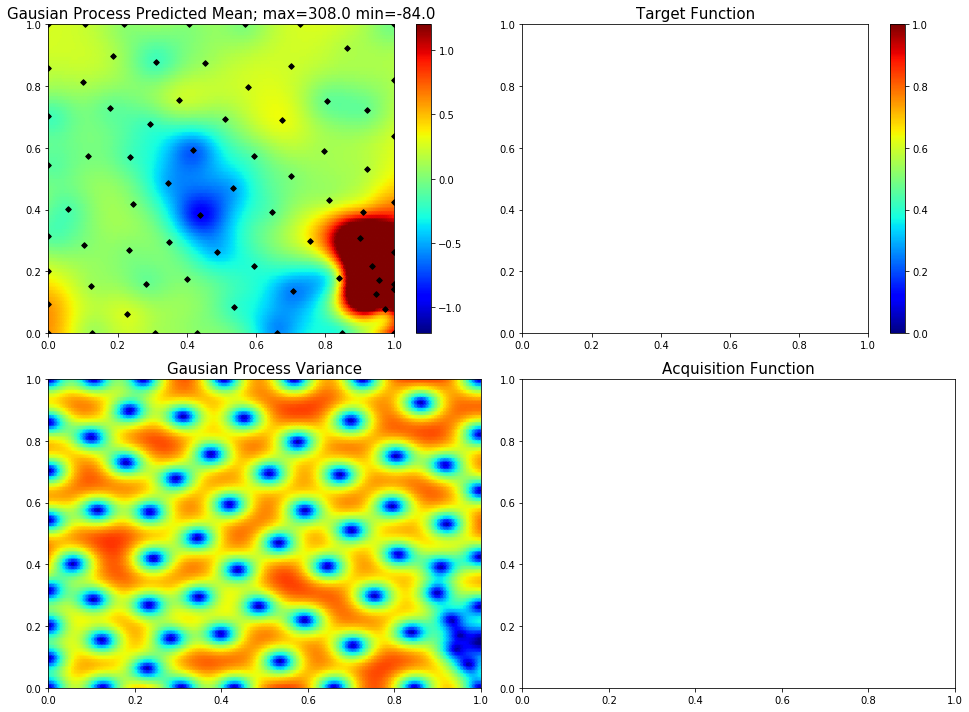

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.33817345467704896, 1.0]
31  Evaluations Remaining
|  75       |  2.435    |  0.3382   |  1.0      |
myplot:  075


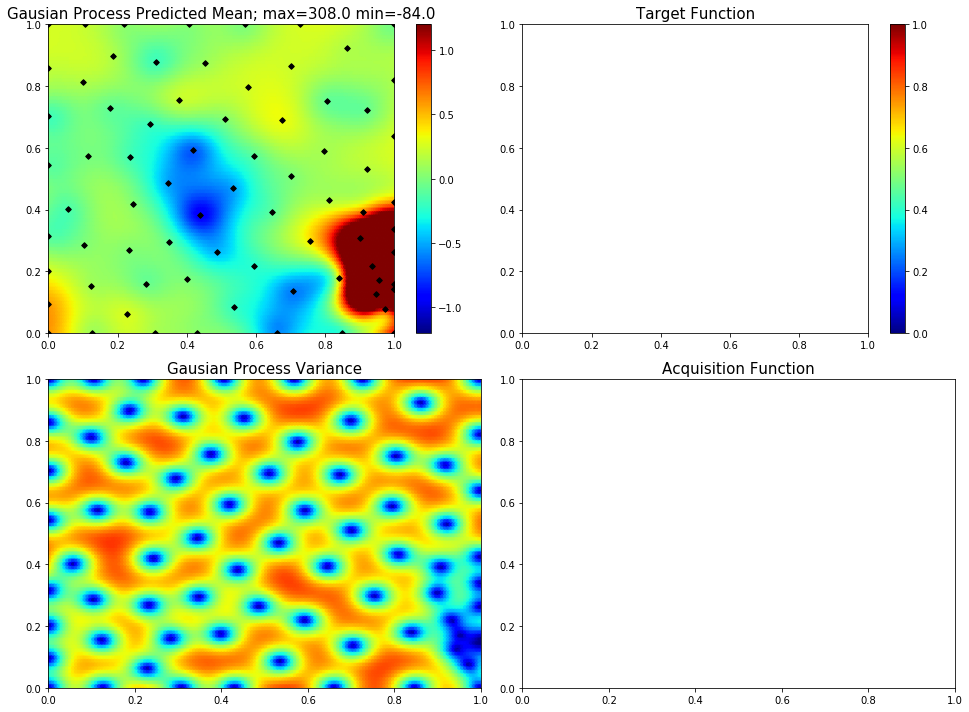

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.09930349468507112, 0.8774232947780388]
30  Evaluations Remaining
|  76       |  1.114    |  0.0993   |  0.8774   |
myplot:  076


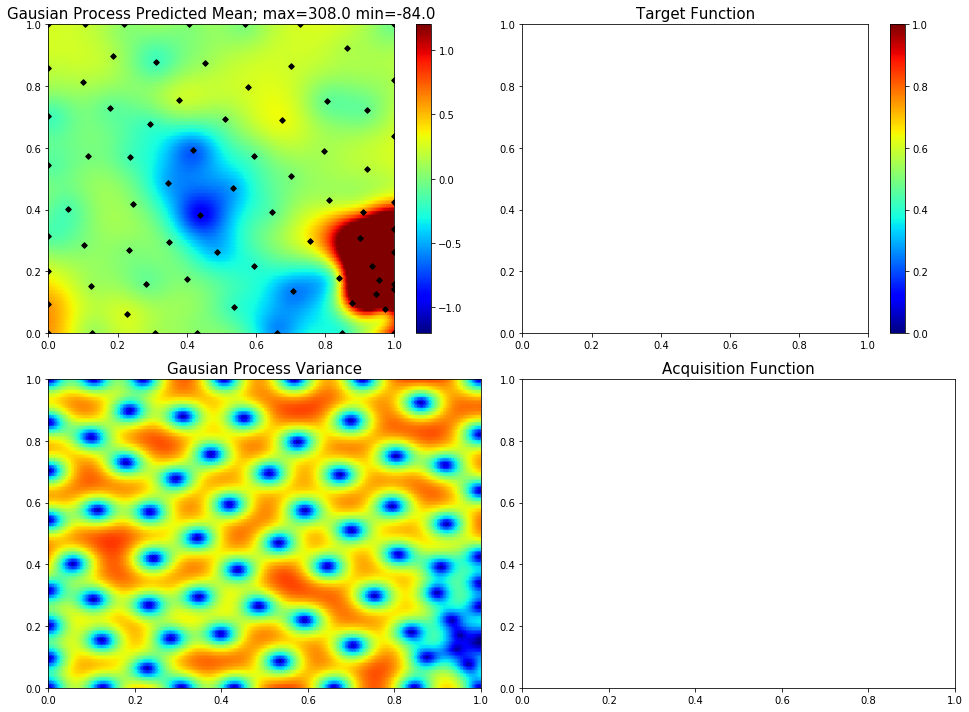

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8998258528444368, 0.5906627447460805]
29  Evaluations Remaining
|  77       |  0.04807  |  0.8998   |  0.5907   |
myplot:  077


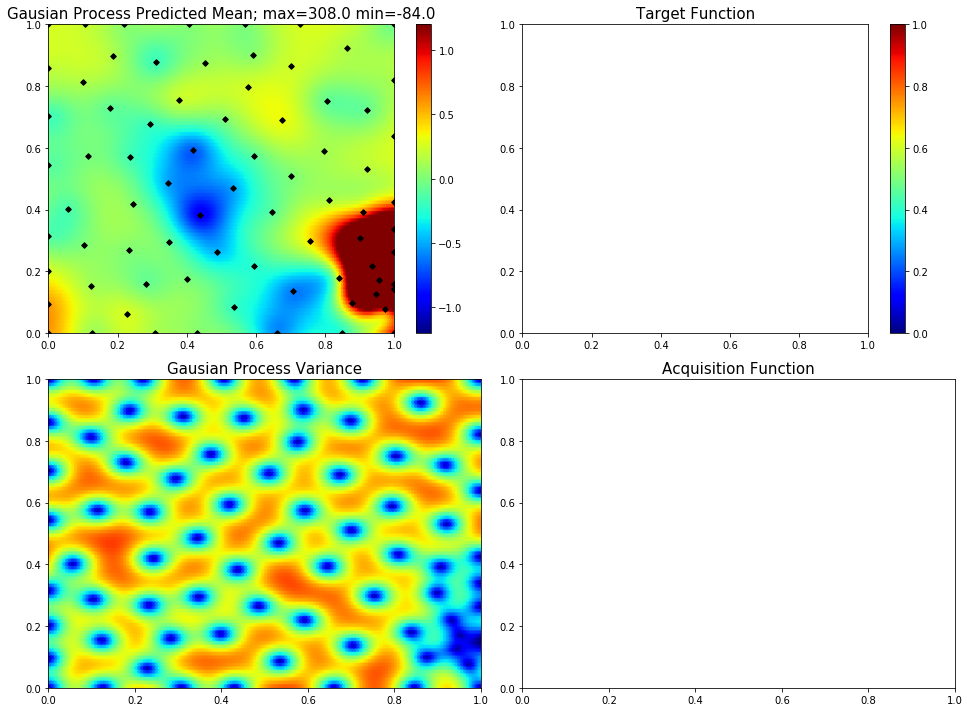

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.46834333062278677, 0.14650257193595395]
28  Evaluations Remaining
|  78       |  0.009811 |  0.4683   |  0.1465   |
myplot:  078


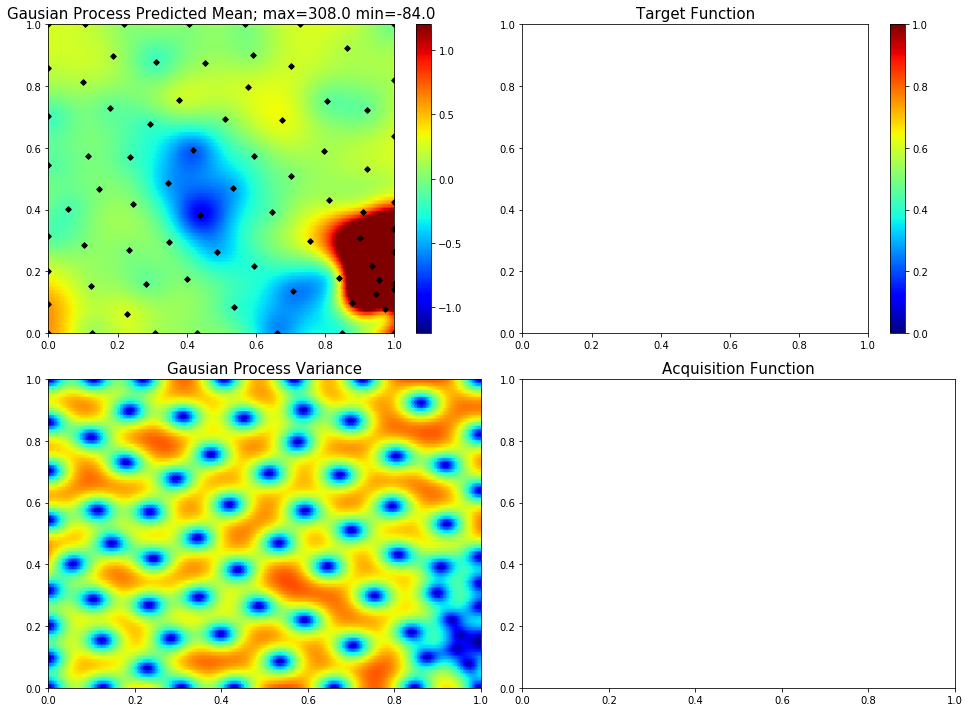

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8449489331467934]
27  Evaluations Remaining
|  79       |  0.1073   |  1.0      |  0.8449   |
myplot:  079


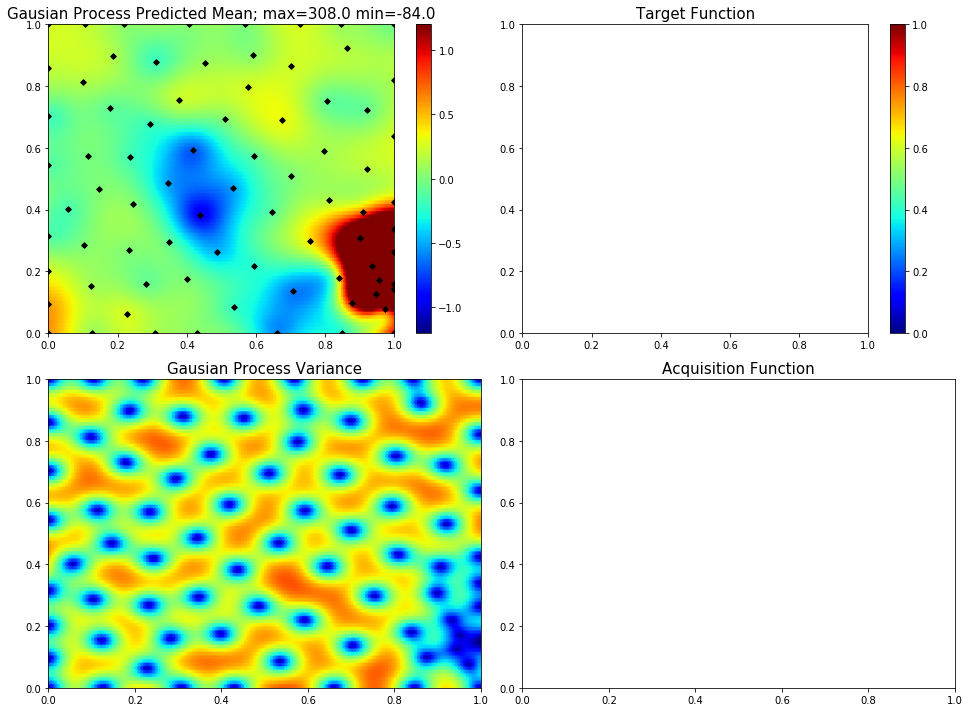

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.825845880260654, 0.8872888804264073]
26  Evaluations Remaining
|  80       |  0.05336  |  0.8258   |  0.8873   |
myplot:  080


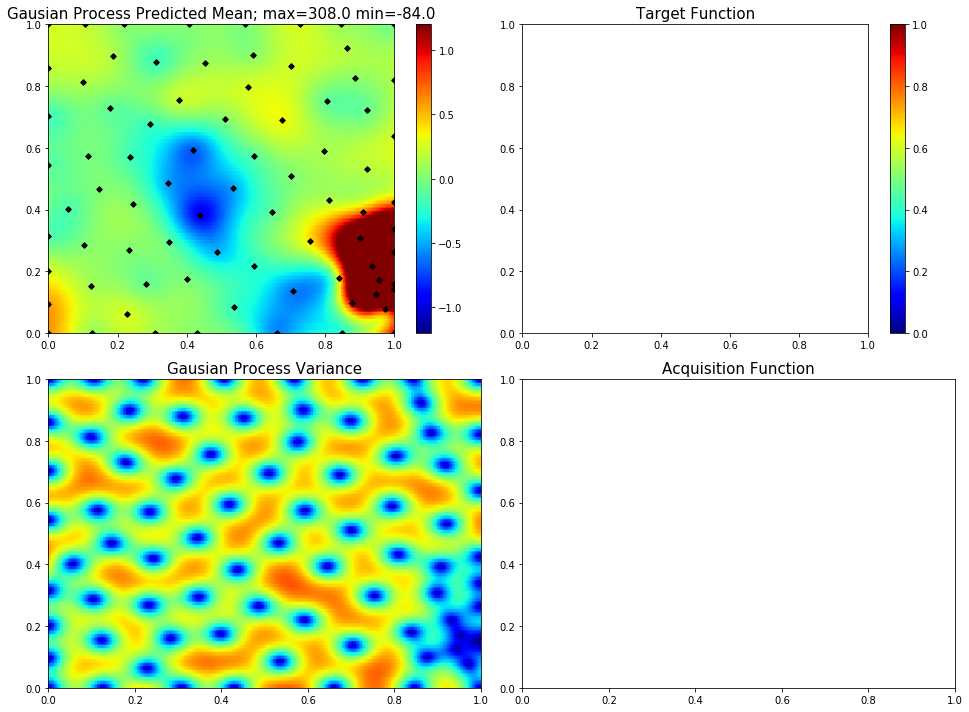

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7915810555211878, 0.25963585998302635]
25  Evaluations Remaining
|  81       | -0.09482  |  0.7916   |  0.2596   |
myplot:  081


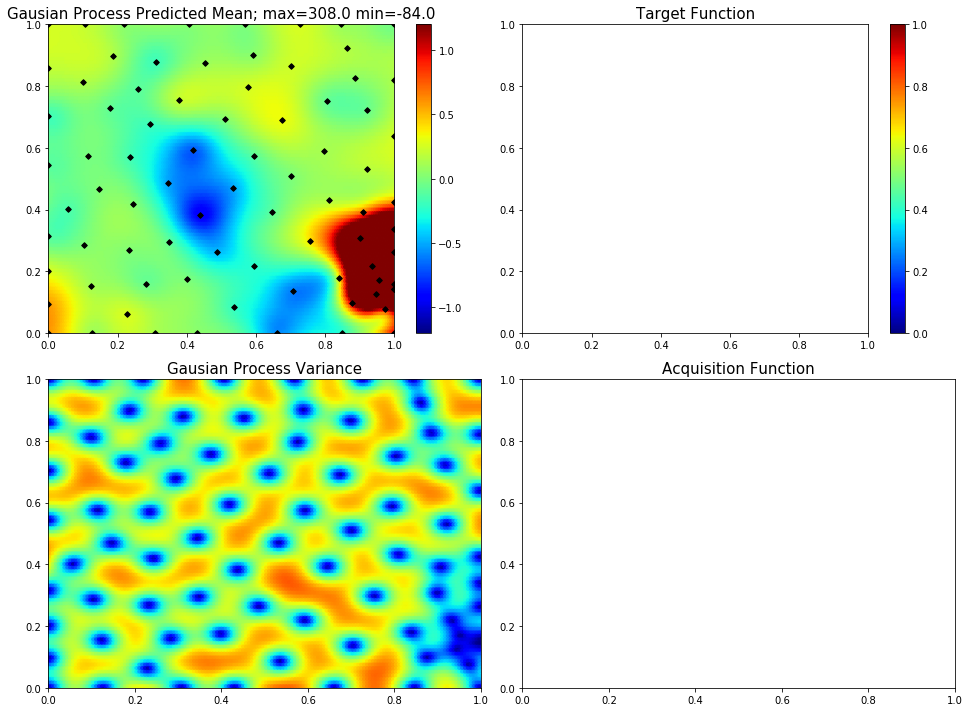

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2891945921373078, 0.9508225069666454]
24  Evaluations Remaining
|  82       |  2.36     |  0.2892   |  0.9508   |
myplot:  082


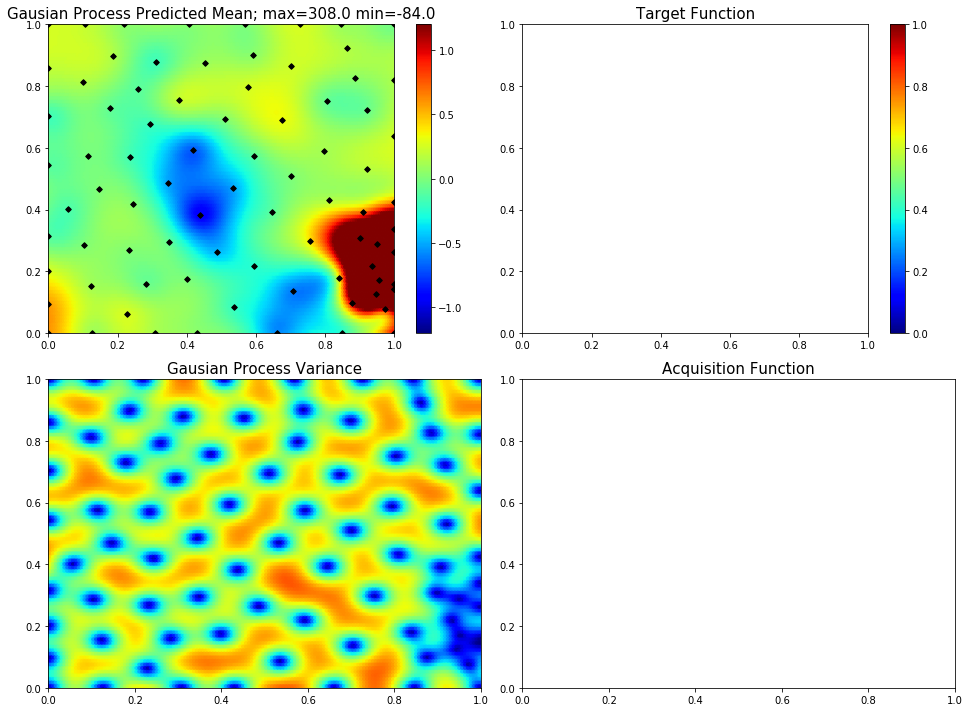

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.25588541008408877, 0.8668376236921173]
23  Evaluations Remaining
|  83       |  0.4345   |  0.2559   |  0.8668   |
myplot:  083


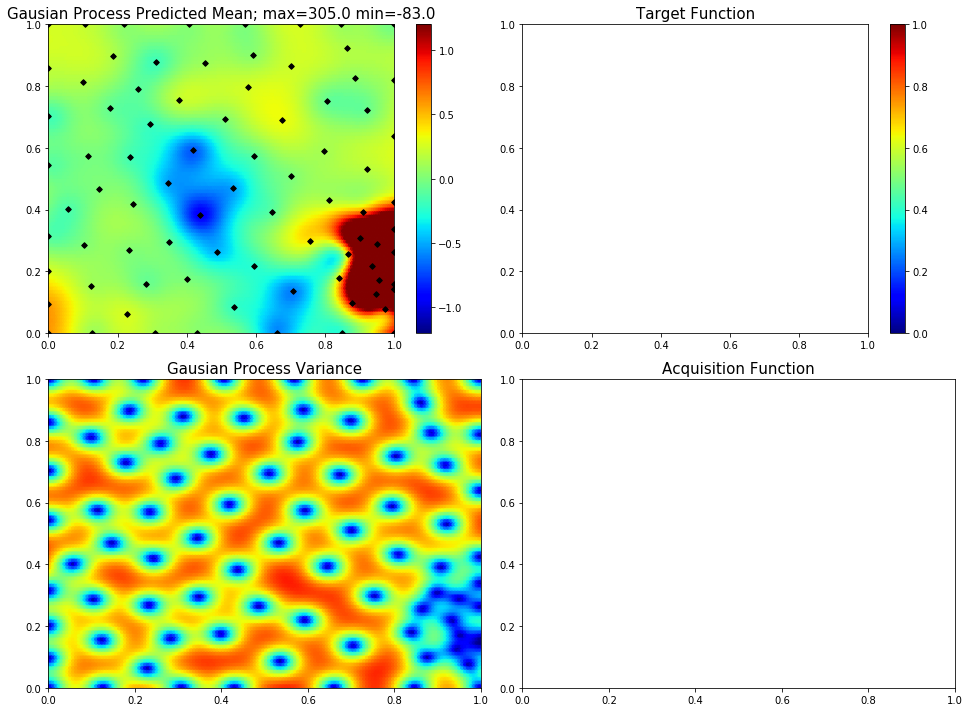

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.5444712178692875]
22  Evaluations Remaining
|  84       | -0.3014   |  0.0      |  0.5445   |
myplot:  084


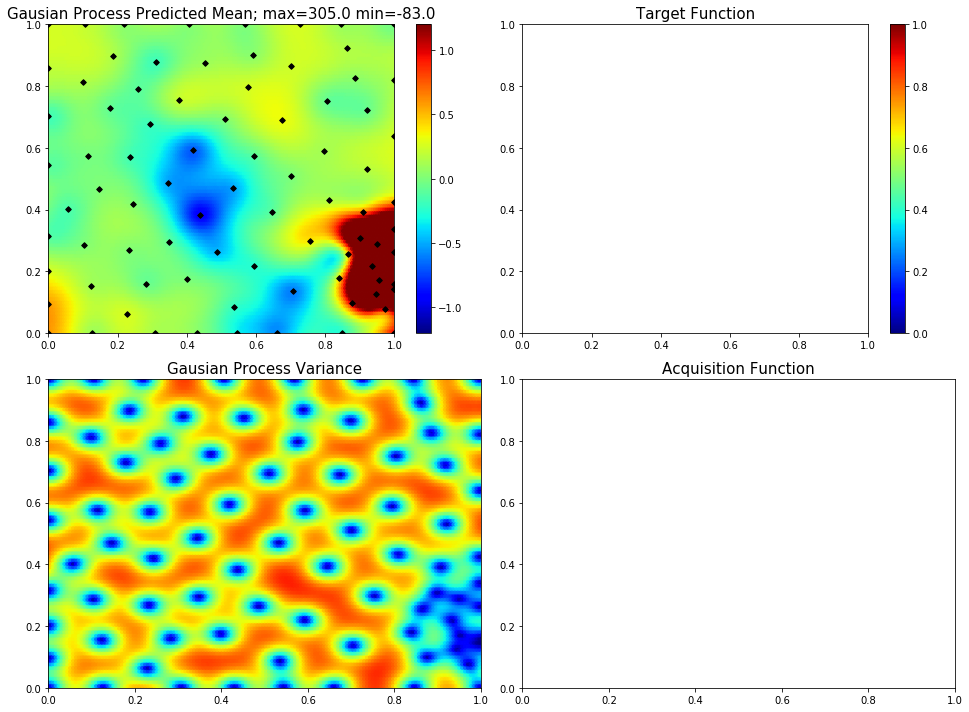

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.313330988572596]
21  Evaluations Remaining
|  85       | -0.1656   |  1.0      |  0.3133   |
myplot:  085


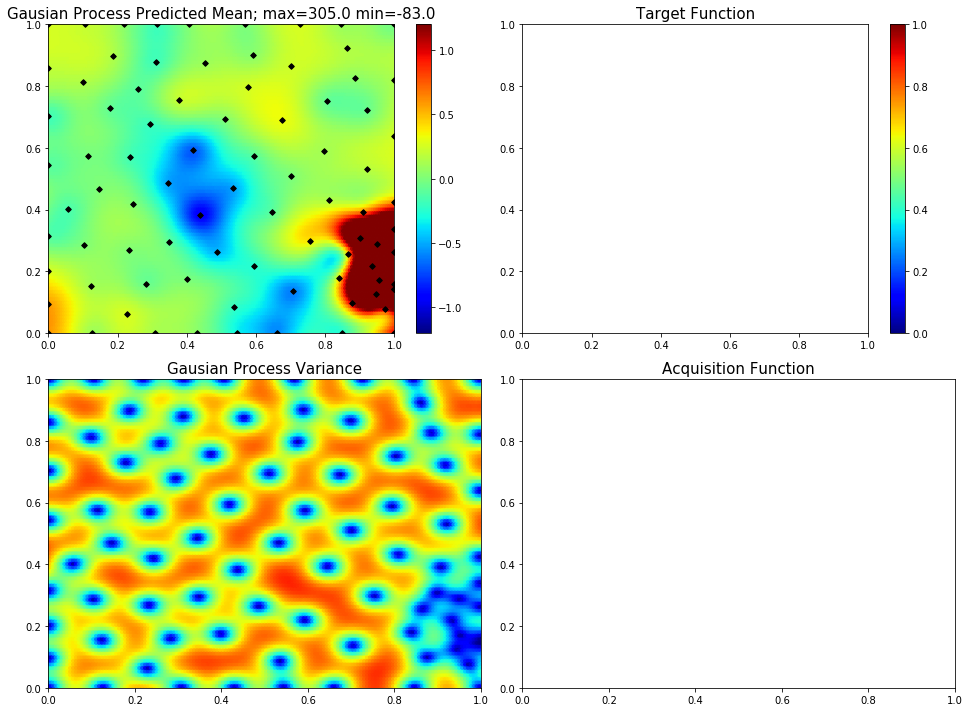

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.08213918986072098, 0.3675750849816073]
20  Evaluations Remaining
|  86       |  0.02442  |  0.08214  |  0.3676   |
myplot:  086


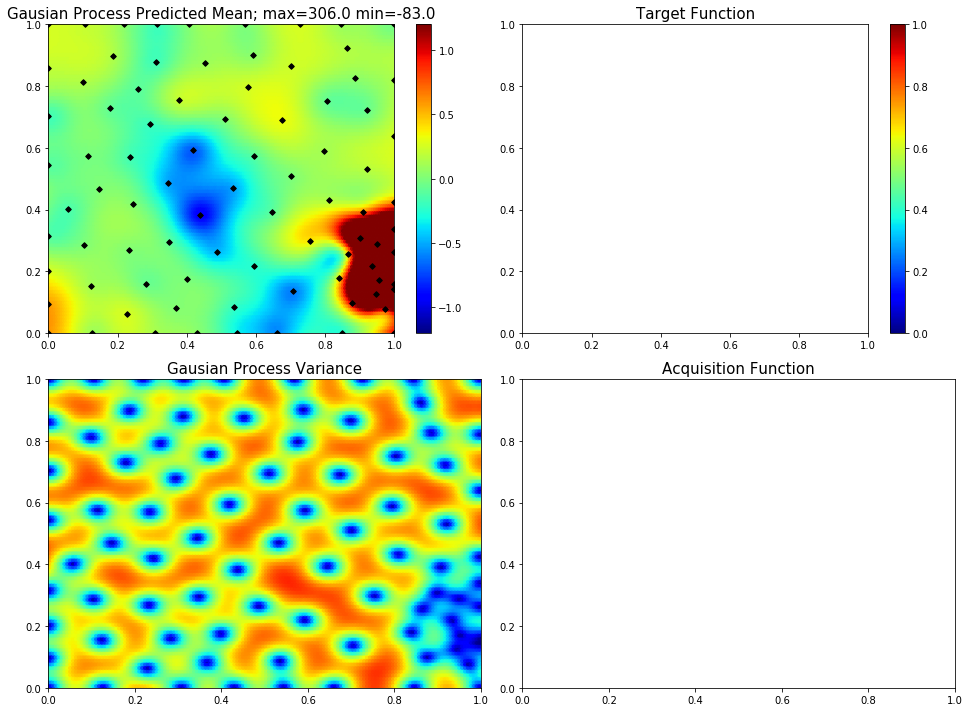

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1626103160222745, 0.9110936002118988]
19  Evaluations Remaining
|  87       |  3.231    |  0.1626   |  0.9111   |
myplot:  087


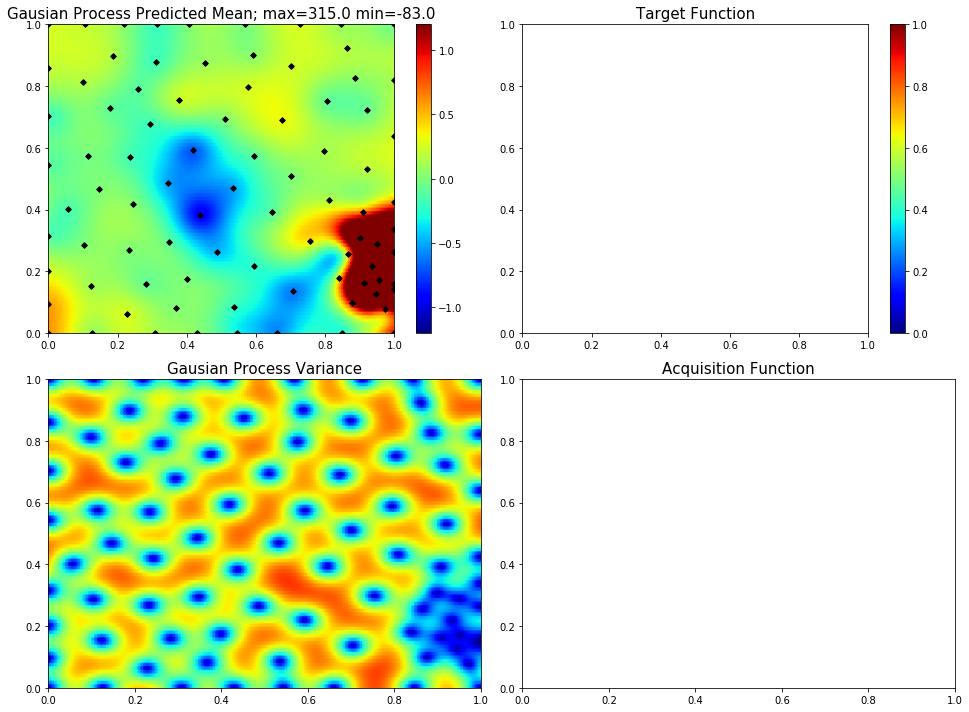

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.21147550246485614, 1.0]
18  Evaluations Remaining
|  88       |  3.246    |  0.2115   |  1.0      |
myplot:  088


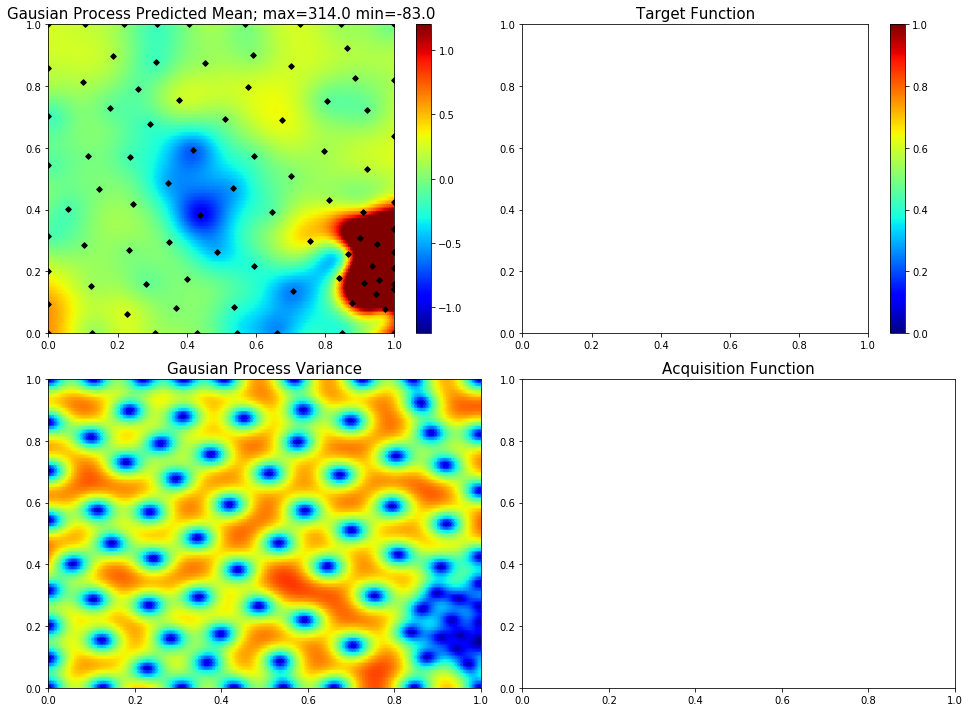

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22415700996724258, 0.9668711009921286]
17  Evaluations Remaining
|  89       |  3.386    |  0.2242   |  0.9669   |
myplot:  089


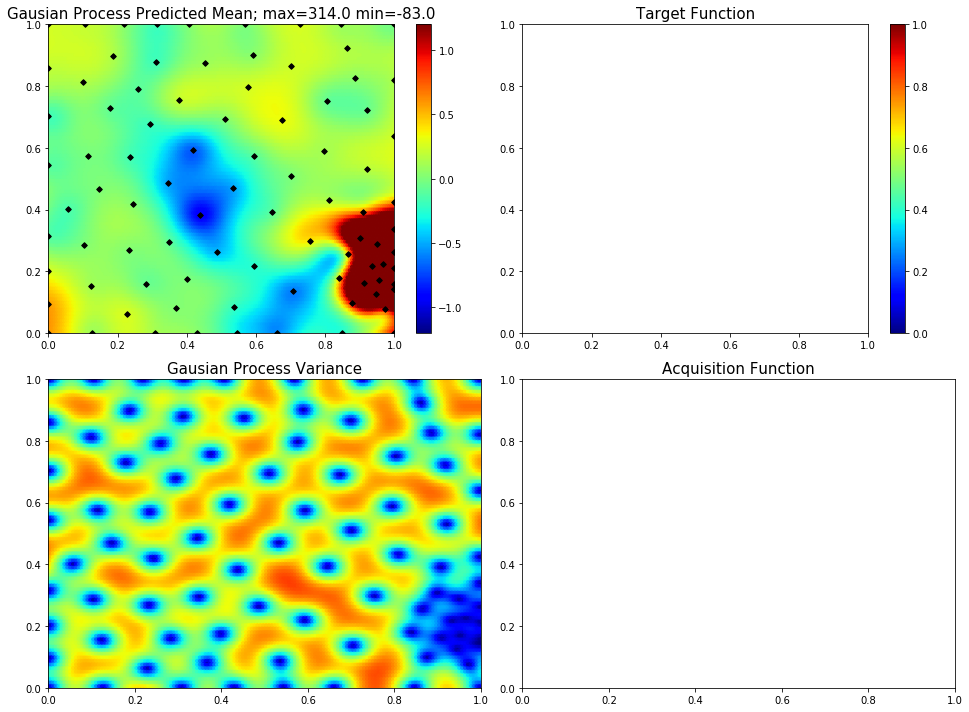

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.344038328583789, 0.8400657080432832]
16  Evaluations Remaining
|  90       |  0.3638   |  0.344    |  0.8401   |
myplot:  090


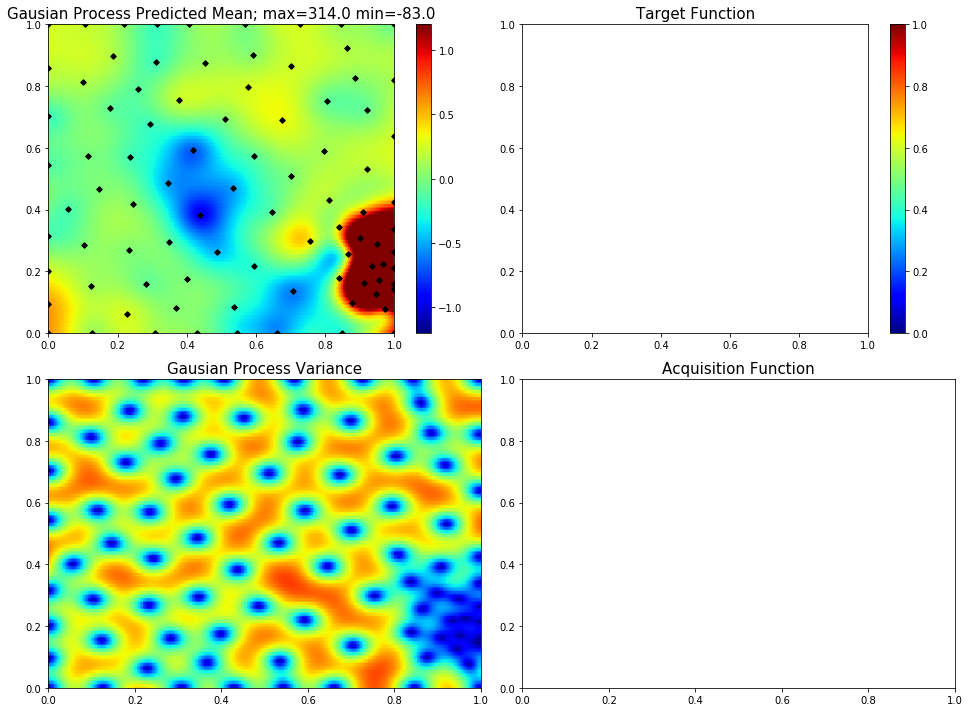

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3420040278232851, 0.947994240281264]
15  Evaluations Remaining
|  91       |  2.222    |  0.342    |  0.948    |
myplot:  091


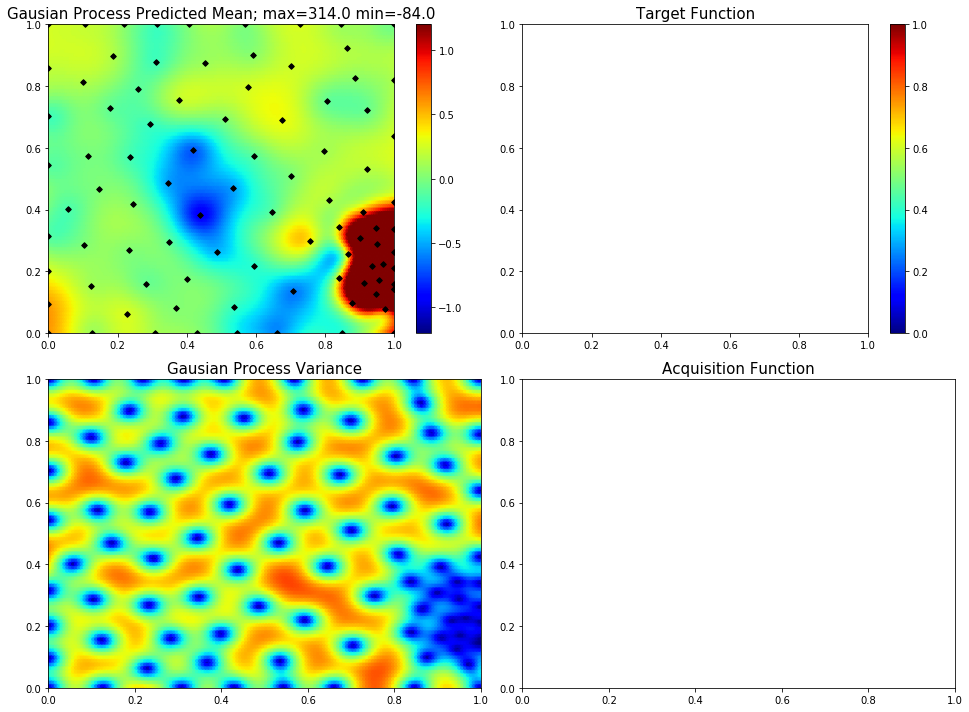

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2903458102358837, 0.6634184057390569]
14  Evaluations Remaining
|  92       | -0.4692   |  0.2903   |  0.6634   |
myplot:  092


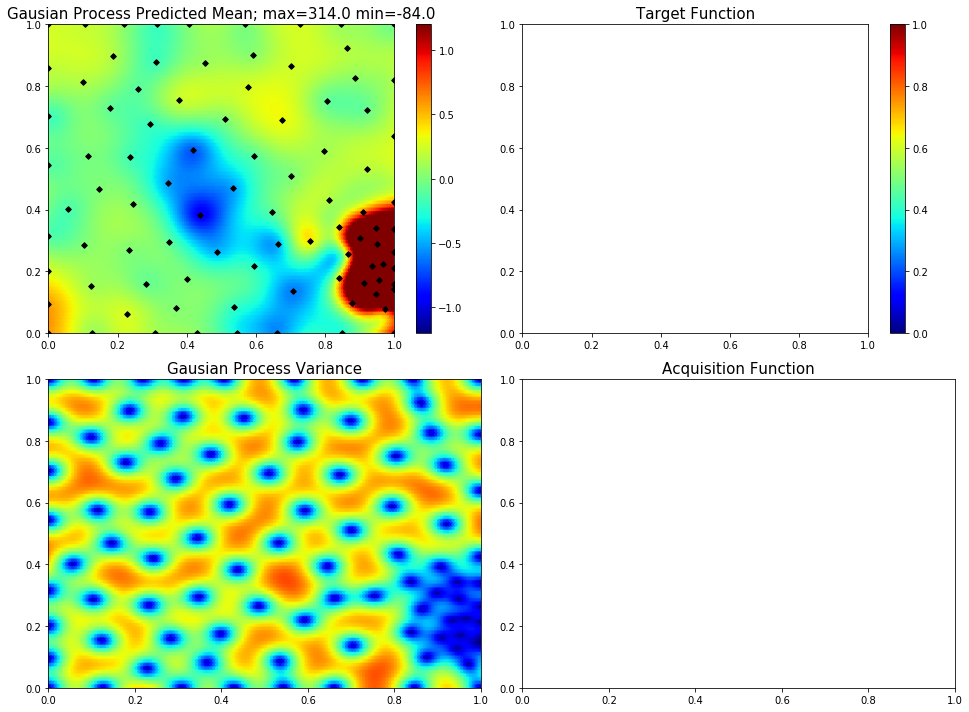

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5371917282496402, 1.0]
13  Evaluations Remaining
|  93       |  0.2676   |  0.5372   |  1.0      |
myplot:  093


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([-3.33637021e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 53, 'nit': 4, 'warnflag': 2}
  ConvergenceWarning)


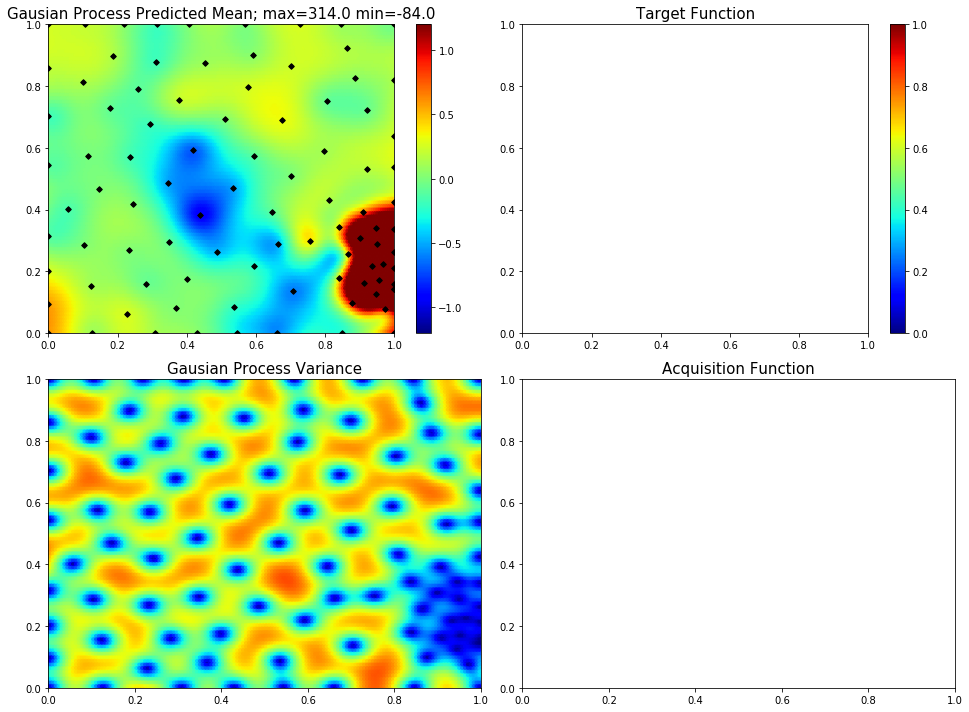

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1363579340412236, 0.9210773878982911]
12  Evaluations Remaining
|  94       |  3.208    |  0.1364   |  0.9211   |
myplot:  094


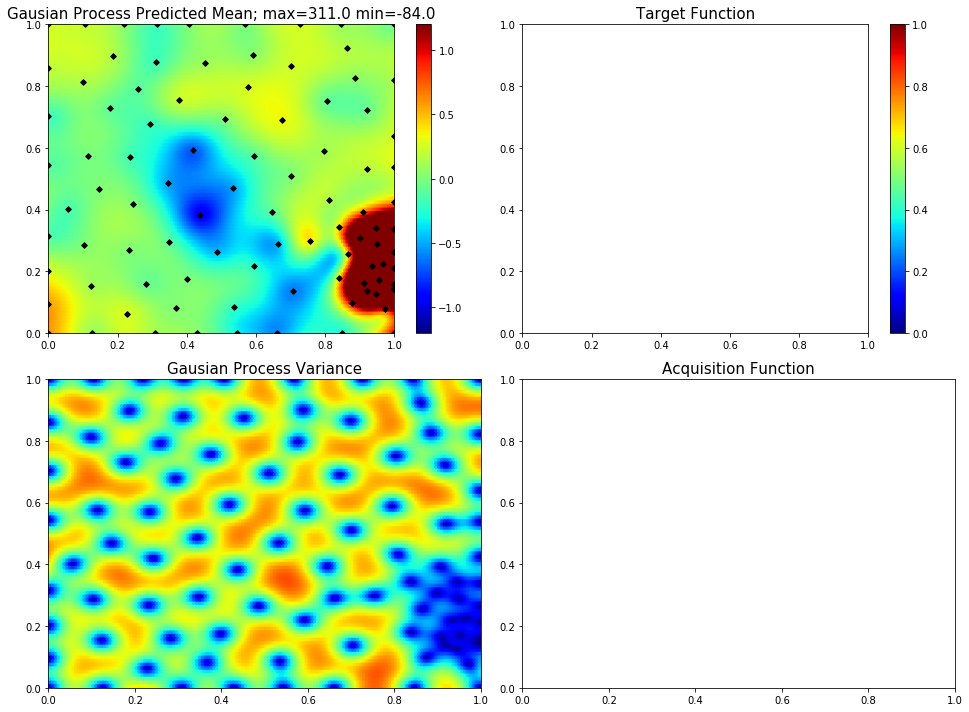

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.203221150825098, 0.9537804857527667]
11  Evaluations Remaining
|  95       |  3.232    |  0.2032   |  0.9538   |
myplot:  095


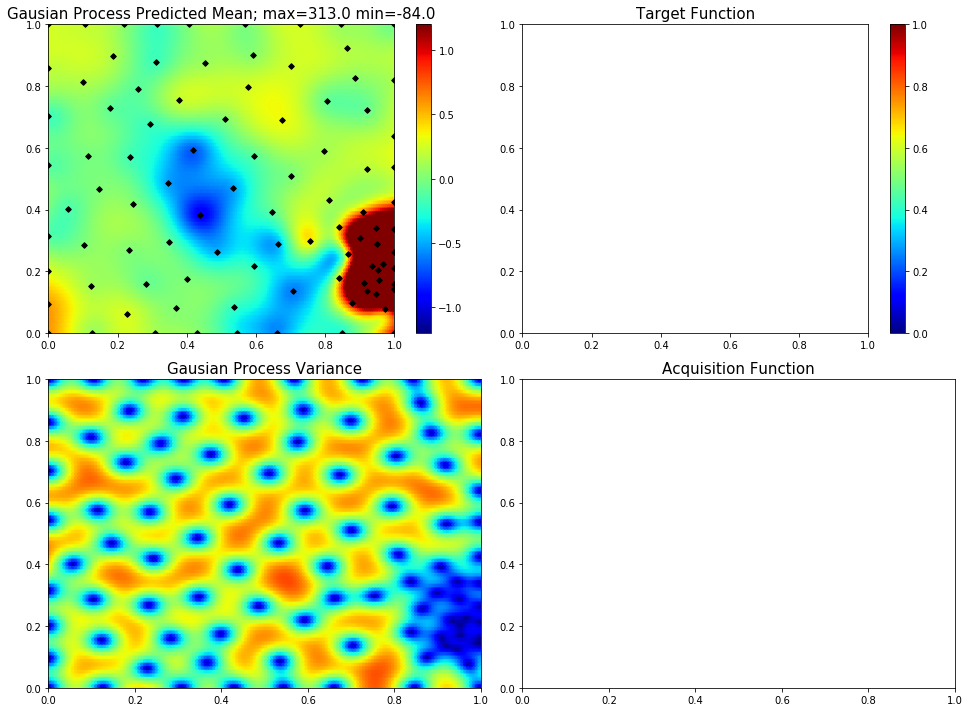

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.15289540802801632, 0.9355870162809506]
10  Evaluations Remaining
|  96       |  3.254    |  0.1529   |  0.9356   |
myplot:  096


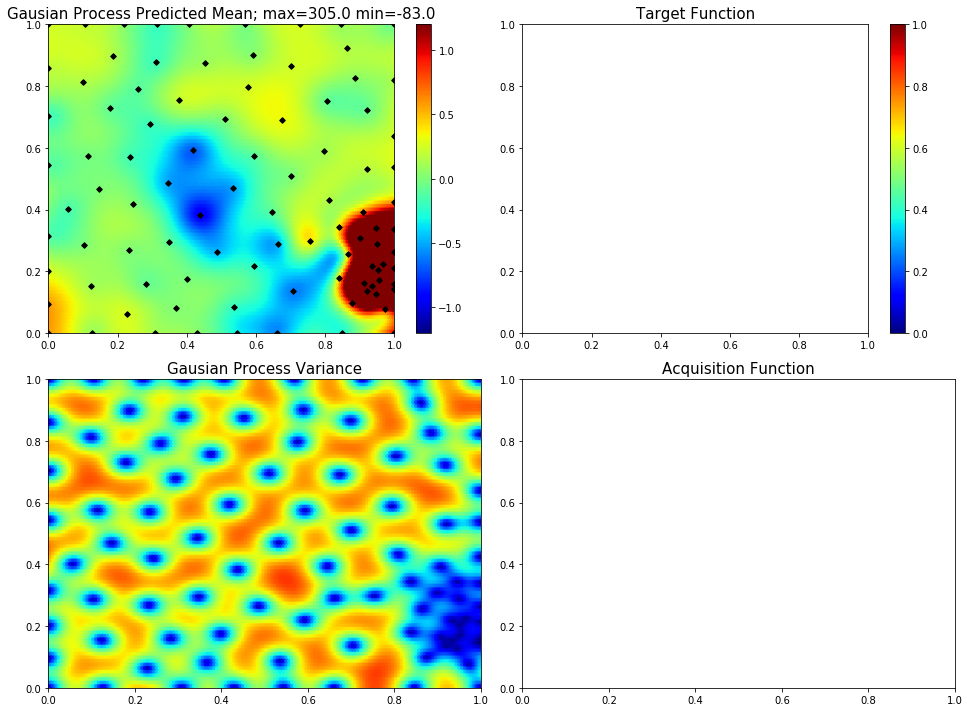

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.18958388432693174, 0.9222607075913779]
9  Evaluations Remaining
|  97       |  3.216    |  0.1896   |  0.9223   |
myplot:  097


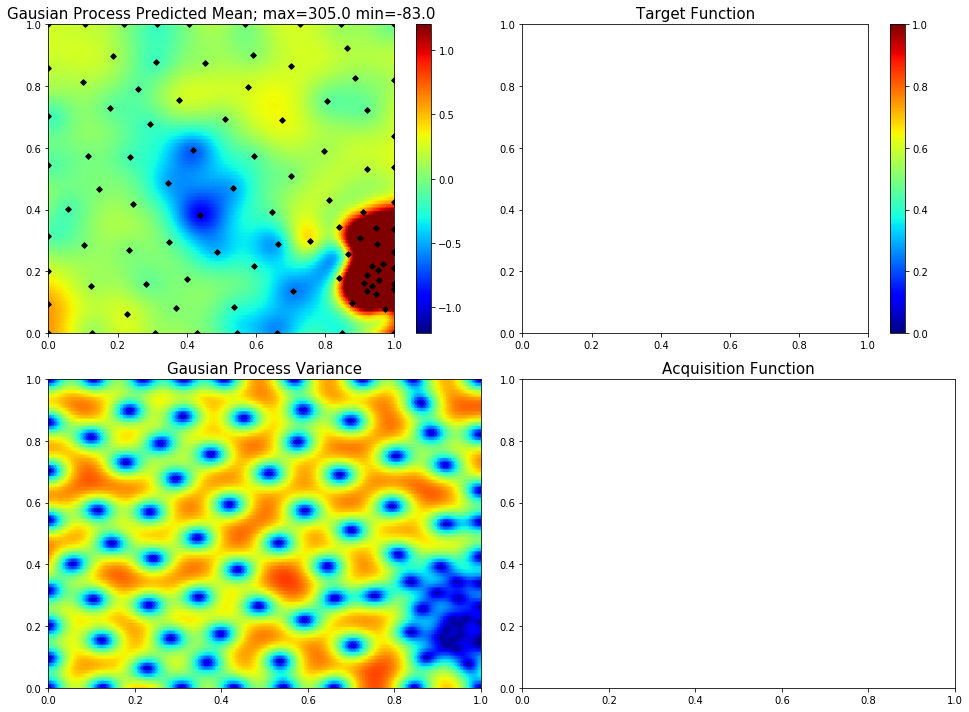

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2406330117434666, 0.9487789656919458]
8  Evaluations Remaining
|  98       |  3.387    |  0.2406   |  0.9488   |
myplot:  098


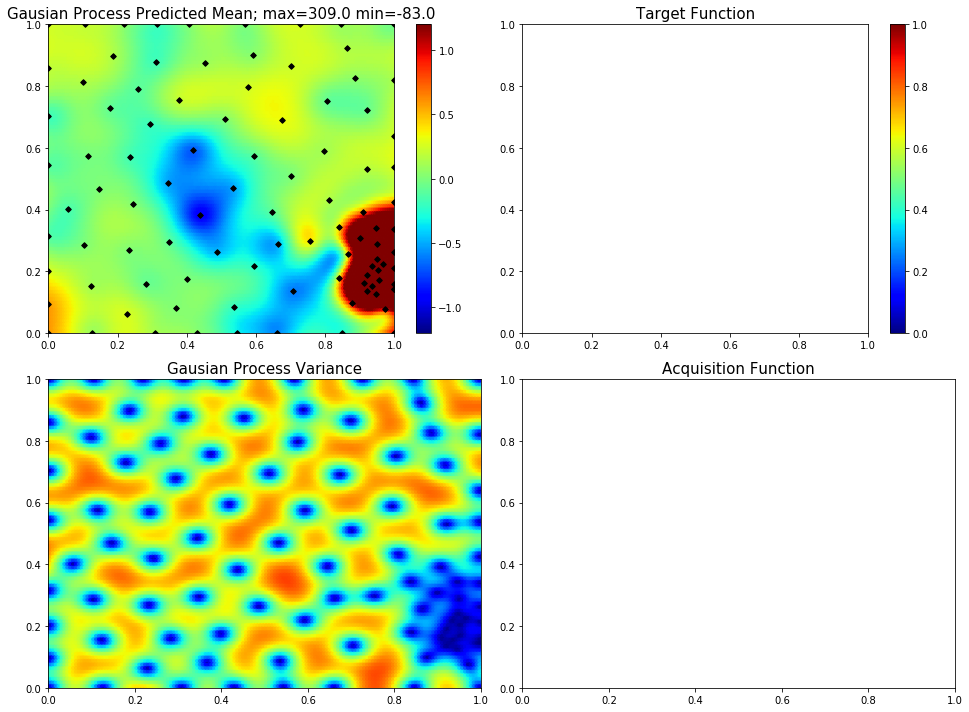

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1972263090311821, 0.9846526825013538]
7  Evaluations Remaining
|  99       |  3.117    |  0.1972   |  0.9847   |
myplot:  099


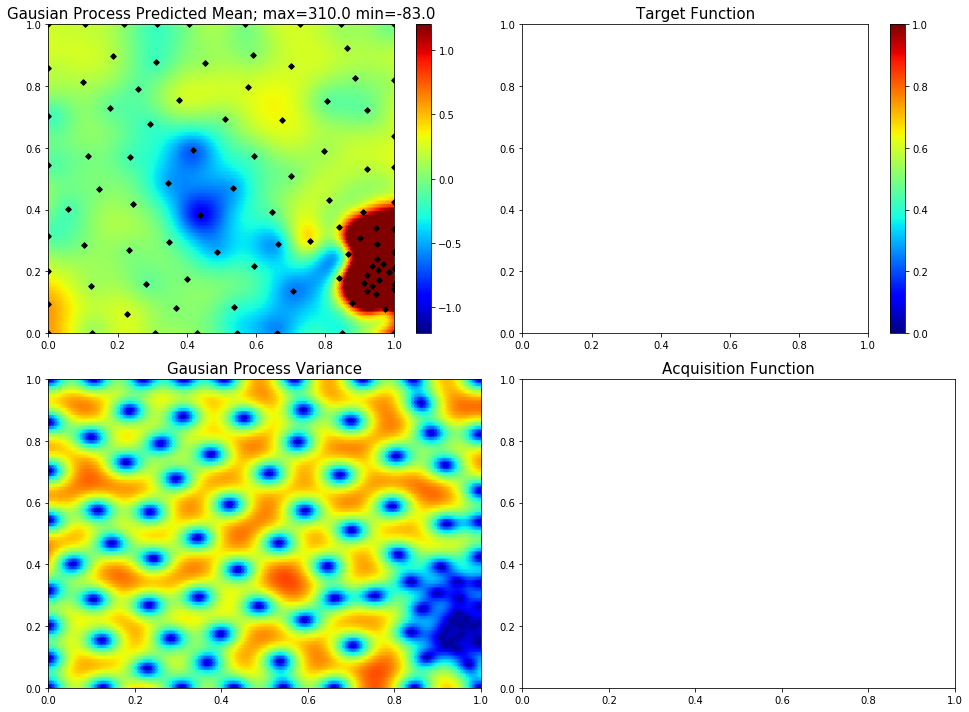

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22985564444290862, 0.9520825057619621]
6  Evaluations Remaining
|  100      |  3.255    |  0.2299   |  0.9521   |
myplot:  100


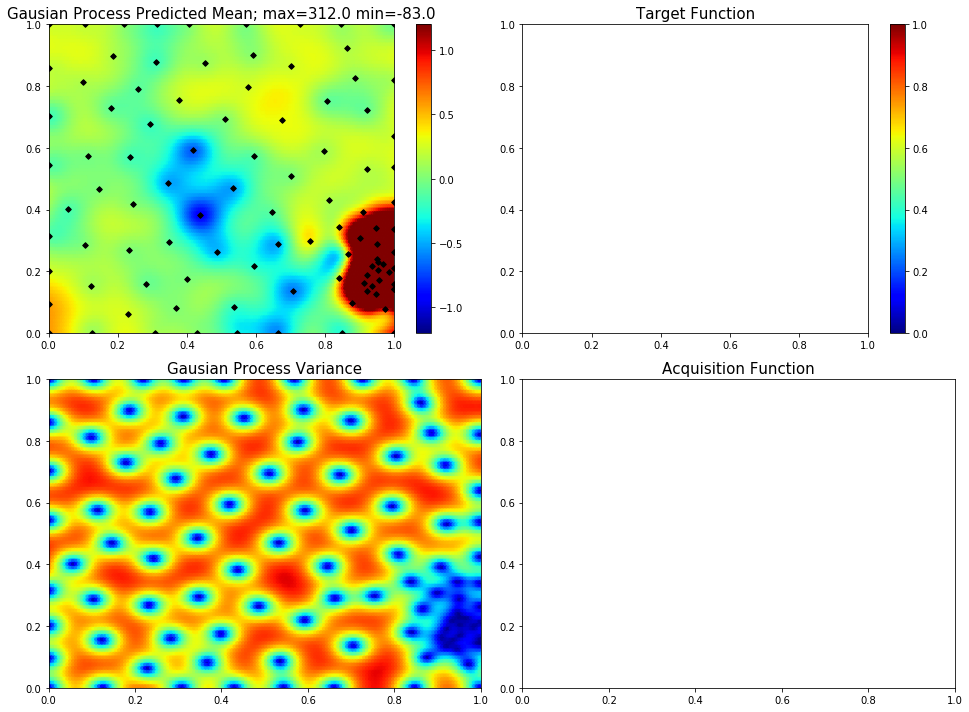

In [55]:
# Turn interactive plotting off
plt.ioff()
#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))
    
    
    #invRL_score = invRL(policy)
    #if (i % 20 == 1 ): 
        #test_score = testHolePolicy(policy)
        #print("diff = ", invRL_score*90.0 - test_score)
    if (i==53):
        used_kappa = 8
    if (i==75):
        used_kappa = 7
    if (i==80):
        used_kappa = 5
    if (i==88):
        used_kappa = 3
        

In [56]:
def myRandom():
    return rand.random() # return round(rand.random(), 2)# TODO: remove this round thig # TODO run it more 

def GetRandPolicy():
    policy=[]
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()]) 
    return policy


evolution = []
policies = []
maxReward= 0.0
nbTestedPolicy = 0


In [57]:
for _ in range(100000):
    if (nbTestedPolicy % 1000 == 0 ):
        print('nbTestedPolicy',nbTestedPolicy)
    nbTestedPolicy += 1
    
    policy = {}
    policy['nwemer'] = GetRandPolicy()
    with suppress_stdout():
        potentialReward,potentialReward_sum  = invRL(policy['nwemer'])
    if potentialReward_sum<maxReward*0.9: continue
    print(policy)
        

    policy['AvgReward'] = np.mean(potentialReward)
    policy['maxRewards'] = np.max(potentialReward)
    policy['totRewards'] = np.sum(potentialReward)
    policy['Rewards'] = potentialReward
    policies.append(policy)



    policies.sort(key=lambda r: -r['totRewards'])
    evolution.append(policies[0]['AvgReward'])
    maxReward=policies[0]['totRewards']
    print("##################################################################")
    clear_output()
    
    print('totRewards',round(policies[0]['totRewards']))
    print('rewards',policies[0]['AvgReward'])
    print('maxRewards',round(policies[0]['maxRewards']))
    print('nbTestedPolicy',nbTestedPolicy)
    
    
    if len(policies)>10: 
        policies = policies[0:9]
    print(policies)
    print("##################################################################")
    print(evolution)

totRewards 824.0
rewards 164.75530075289765
maxRewards 295.0
nbTestedPolicy 80410
[{'nwemer': [[0.13146229013140942, 0.9285520016665579], [0.23910692802349756, 2.5328162486991048e-05], [0.16830982094548724, 0.8881333332050443], [0.6997768726394247, 0.030790344199295026], [0.17084025004773193, 0.9266858761384551]], 'AvgReward': 164.75530075289765, 'maxRewards': 294.9219044070329, 'totRewards': 823.7765037644882, 'Rewards': [array([291.42788171]), array([14.83070328]), array([231.26509648]), array([-8.66908211]), array([294.92190441])]}, {'nwemer': [[0.34153739200401423, 0.9432285901539621], [0.14436913805003682, 0.05155116453528754], [0.18440265586516208, 0.9062662772777761], [0.12908723958473772, 0.02529830415703545], [0.2209391363226096, 0.9124232701755027]], 'AvgReward': 161.9763366264645, 'maxRewards': 270.2018117028374, 'totRewards': 809.8816831323225, 'Rewards': [array([198.72633159]), array([30.92359795]), array([270.2018117]), array([40.90049084]), array([269.12945105])]}, {'nwe

In [58]:
print('totRewards',policies[0]['totRewards'])
print('rewards',policies[0]['AvgReward'])
print('maxRewards',policies[0]['maxRewards'])
print('nbTestedPolicy',nbTestedPolicy)
policies[0]

totRewards 823.7765037644882
rewards 164.75530075289765
maxRewards 294.9219044070329
nbTestedPolicy 100000


{'nwemer': [[0.13146229013140942, 0.9285520016665579],
  [0.23910692802349756, 2.5328162486991048e-05],
  [0.16830982094548724, 0.8881333332050443],
  [0.6997768726394247, 0.030790344199295026],
  [0.17084025004773193, 0.9266858761384551]],
 'AvgReward': 164.75530075289765,
 'maxRewards': 294.9219044070329,
 'totRewards': 823.7765037644882,
 'Rewards': [array([291.42788171]),
  array([14.83070328]),
  array([231.26509648]),
  array([-8.66908211]),
  array([294.92190441])]}

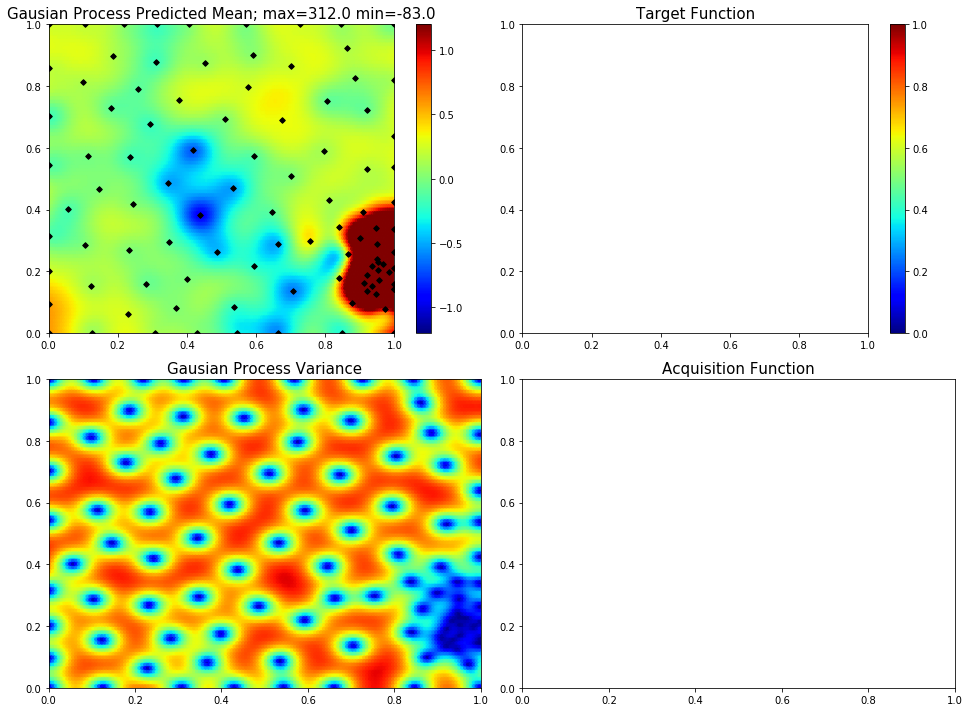

In [59]:
plot_2d()

In [60]:

util = UtilityFunction( kind='ucb', kappa=10, xi=0.0)
print( bo.suggest(util) )

util = UtilityFunction( kind='ucb', kappa=5, xi=0.0)
print( bo.suggest(util) )


util = UtilityFunction( kind='ucb', kappa=1, xi=0.0)
print( bo.suggest(util) )


util = UtilityFunction( kind='ucb', kappa=0, xi=0.0)
print( bo.suggest(util) )

{'x': 0.629166554943451, 'y': 0.886058266588152}
{'x': 0.6276081806046202, 'y': 0.886880818159597}
{'x': 0.22882277270940554, 'y': 0.9812421835950542}
{'x': 0.2273500898803581, 'y': 0.9769888427692213}


In [62]:
envSeqDec = newHoleEnv()

#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]
policy = [[0.31328663818396973, 0.9776861325195532],
  [0.07206449061138168, 0.011854559756869415],
  [0.015001307755673127, 0.7824223824506427],
  [0.3448629245009954, 0.07300768816008919],
  [0.04056924624498471, 0.27620473268585843]]
policy= [[0.017363777900124777, 0.8479028716329575], [0.7961740200410486, 0.0384155626867467], [0.0007479541597428817, 0.784541637169782], [0.6168483799846353, 0.12921609525220837], [0.07021082750169359, 0.8135289568164947]]
policy=[[0.0014498060608478802, 0.7901454626026162], [0.6791898353834519, 0.0912706440317113], [0.02393225621723486, 0.772009761068695], [0.897451024460483, 0.019135270067331032], [0.07942440232028156, 0.8954976621776467]]
policy=[[0.06532976733282991, 0.8687345318407067], [0.4865239879760457, 0.11761979547307863], [0.02449963006843666, 0.7640924632117153], [0.9418943242247545, 0.0012583247711476753], [0.05601557278101282, 0.7674708685872119]]
policy=policies[0]['nwemer']
invRL_score,_ = invRL(policy)
test_score,_ = testHolePolicy(policy)
#print("diff = ", invRL_score*90.0 - test_score)

print("expected = ", np.sum(invRL_score)," found= ", np.sum(test_score)  )
#invRL_score - test_score
print("diff = ", [ abs(x - y) for x,y in zip(invRL_score,test_score) ]  )
print("diff = ", np.sum([ abs(x - y) for x,y in zip(invRL_score,test_score) ]  ) ) 

#prove env expected =  947.0742091770907  found=  312.0137212047402
#expected =  465.8542637680314  found=  288.91556359852547
#expected =  837.4259592721351  found=  281.63029040374727
#expected =  613.2272896911845  found=  307.1155017999602

invRL y 1 :  291.0  +-  2
invRL y 2 :  23.0  +-  3
invRL y 3 :  210.0  +-  5
invRL y 4 :  4.0  +-  8
invRL y 5 :  85.0  +-  7
105  Evaluations Remaining
test y 1 :  292
104  Evaluations Remaining
test y 2 :  -261
103  Evaluations Remaining
test y 3 :  259
102  Evaluations Remaining
test y 4 :  -246
101  Evaluations Remaining
test y 5 :  263
expected =  613.2272896911845  found=  307.1155017999602
diff =  [array([0.08811426]), array([283.7291174]), array([49.51723097]), array([249.95116608]), array([177.96315037])]
diff =  761.2487790782136
